<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_7_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [4]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [5]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [6]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [11]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [14]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [15]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [16]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [17]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [18]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 32.9825 - IoU: 0.0559
Epoch 1: val_IoU improved from -inf to 0.00146, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 43ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


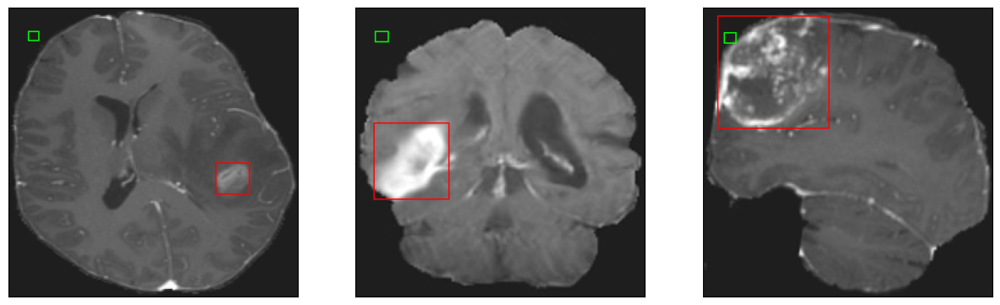

26/26 [==============================] - 22s 219ms/step - loss: 32.5276 - IoU: 0.0585 - val_loss: 64.3960 - val_IoU: 0.0015
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 22.5724 - IoU: 0.1071
Epoch 2: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


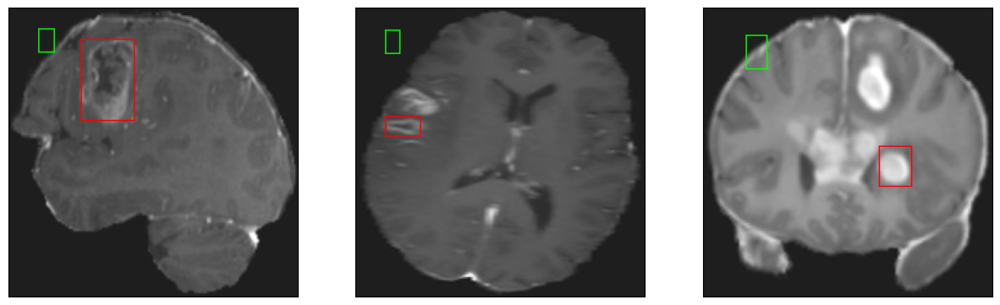

26/26 [==============================] - 2s 86ms/step - loss: 22.5724 - IoU: 0.1071 - val_loss: 55.7363 - val_IoU: 9.9636e-05
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 19.0623 - IoU: 0.1673
Epoch 3: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


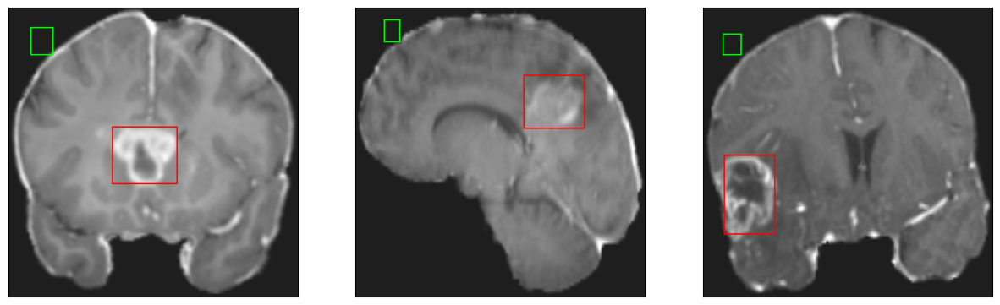

26/26 [==============================] - 2s 87ms/step - loss: 19.0182 - IoU: 0.1676 - val_loss: 61.3587 - val_IoU: 0.0000e+00
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 15.5416 - IoU: 0.2520
Epoch 4: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


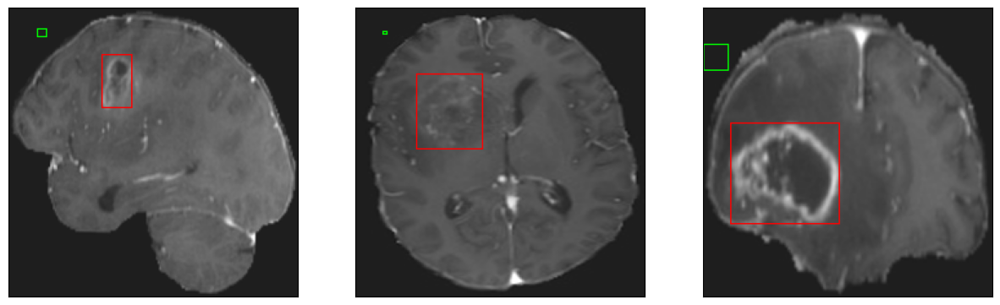

26/26 [==============================] - 2s 90ms/step - loss: 15.5373 - IoU: 0.2519 - val_loss: 58.2031 - val_IoU: 2.6967e-04
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 13.6841 - IoU: 0.2957
Epoch 5: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


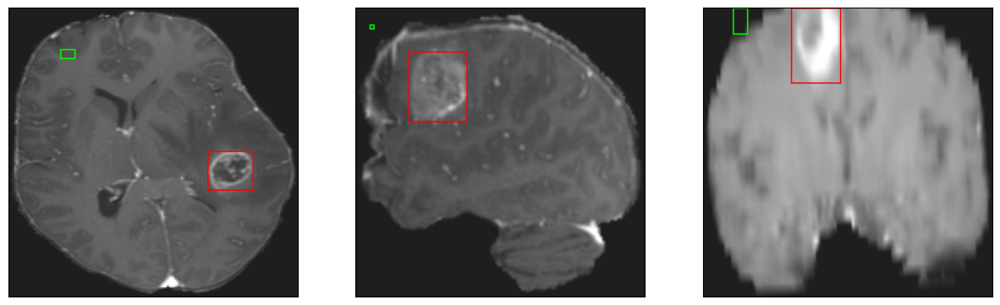

26/26 [==============================] - 3s 106ms/step - loss: 13.6841 - IoU: 0.2957 - val_loss: 56.2618 - val_IoU: 2.6015e-04
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 13.6762 - IoU: 0.2946
Epoch 6: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


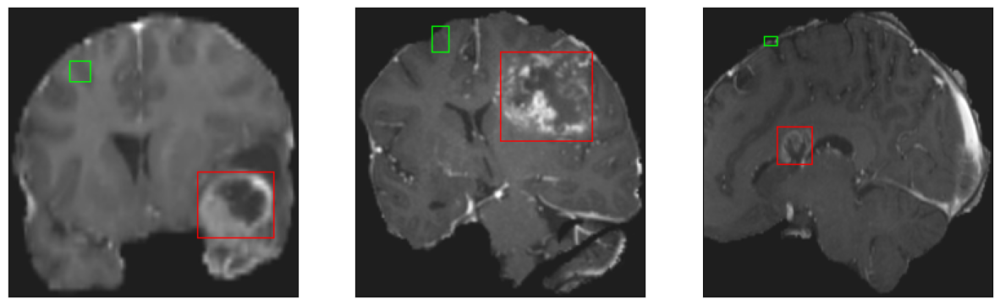

26/26 [==============================] - 3s 96ms/step - loss: 13.6762 - IoU: 0.2946 - val_loss: 50.2048 - val_IoU: 0.0013
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 11.8786 - IoU: 0.3475
Epoch 7: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


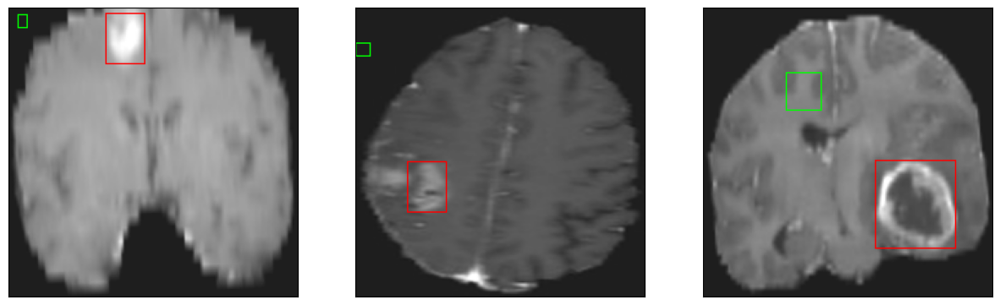

26/26 [==============================] - 2s 86ms/step - loss: 11.8786 - IoU: 0.3475 - val_loss: 56.6319 - val_IoU: 2.0422e-04
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 10.8949 - IoU: 0.3694
Epoch 8: val_IoU did not improve from 0.00146
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


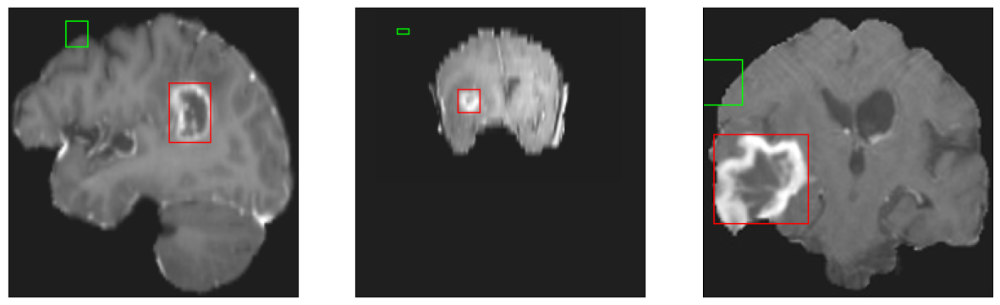

26/26 [==============================] - 2s 89ms/step - loss: 10.9136 - IoU: 0.3698 - val_loss: 48.5063 - val_IoU: 0.0012
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 10.9494 - IoU: 0.3758
Epoch 9: val_IoU improved from 0.00146 to 0.00214, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


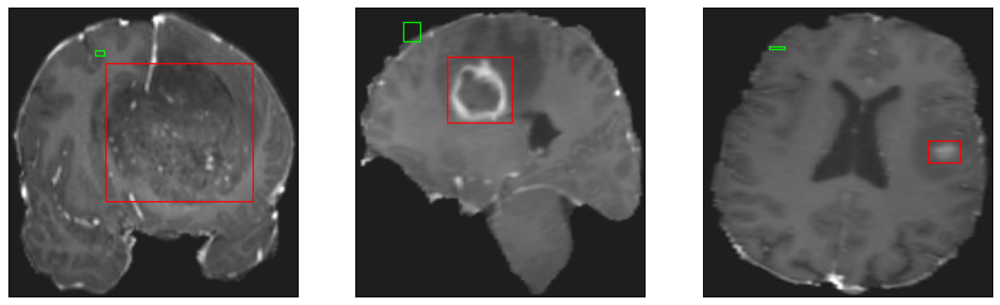

26/26 [==============================] - 3s 127ms/step - loss: 10.8428 - IoU: 0.3790 - val_loss: 44.8772 - val_IoU: 0.0021
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 10.1641 - IoU: 0.4015
Epoch 10: val_IoU did not improve from 0.00214
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


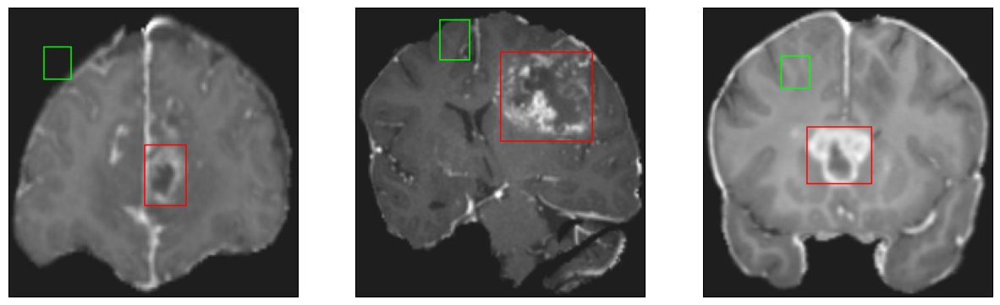

26/26 [==============================] - 3s 105ms/step - loss: 10.1033 - IoU: 0.4019 - val_loss: 47.6655 - val_IoU: 8.1321e-04
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 9.9639 - IoU: 0.3978 
Epoch 11: val_IoU did not improve from 0.00214
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


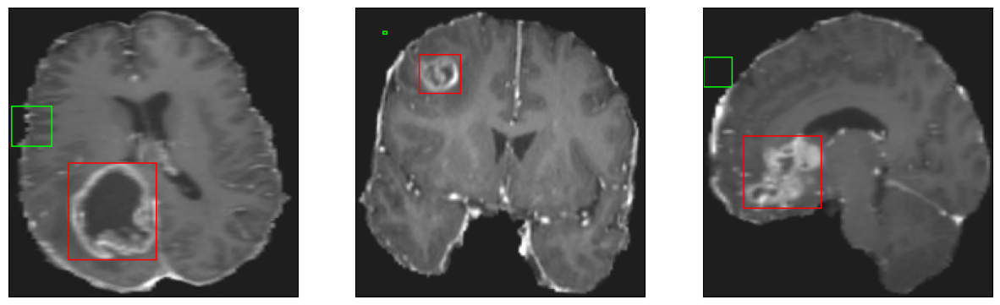

26/26 [==============================] - 2s 96ms/step - loss: 9.9639 - IoU: 0.3978 - val_loss: 49.5470 - val_IoU: 0.0011
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 9.3831 - IoU: 0.4205
Epoch 12: val_IoU improved from 0.00214 to 0.01235, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


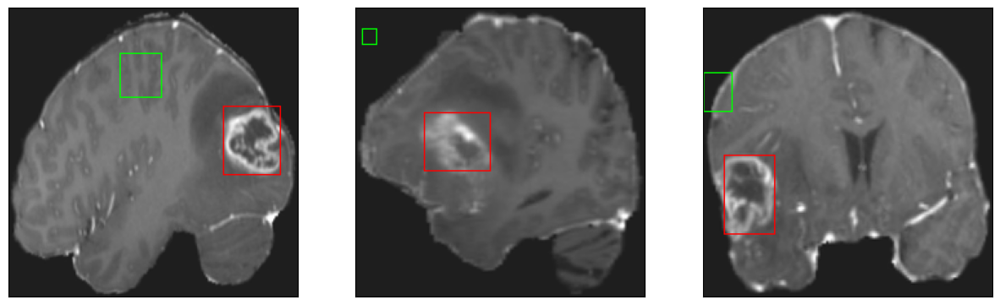

26/26 [==============================] - 3s 102ms/step - loss: 9.3868 - IoU: 0.4180 - val_loss: 41.0123 - val_IoU: 0.0123
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 8.9569 - IoU: 0.4449
Epoch 13: val_IoU did not improve from 0.01235
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


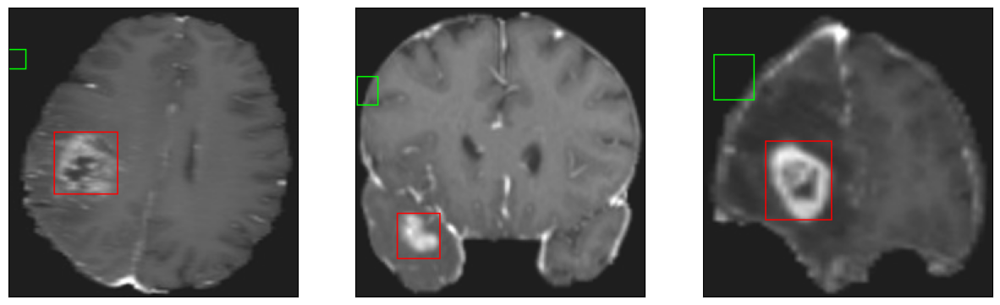

26/26 [==============================] - 3s 109ms/step - loss: 8.9569 - IoU: 0.4449 - val_loss: 44.4035 - val_IoU: 0.0057
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 8.8087 - IoU: 0.4509
Epoch 14: val_IoU did not improve from 0.01235
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


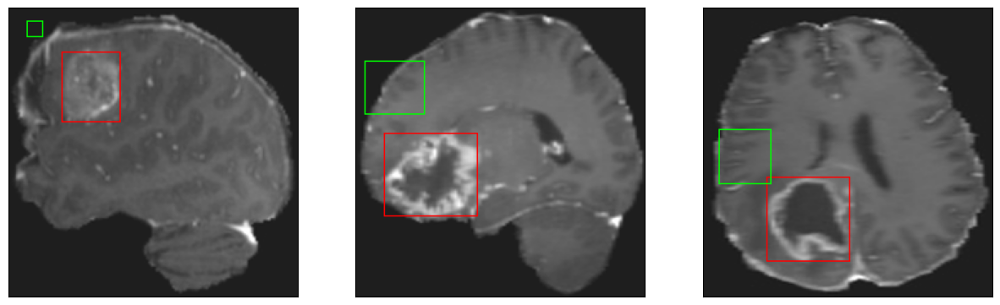

26/26 [==============================] - 2s 94ms/step - loss: 8.8087 - IoU: 0.4509 - val_loss: 40.7228 - val_IoU: 0.0085
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 8.7083 - IoU: 0.4381
Epoch 15: val_IoU did not improve from 0.01235
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


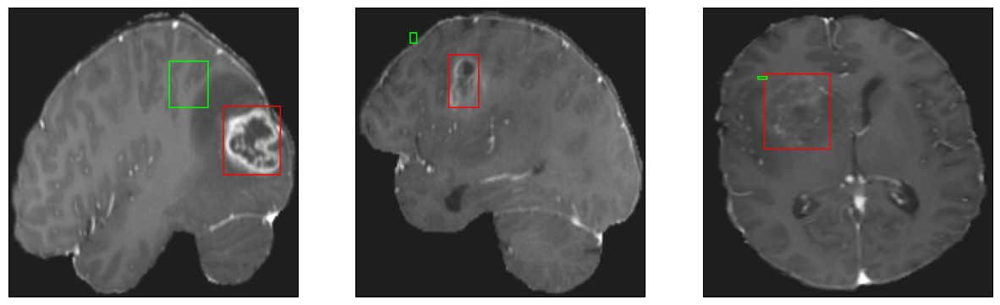

26/26 [==============================] - 3s 100ms/step - loss: 8.6820 - IoU: 0.4397 - val_loss: 38.6479 - val_IoU: 0.0092
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9560 - IoU: 0.4750
Epoch 16: val_IoU improved from 0.01235 to 0.01719, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


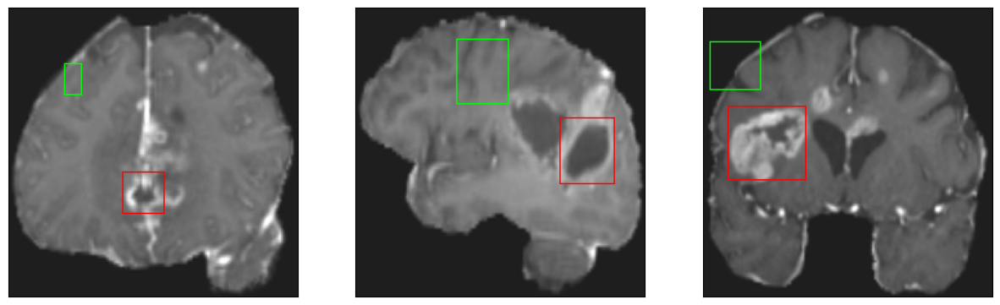

26/26 [==============================] - 3s 119ms/step - loss: 7.9155 - IoU: 0.4788 - val_loss: 38.6668 - val_IoU: 0.0172
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 8.3803 - IoU: 0.4578
Epoch 17: val_IoU did not improve from 0.01719
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


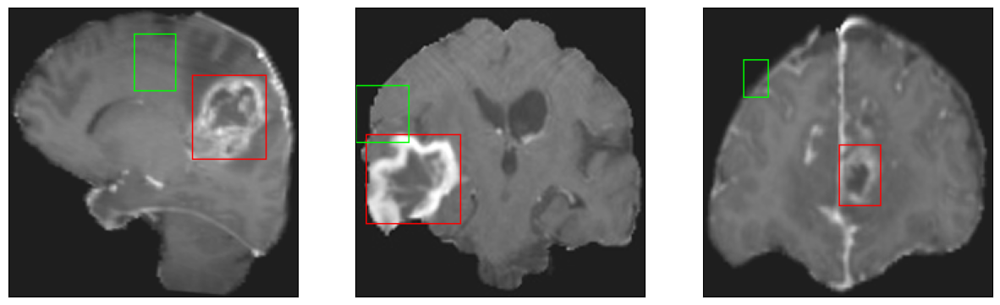

26/26 [==============================] - 3s 117ms/step - loss: 8.4339 - IoU: 0.4565 - val_loss: 39.8148 - val_IoU: 0.0107
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 8.1092 - IoU: 0.4742
Epoch 18: val_IoU improved from 0.01719 to 0.04217, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


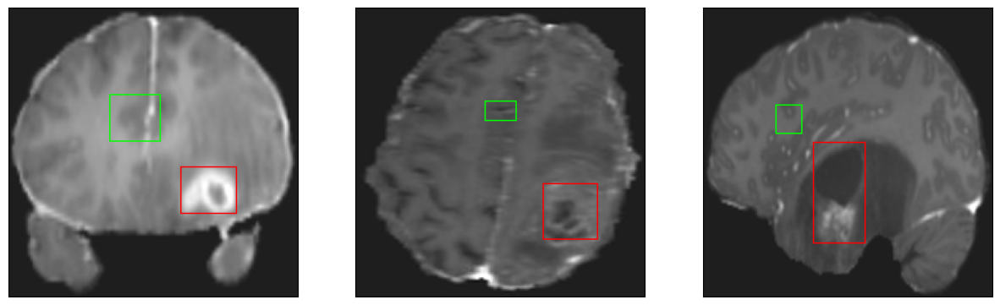

26/26 [==============================] - 3s 128ms/step - loss: 8.1092 - IoU: 0.4742 - val_loss: 30.9281 - val_IoU: 0.0422
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 7.7409 - IoU: 0.4841
Epoch 19: val_IoU improved from 0.04217 to 0.04258, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


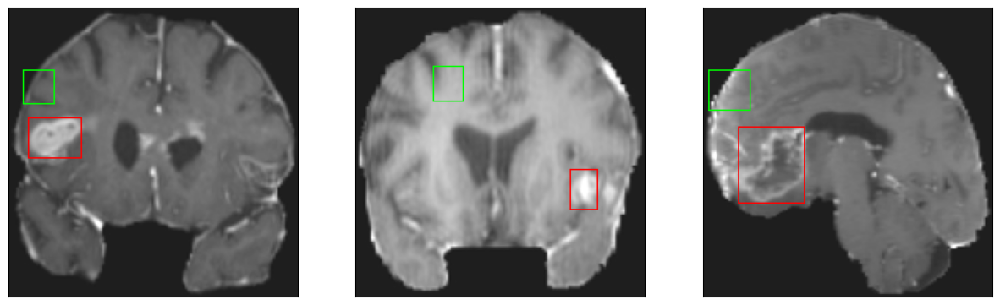

26/26 [==============================] - 3s 109ms/step - loss: 7.7409 - IoU: 0.4841 - val_loss: 29.3962 - val_IoU: 0.0426
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9654 - IoU: 0.4751
Epoch 20: val_IoU improved from 0.04258 to 0.04442, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


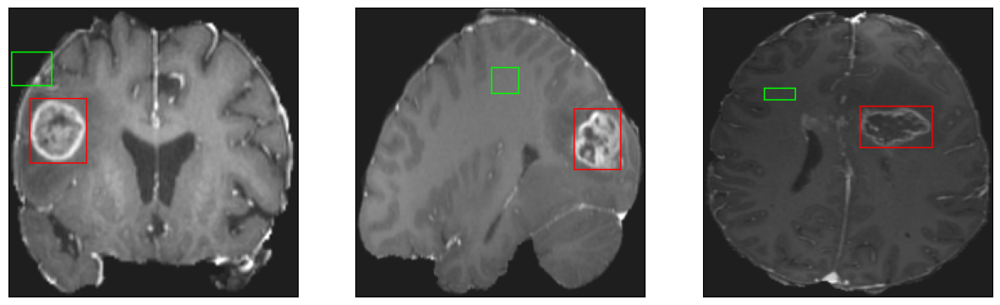

26/26 [==============================] - 3s 119ms/step - loss: 7.9731 - IoU: 0.4745 - val_loss: 30.8559 - val_IoU: 0.0444
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6144 - IoU: 0.4837
Epoch 21: val_IoU improved from 0.04442 to 0.06447, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


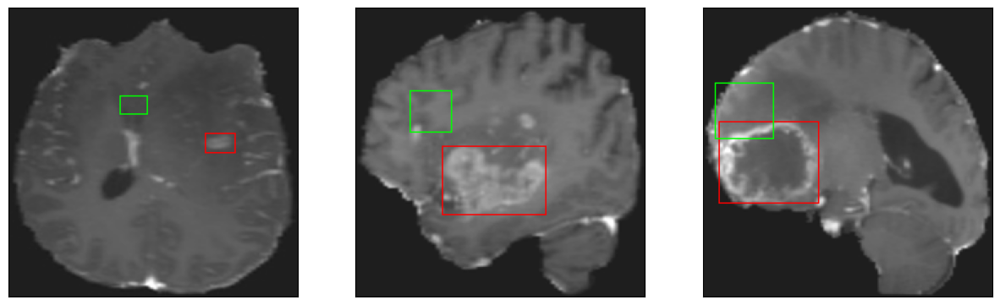

26/26 [==============================] - 3s 127ms/step - loss: 7.6145 - IoU: 0.4830 - val_loss: 25.9748 - val_IoU: 0.0645
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.4850 - IoU: 0.4952
Epoch 22: val_IoU improved from 0.06447 to 0.07577, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


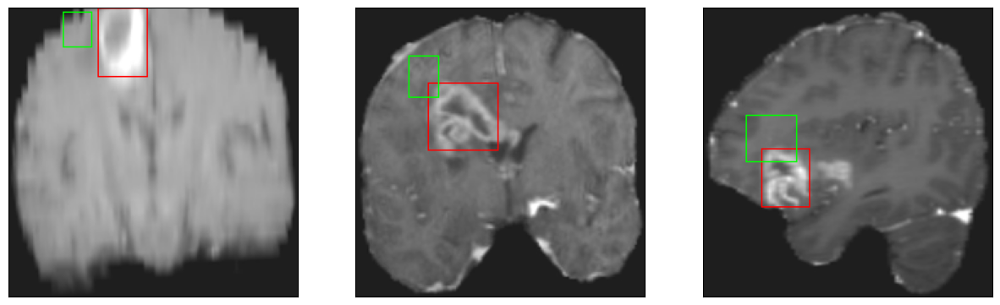

26/26 [==============================] - 3s 128ms/step - loss: 7.4850 - IoU: 0.4952 - val_loss: 24.7484 - val_IoU: 0.0758
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1346 - IoU: 0.5084
Epoch 23: val_IoU improved from 0.07577 to 0.14871, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


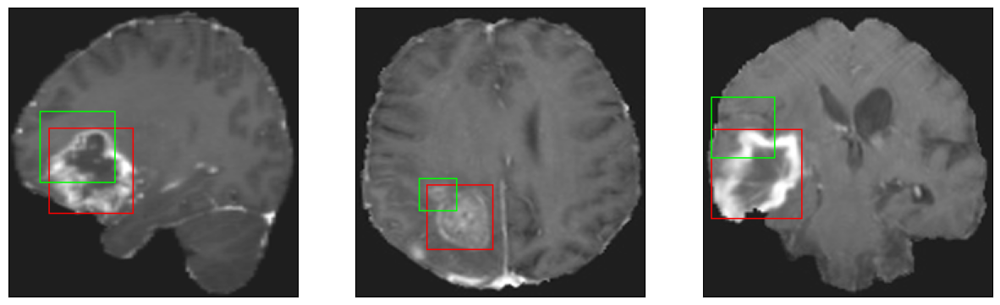

26/26 [==============================] - 3s 109ms/step - loss: 7.1484 - IoU: 0.5096 - val_loss: 18.7810 - val_IoU: 0.1487
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7185 - IoU: 0.5253
Epoch 24: val_IoU did not improve from 0.14871
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


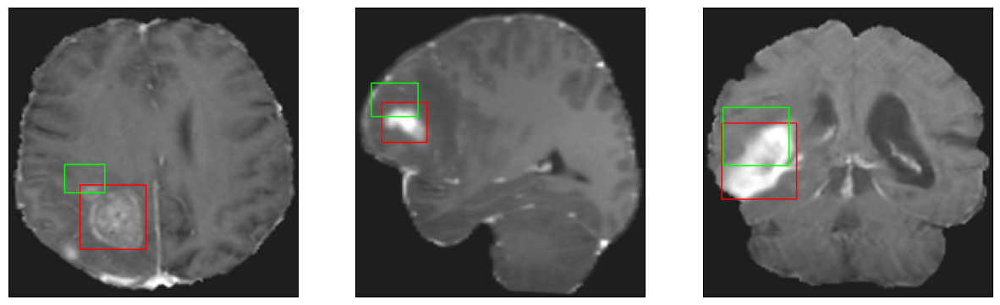

26/26 [==============================] - 3s 110ms/step - loss: 6.7554 - IoU: 0.5234 - val_loss: 20.5055 - val_IoU: 0.1267
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1222 - IoU: 0.5121
Epoch 25: val_IoU improved from 0.14871 to 0.43359, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


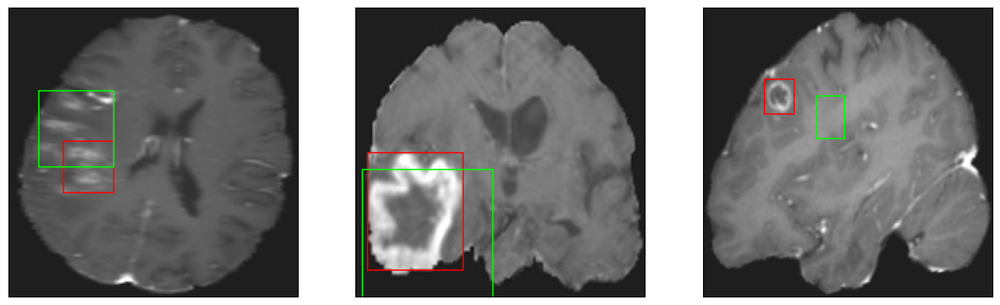

26/26 [==============================] - 4s 142ms/step - loss: 7.2305 - IoU: 0.5080 - val_loss: 12.0778 - val_IoU: 0.4336
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 7.3715 - IoU: 0.5011
Epoch 26: val_IoU did not improve from 0.43359
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


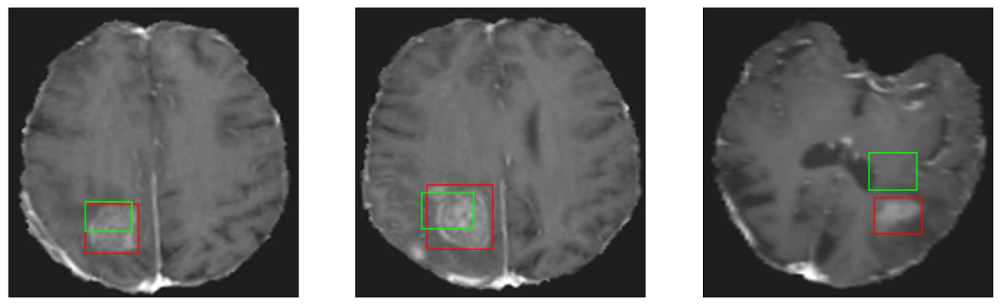

26/26 [==============================] - 3s 99ms/step - loss: 7.3715 - IoU: 0.5011 - val_loss: 12.4944 - val_IoU: 0.3351
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7998 - IoU: 0.5258
Epoch 27: val_IoU did not improve from 0.43359
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


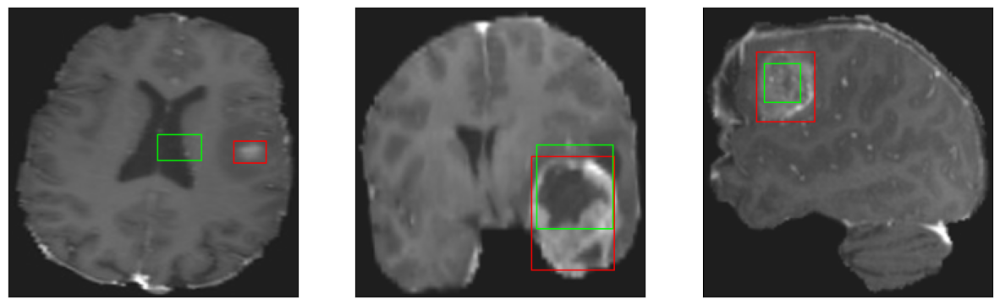

26/26 [==============================] - 3s 110ms/step - loss: 6.8408 - IoU: 0.5238 - val_loss: 12.9700 - val_IoU: 0.3618
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.7190 - IoU: 0.5223
Epoch 28: val_IoU improved from 0.43359 to 0.48971, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


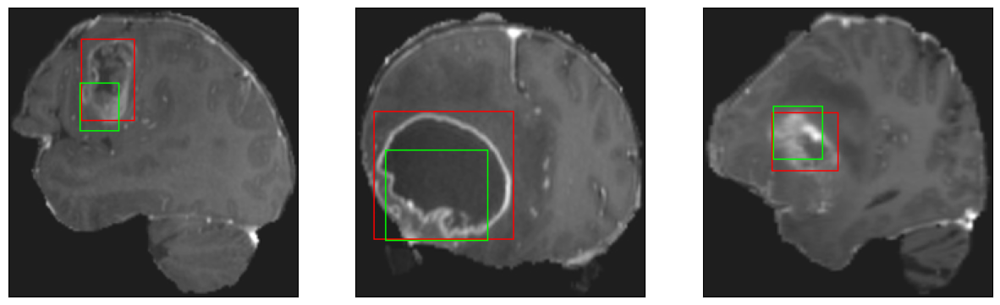

26/26 [==============================] - 4s 142ms/step - loss: 6.7190 - IoU: 0.5223 - val_loss: 9.6847 - val_IoU: 0.4897
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7316 - IoU: 0.5316
Epoch 29: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


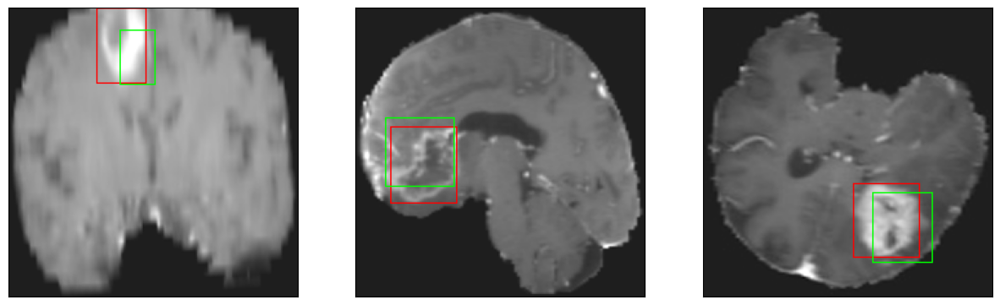

26/26 [==============================] - 3s 103ms/step - loss: 6.8167 - IoU: 0.5280 - val_loss: 10.6613 - val_IoU: 0.4235
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4878 - IoU: 0.5350
Epoch 30: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


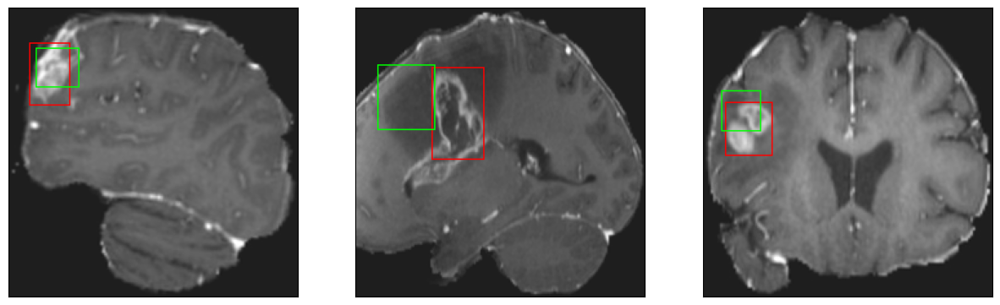

26/26 [==============================] - 3s 104ms/step - loss: 6.4862 - IoU: 0.5345 - val_loss: 14.9248 - val_IoU: 0.2603
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5834 - IoU: 0.5313
Epoch 31: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


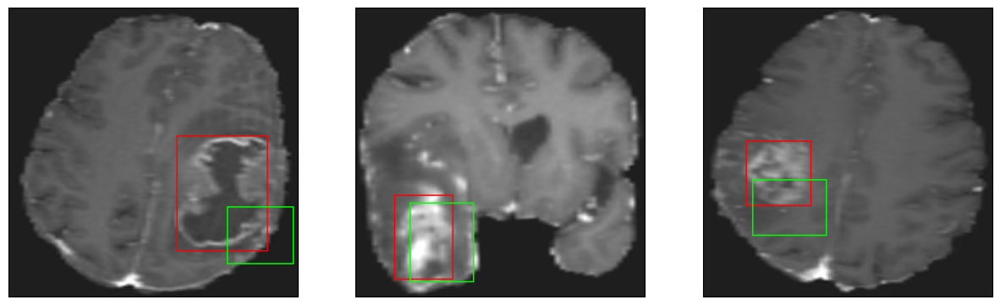

26/26 [==============================] - 3s 131ms/step - loss: 6.5680 - IoU: 0.5317 - val_loss: 17.8899 - val_IoU: 0.1660
Epoch 32/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4685 - IoU: 0.5355
Epoch 32: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


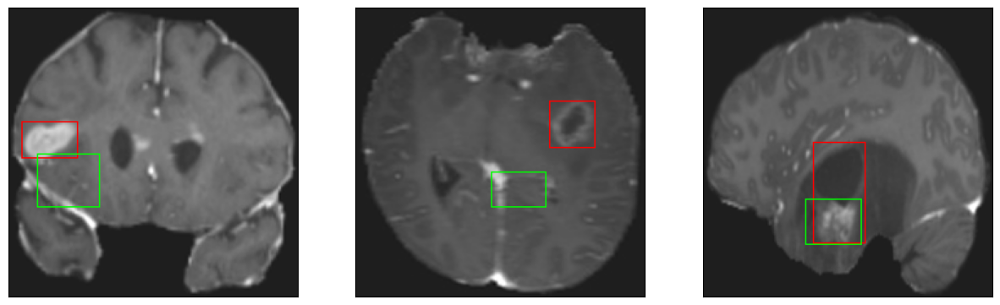

26/26 [==============================] - 3s 108ms/step - loss: 6.5300 - IoU: 0.5325 - val_loss: 12.6927 - val_IoU: 0.3063
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.4768 - IoU: 0.5301
Epoch 33: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


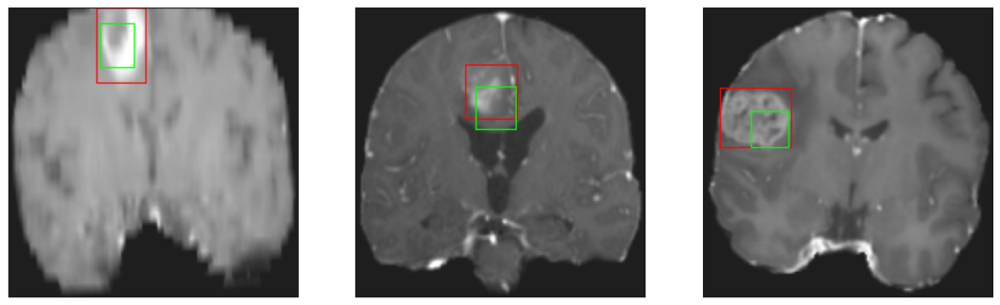

26/26 [==============================] - 3s 106ms/step - loss: 6.4768 - IoU: 0.5301 - val_loss: 9.6558 - val_IoU: 0.4892
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.4386 - IoU: 0.5350
Epoch 34: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


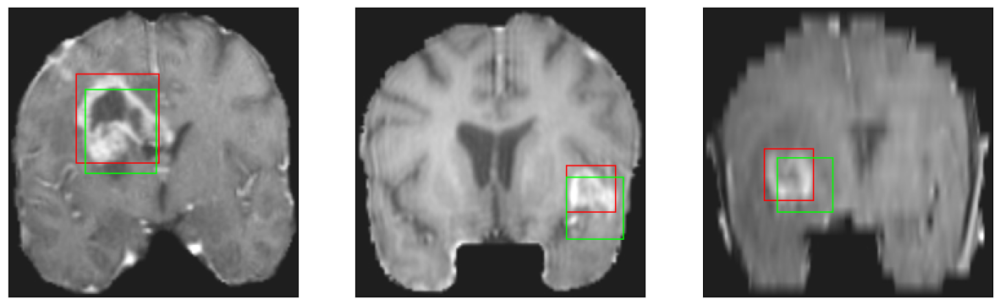

26/26 [==============================] - 3s 118ms/step - loss: 6.4386 - IoU: 0.5350 - val_loss: 11.3413 - val_IoU: 0.3822
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1870 - IoU: 0.5499
Epoch 35: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 13ms/step
4


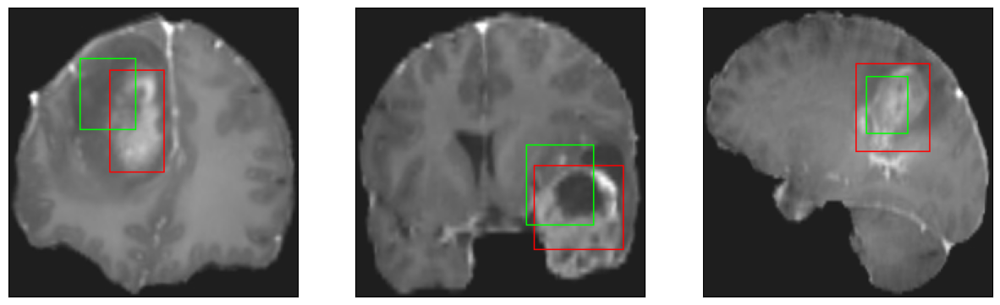

26/26 [==============================] - 3s 127ms/step - loss: 6.1931 - IoU: 0.5493 - val_loss: 10.8880 - val_IoU: 0.4315
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.1359 - IoU: 0.5515
Epoch 36: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


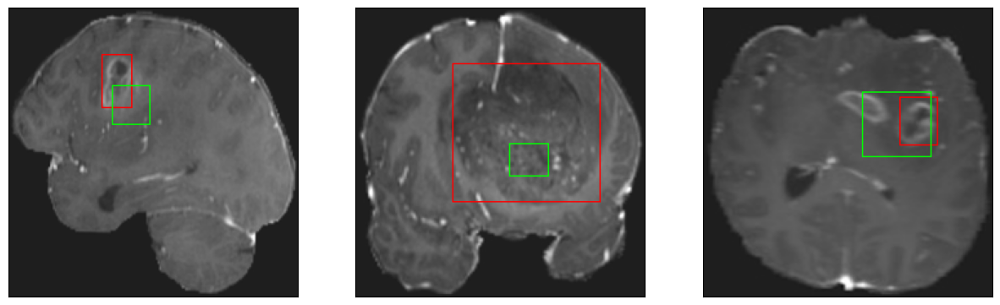

26/26 [==============================] - 3s 125ms/step - loss: 6.1359 - IoU: 0.5515 - val_loss: 10.2873 - val_IoU: 0.4512
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0923 - IoU: 0.5553
Epoch 37: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


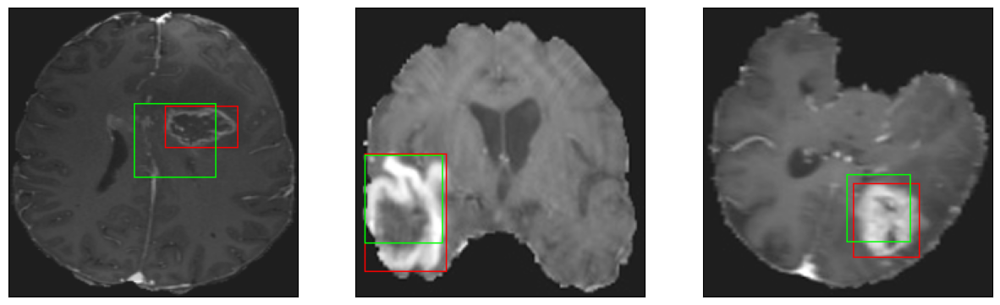

26/26 [==============================] - 3s 111ms/step - loss: 6.0973 - IoU: 0.5543 - val_loss: 10.5636 - val_IoU: 0.4500
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 6.1437 - IoU: 0.5495
Epoch 38: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


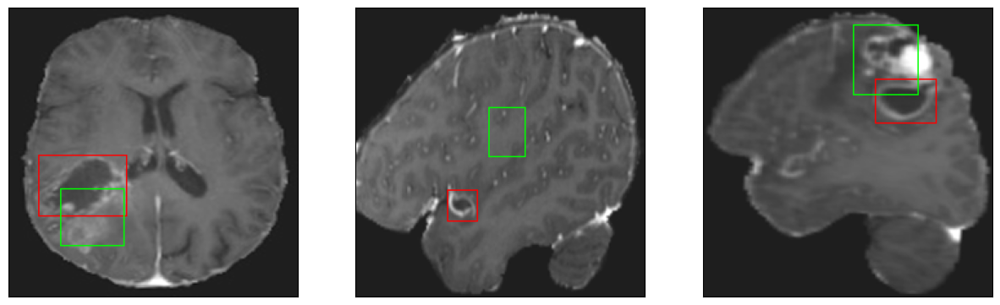

26/26 [==============================] - 3s 133ms/step - loss: 6.1437 - IoU: 0.5495 - val_loss: 10.5742 - val_IoU: 0.4624
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4290 - IoU: 0.5506
Epoch 39: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


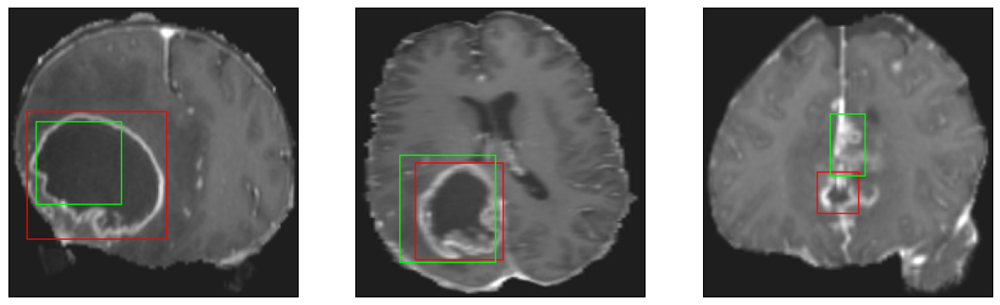

26/26 [==============================] - 3s 111ms/step - loss: 6.4168 - IoU: 0.5499 - val_loss: 12.4486 - val_IoU: 0.3499
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.3562 - IoU: 0.5399
Epoch 40: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


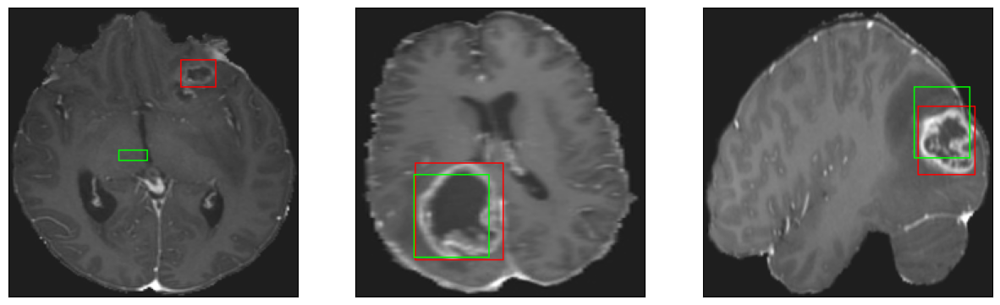

26/26 [==============================] - 3s 127ms/step - loss: 6.3562 - IoU: 0.5399 - val_loss: 11.3505 - val_IoU: 0.4041
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 6.1382 - IoU: 0.5537
Epoch 41: val_IoU did not improve from 0.48971
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


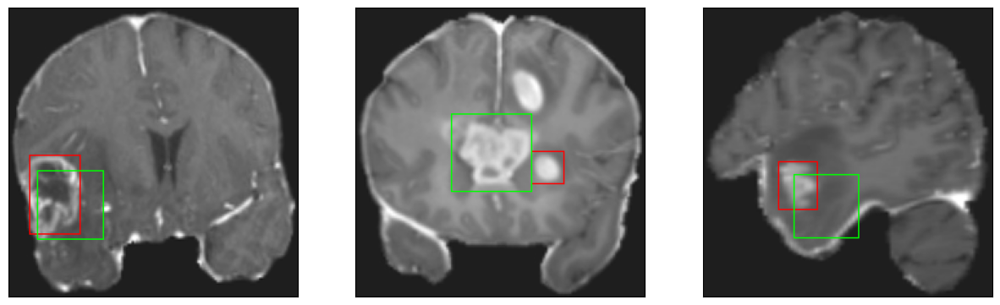

26/26 [==============================] - 3s 112ms/step - loss: 6.1382 - IoU: 0.5537 - val_loss: 12.3724 - val_IoU: 0.3561
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.8489 - IoU: 0.5604
Epoch 42: val_IoU improved from 0.48971 to 0.48999, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


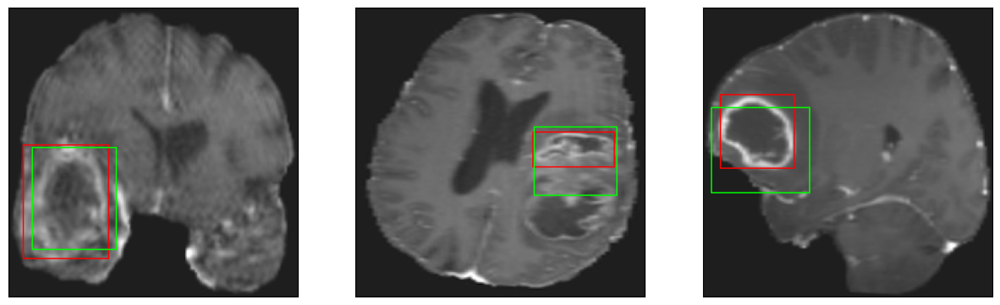

26/26 [==============================] - 4s 140ms/step - loss: 5.8489 - IoU: 0.5604 - val_loss: 9.6380 - val_IoU: 0.4900
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7739 - IoU: 0.5780
Epoch 43: val_IoU improved from 0.48999 to 0.49867, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


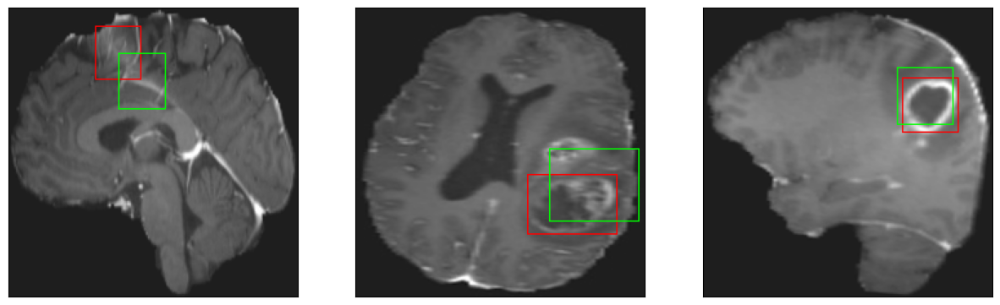

26/26 [==============================] - 3s 121ms/step - loss: 5.8716 - IoU: 0.5731 - val_loss: 9.3793 - val_IoU: 0.4987
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8368 - IoU: 0.5681
Epoch 44: val_IoU improved from 0.49867 to 0.49937, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


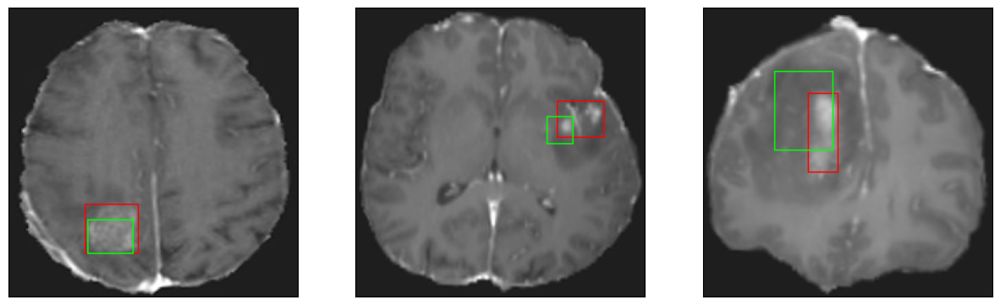

26/26 [==============================] - 3s 130ms/step - loss: 5.8374 - IoU: 0.5662 - val_loss: 9.9253 - val_IoU: 0.4994
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7832 - IoU: 0.5743
Epoch 45: val_IoU did not improve from 0.49937
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


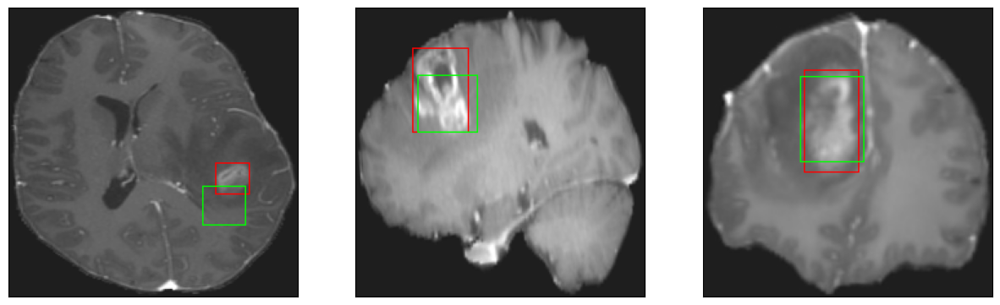

26/26 [==============================] - 3s 102ms/step - loss: 5.7639 - IoU: 0.5755 - val_loss: 10.7126 - val_IoU: 0.4255
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9973 - IoU: 0.5579
Epoch 46: val_IoU did not improve from 0.49937
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


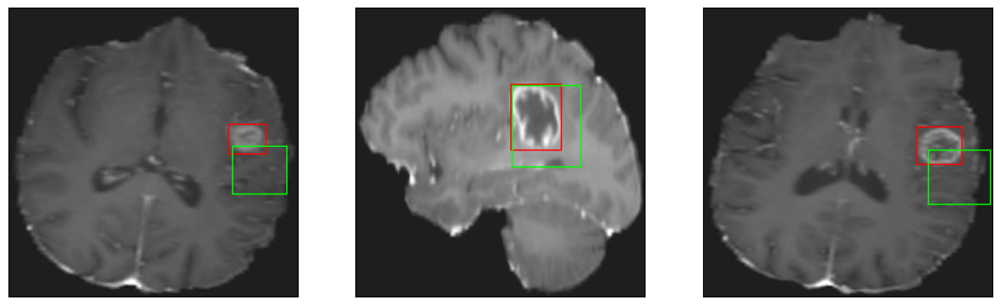

26/26 [==============================] - 3s 101ms/step - loss: 5.9660 - IoU: 0.5609 - val_loss: 10.5554 - val_IoU: 0.4345
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7471 - IoU: 0.5816
Epoch 47: val_IoU did not improve from 0.49937
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


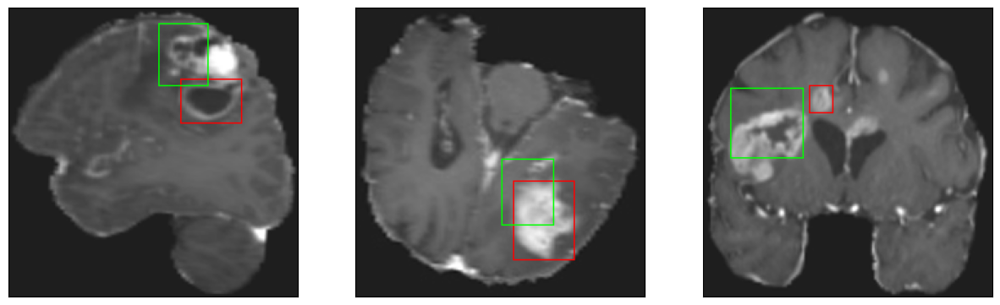

26/26 [==============================] - 3s 103ms/step - loss: 5.7151 - IoU: 0.5816 - val_loss: 10.5302 - val_IoU: 0.4462
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.8955 - IoU: 0.5589
Epoch 48: val_IoU did not improve from 0.49937
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


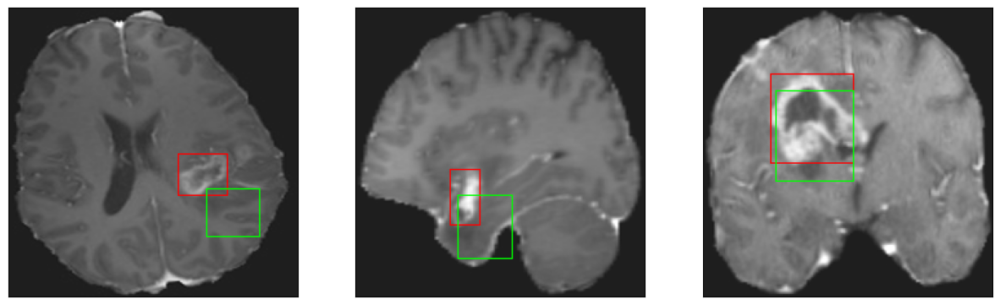

26/26 [==============================] - 3s 121ms/step - loss: 5.8955 - IoU: 0.5589 - val_loss: 14.7815 - val_IoU: 0.2692
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1205 - IoU: 0.5499
Epoch 49: val_IoU improved from 0.49937 to 0.50047, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


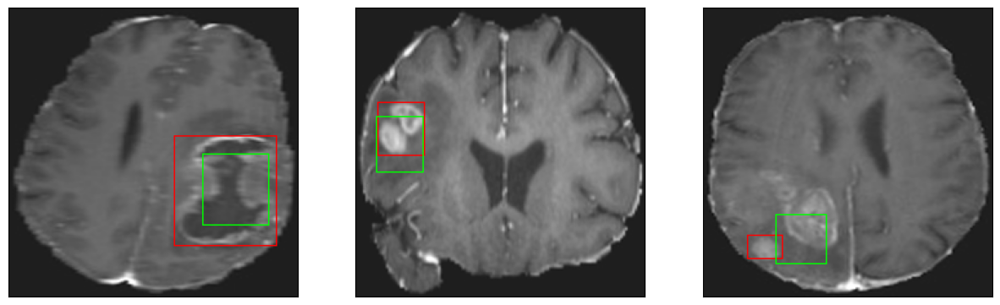

26/26 [==============================] - 3s 128ms/step - loss: 6.1311 - IoU: 0.5471 - val_loss: 9.8973 - val_IoU: 0.5005
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8716 - IoU: 0.5573
Epoch 50: val_IoU improved from 0.50047 to 0.51898, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


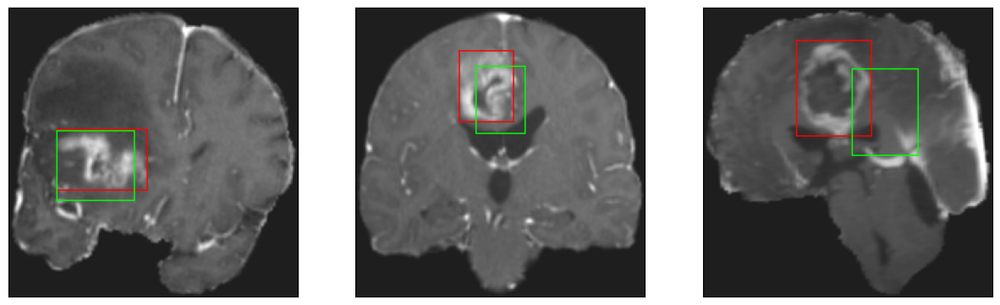

26/26 [==============================] - 3s 114ms/step - loss: 5.8259 - IoU: 0.5602 - val_loss: 9.1344 - val_IoU: 0.5190
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6859 - IoU: 0.5765
Epoch 51: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


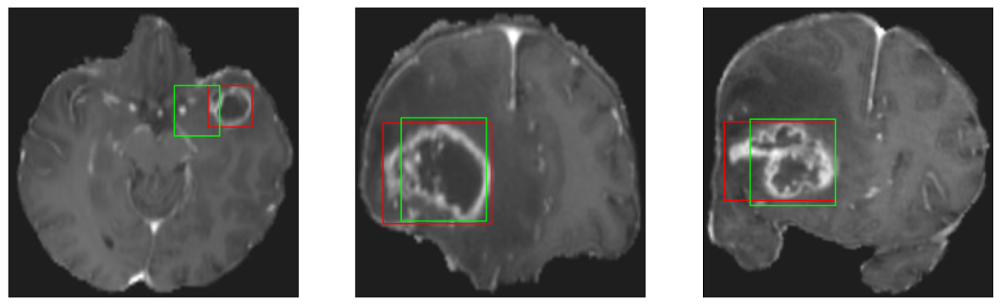

26/26 [==============================] - 3s 109ms/step - loss: 5.6610 - IoU: 0.5776 - val_loss: 9.4599 - val_IoU: 0.4799
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5762 - IoU: 0.5805
Epoch 52: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


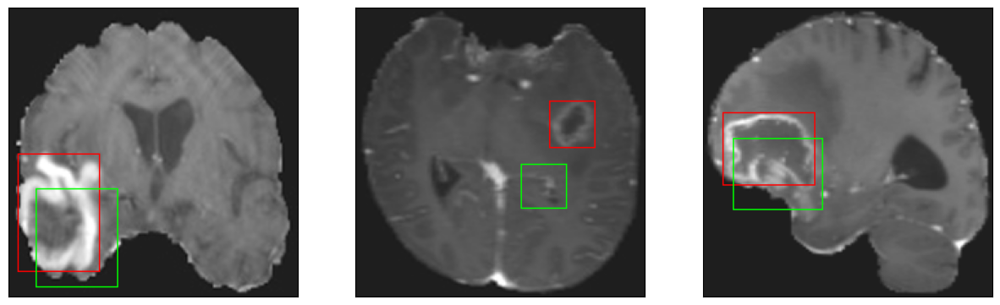

26/26 [==============================] - 3s 125ms/step - loss: 5.5573 - IoU: 0.5804 - val_loss: 14.2572 - val_IoU: 0.2707
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5681 - IoU: 0.5881
Epoch 53: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


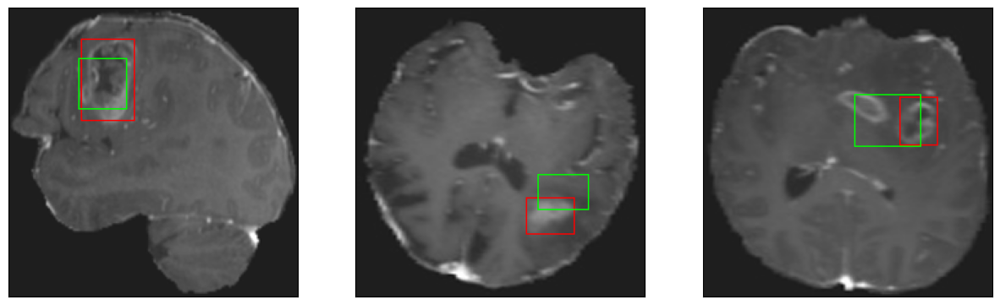

26/26 [==============================] - 3s 100ms/step - loss: 5.6094 - IoU: 0.5873 - val_loss: 9.2980 - val_IoU: 0.5111
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.6142 - IoU: 0.5763
Epoch 54: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


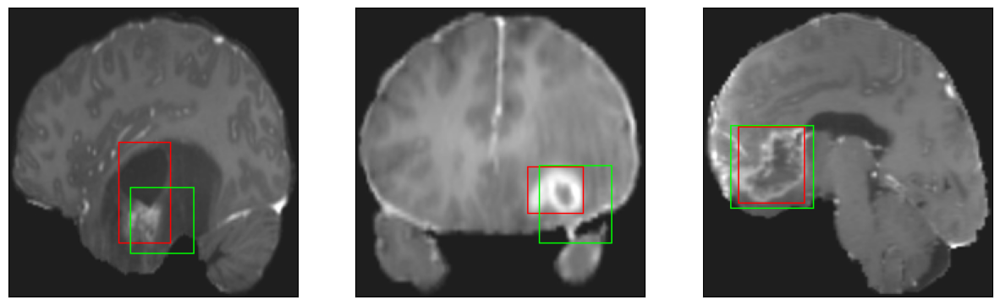

26/26 [==============================] - 3s 106ms/step - loss: 5.6142 - IoU: 0.5763 - val_loss: 12.9668 - val_IoU: 0.3618
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5525 - IoU: 0.5812
Epoch 55: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


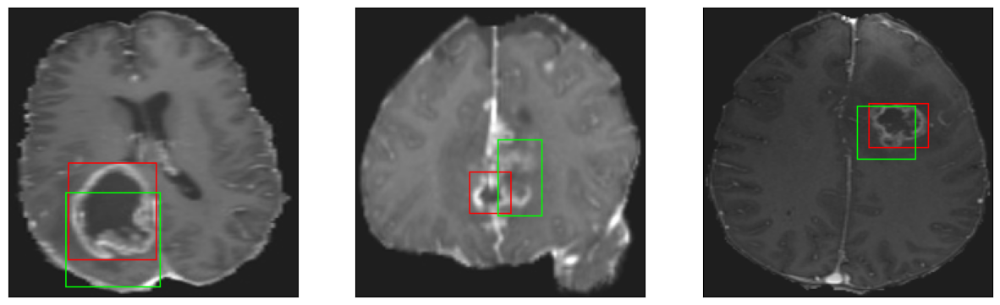

26/26 [==============================] - 3s 116ms/step - loss: 5.5642 - IoU: 0.5798 - val_loss: 10.3421 - val_IoU: 0.4634
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2153 - IoU: 0.5898
Epoch 56: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


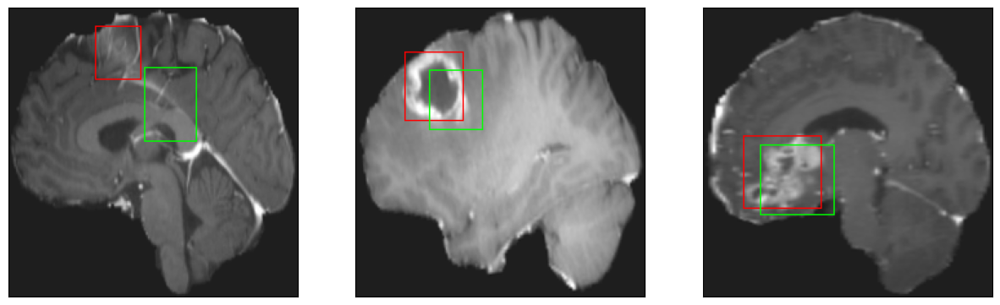

26/26 [==============================] - 3s 108ms/step - loss: 5.2059 - IoU: 0.5907 - val_loss: 11.3238 - val_IoU: 0.4065
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3284 - IoU: 0.5956
Epoch 57: val_IoU did not improve from 0.51898
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


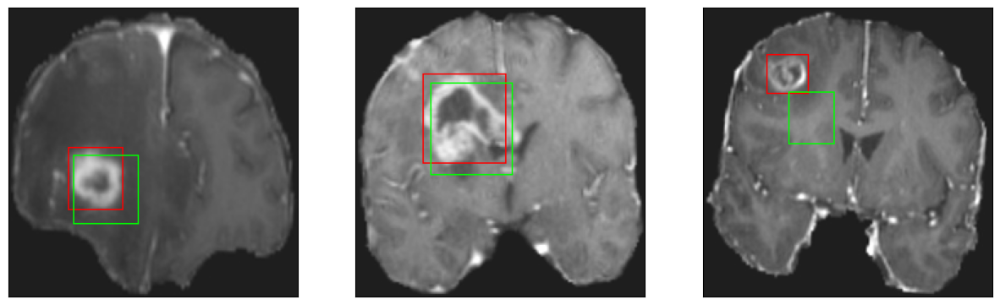

26/26 [==============================] - 3s 109ms/step - loss: 5.3580 - IoU: 0.5952 - val_loss: 13.0868 - val_IoU: 0.3339
Epoch 58/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4720 - IoU: 0.5843
Epoch 58: val_IoU improved from 0.51898 to 0.52397, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


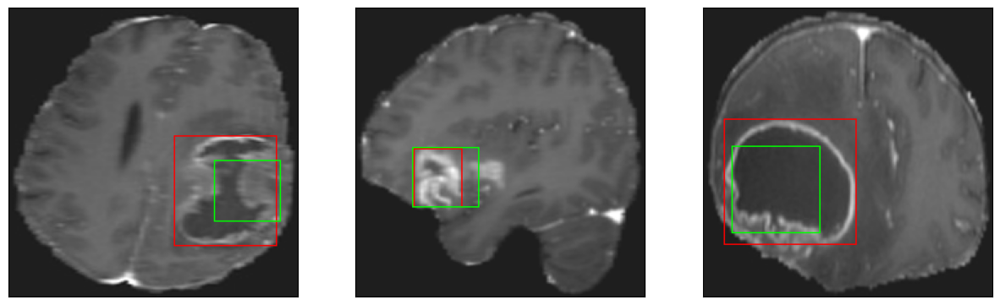

26/26 [==============================] - 4s 140ms/step - loss: 5.5022 - IoU: 0.5834 - val_loss: 9.0649 - val_IoU: 0.5240
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4125 - IoU: 0.5879
Epoch 59: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


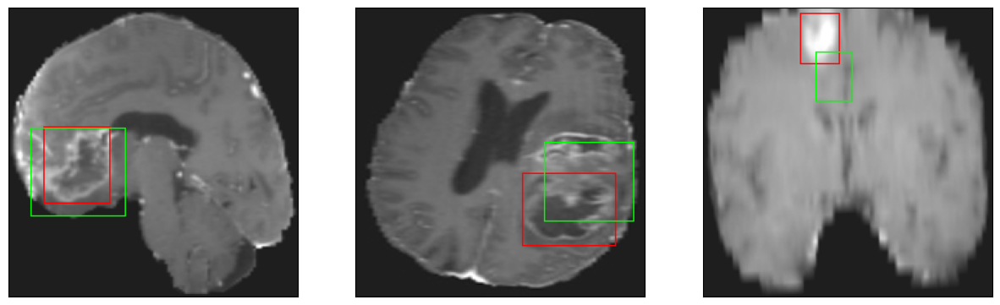

26/26 [==============================] - 3s 125ms/step - loss: 5.4246 - IoU: 0.5899 - val_loss: 14.5335 - val_IoU: 0.3088
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.5261 - IoU: 0.5923
Epoch 60: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


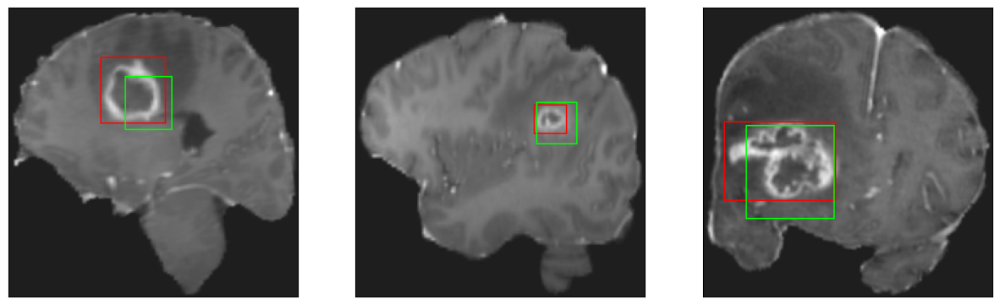

26/26 [==============================] - 3s 120ms/step - loss: 5.5261 - IoU: 0.5923 - val_loss: 9.4641 - val_IoU: 0.4933
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1650 - IoU: 0.6001
Epoch 61: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


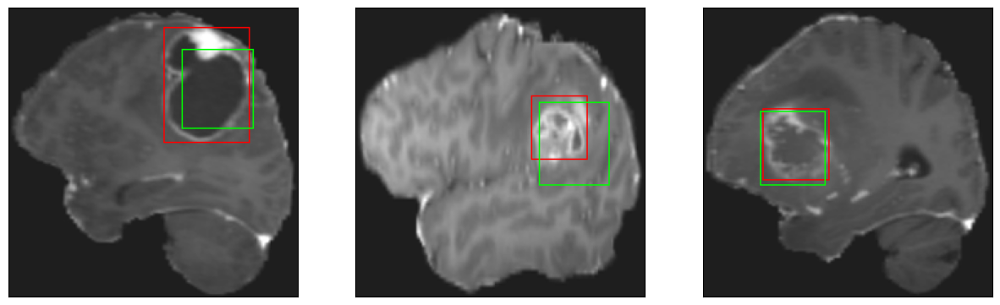

26/26 [==============================] - 3s 105ms/step - loss: 5.1345 - IoU: 0.6008 - val_loss: 11.3845 - val_IoU: 0.4061
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2765 - IoU: 0.5941
Epoch 62: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


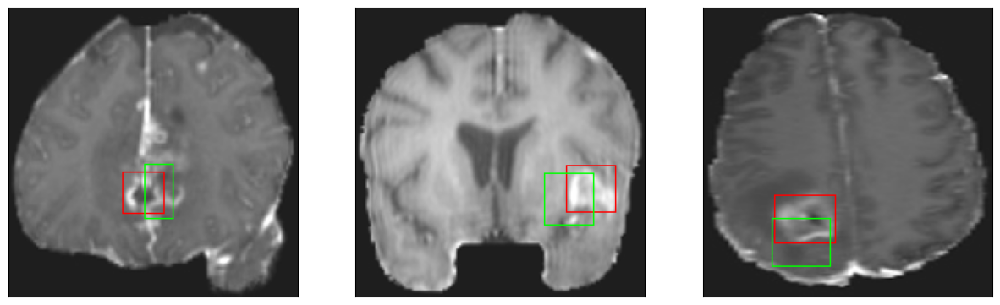

26/26 [==============================] - 3s 104ms/step - loss: 5.3067 - IoU: 0.5926 - val_loss: 9.8251 - val_IoU: 0.4853
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 5.6047 - IoU: 0.5785
Epoch 63: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


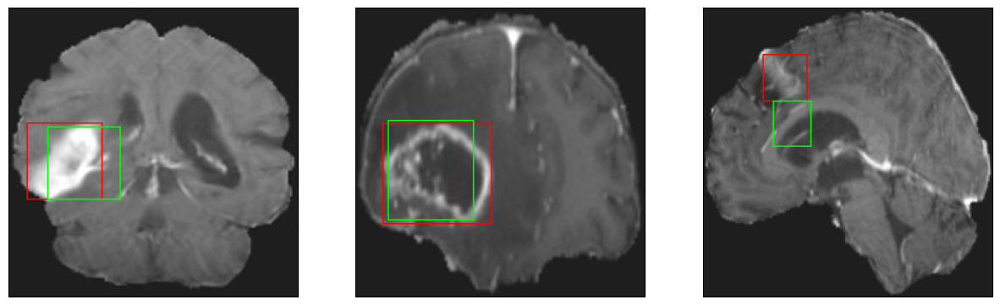

26/26 [==============================] - 3s 123ms/step - loss: 5.6047 - IoU: 0.5785 - val_loss: 9.6819 - val_IoU: 0.4854
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 5.2533 - IoU: 0.5985
Epoch 64: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


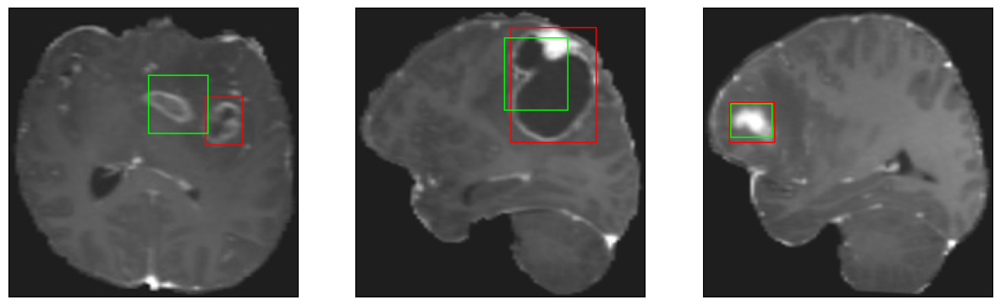

26/26 [==============================] - 3s 113ms/step - loss: 5.2533 - IoU: 0.5985 - val_loss: 10.6022 - val_IoU: 0.4388
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4083 - IoU: 0.5894
Epoch 65: val_IoU did not improve from 0.52397
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


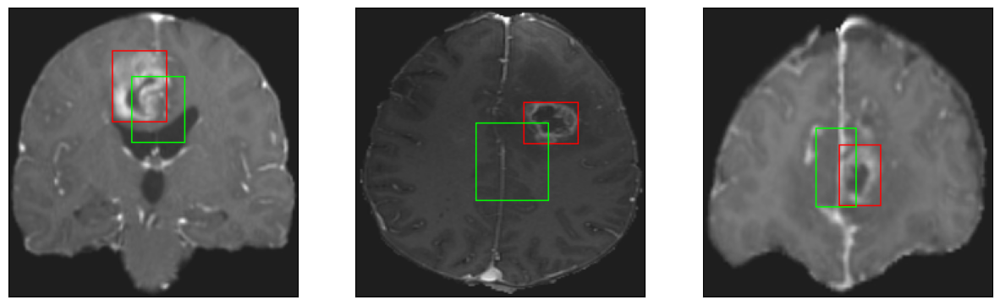

26/26 [==============================] - 3s 108ms/step - loss: 5.3961 - IoU: 0.5903 - val_loss: 9.8605 - val_IoU: 0.4670
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.3615 - IoU: 0.5898
Epoch 66: val_IoU improved from 0.52397 to 0.52857, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


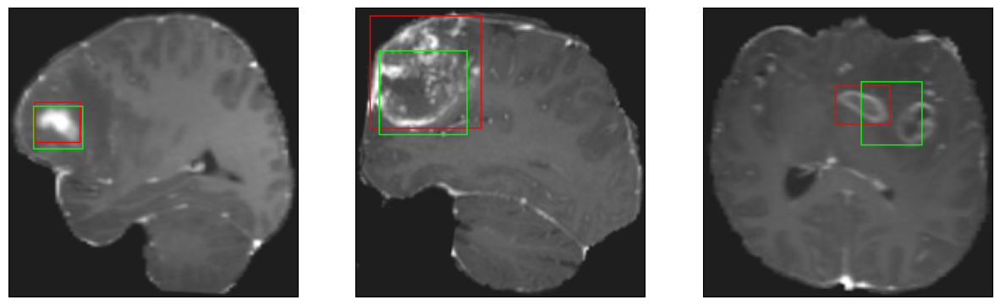

26/26 [==============================] - 4s 142ms/step - loss: 5.3615 - IoU: 0.5898 - val_loss: 8.7326 - val_IoU: 0.5286
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 5.4202 - IoU: 0.5940
Epoch 67: val_IoU did not improve from 0.52857
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


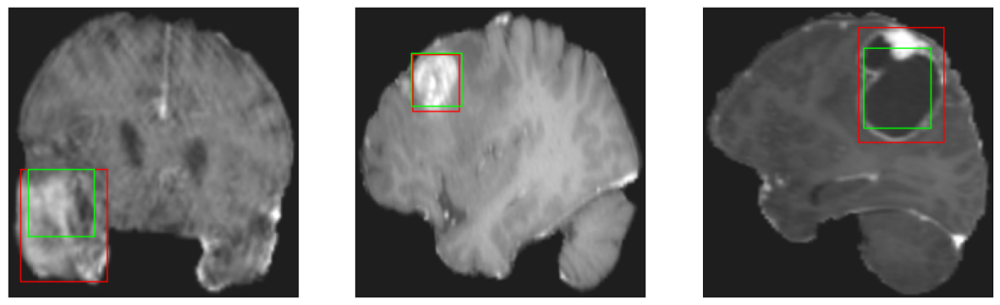

26/26 [==============================] - 3s 111ms/step - loss: 5.4202 - IoU: 0.5940 - val_loss: 9.4903 - val_IoU: 0.5095
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 5.1042 - IoU: 0.6140
Epoch 68: val_IoU did not improve from 0.52857
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


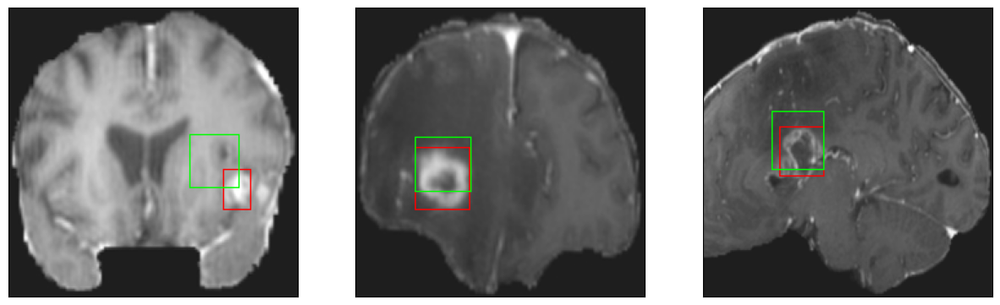

26/26 [==============================] - 3s 106ms/step - loss: 5.1042 - IoU: 0.6140 - val_loss: 9.0325 - val_IoU: 0.5090
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9745 - IoU: 0.6096
Epoch 69: val_IoU did not improve from 0.52857
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


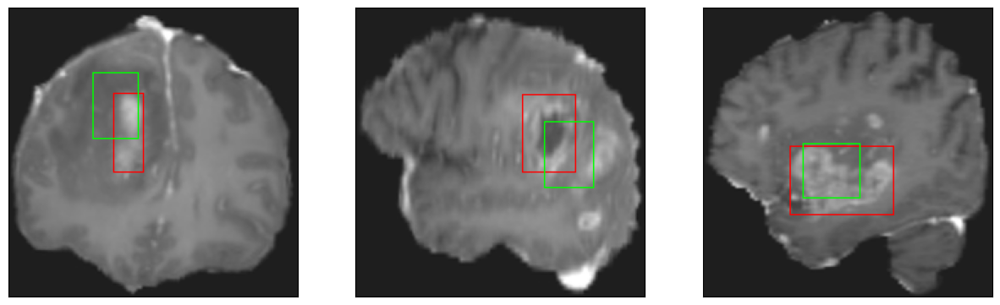

26/26 [==============================] - 3s 111ms/step - loss: 4.9458 - IoU: 0.6115 - val_loss: 9.0960 - val_IoU: 0.5080
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.0486 - IoU: 0.6042
Epoch 70: val_IoU improved from 0.52857 to 0.53643, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


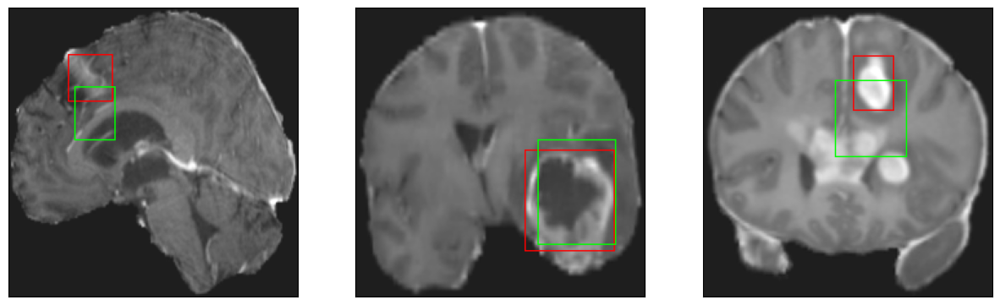

26/26 [==============================] - 4s 151ms/step - loss: 5.0486 - IoU: 0.6042 - val_loss: 8.7440 - val_IoU: 0.5364
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3007 - IoU: 0.5959
Epoch 71: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


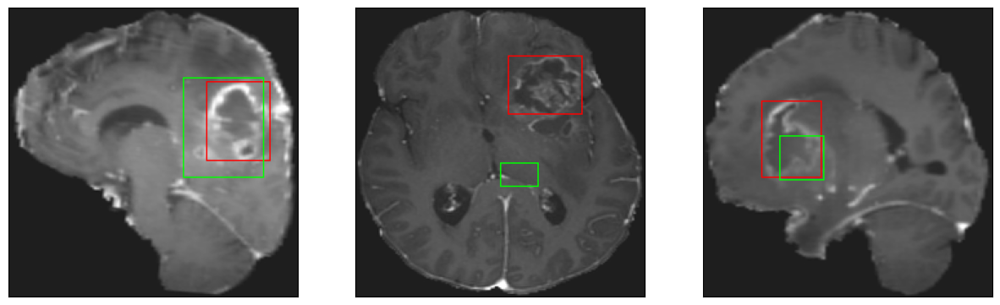

26/26 [==============================] - 3s 100ms/step - loss: 5.2868 - IoU: 0.5959 - val_loss: 10.6813 - val_IoU: 0.4233
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 4.9288 - IoU: 0.6209
Epoch 72: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


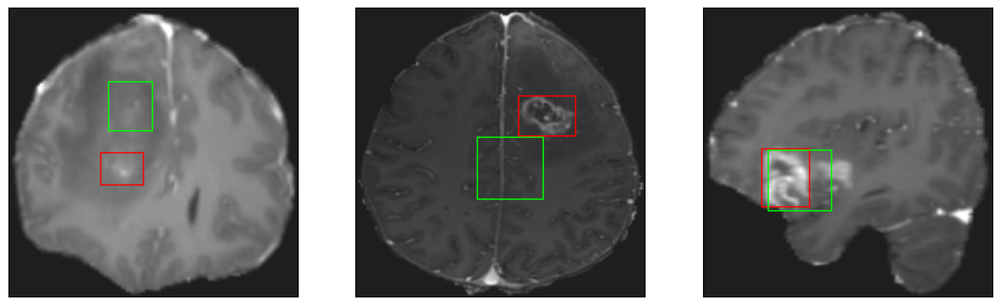

26/26 [==============================] - 3s 108ms/step - loss: 4.9288 - IoU: 0.6209 - val_loss: 8.8478 - val_IoU: 0.5198
Epoch 73/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2056 - IoU: 0.6039
Epoch 73: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


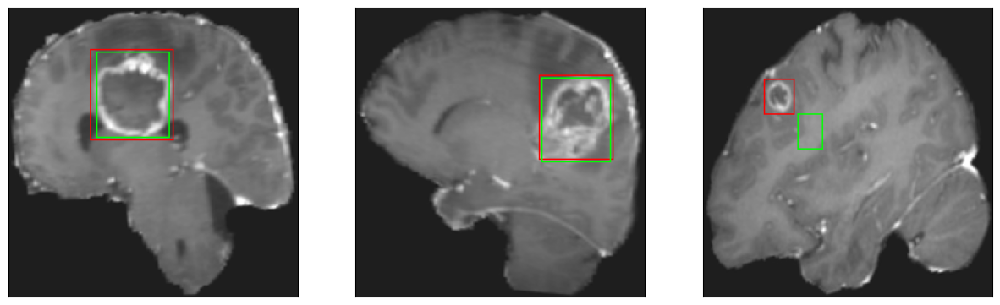

26/26 [==============================] - 3s 123ms/step - loss: 5.1874 - IoU: 0.6038 - val_loss: 9.4011 - val_IoU: 0.4975
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1178 - IoU: 0.6069
Epoch 74: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


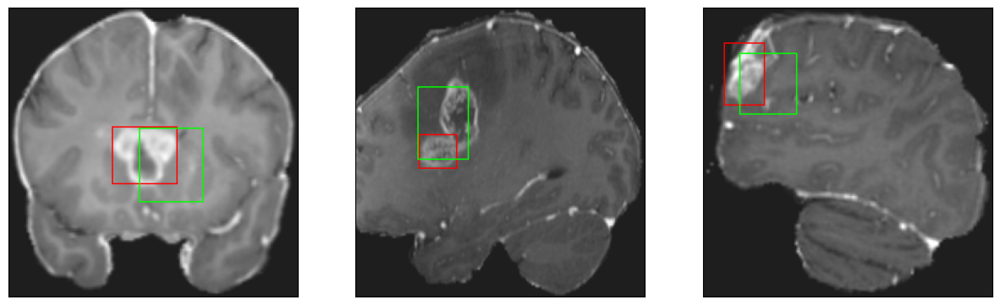

26/26 [==============================] - 3s 106ms/step - loss: 5.1386 - IoU: 0.6048 - val_loss: 9.8594 - val_IoU: 0.4635
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 4.9841 - IoU: 0.6147
Epoch 75: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


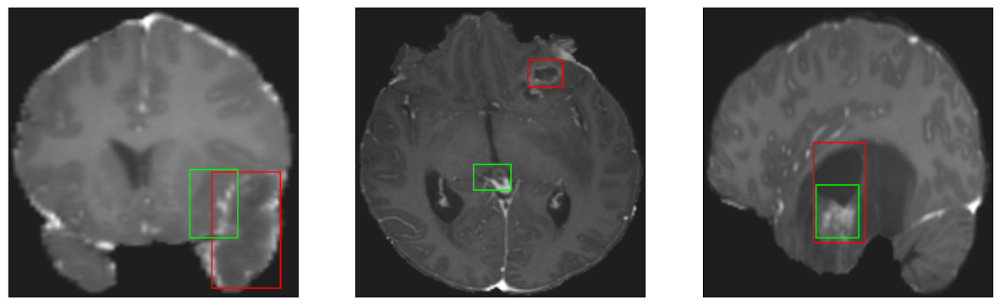

26/26 [==============================] - 2s 94ms/step - loss: 4.9841 - IoU: 0.6147 - val_loss: 9.7826 - val_IoU: 0.4701
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3319 - IoU: 0.5956
Epoch 76: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


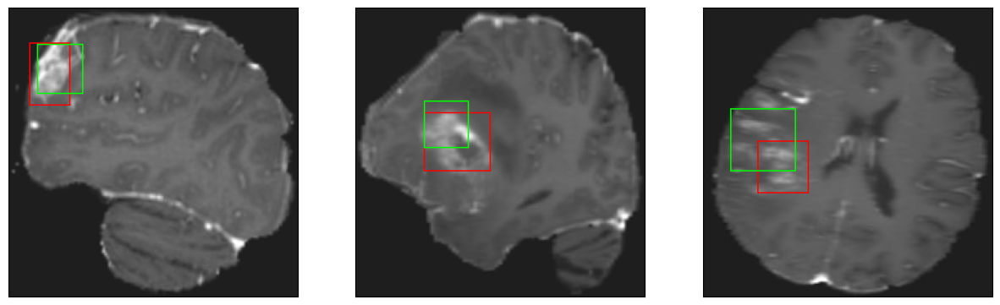

26/26 [==============================] - 3s 108ms/step - loss: 5.3118 - IoU: 0.5946 - val_loss: 10.2000 - val_IoU: 0.4688
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 4.8795 - IoU: 0.6237
Epoch 77: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


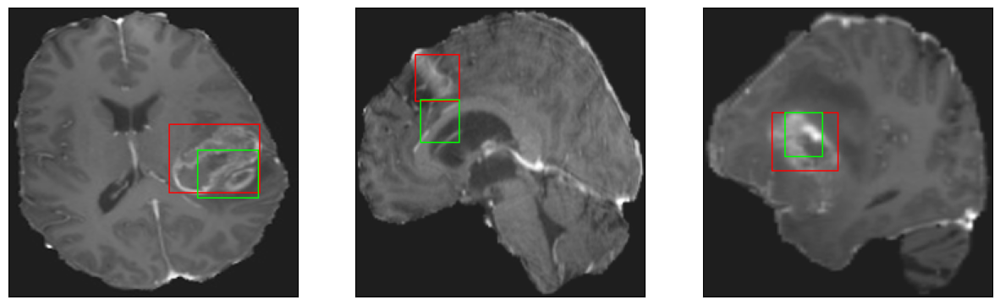

26/26 [==============================] - 3s 116ms/step - loss: 4.8795 - IoU: 0.6237 - val_loss: 9.5496 - val_IoU: 0.5074
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9690 - IoU: 0.6158
Epoch 78: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


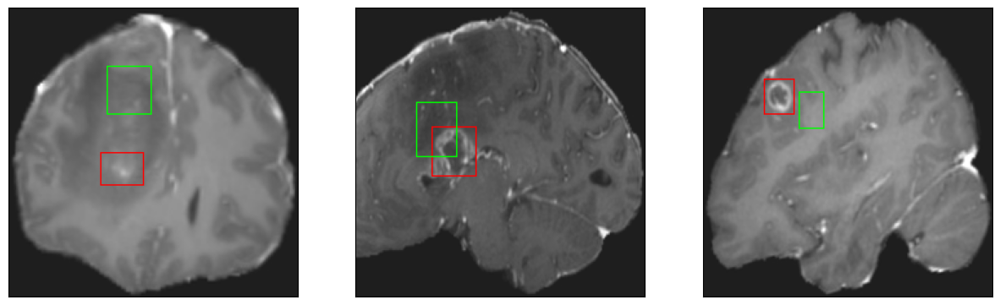

26/26 [==============================] - 3s 130ms/step - loss: 4.9997 - IoU: 0.6134 - val_loss: 10.0985 - val_IoU: 0.4675
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8414 - IoU: 0.6206
Epoch 79: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


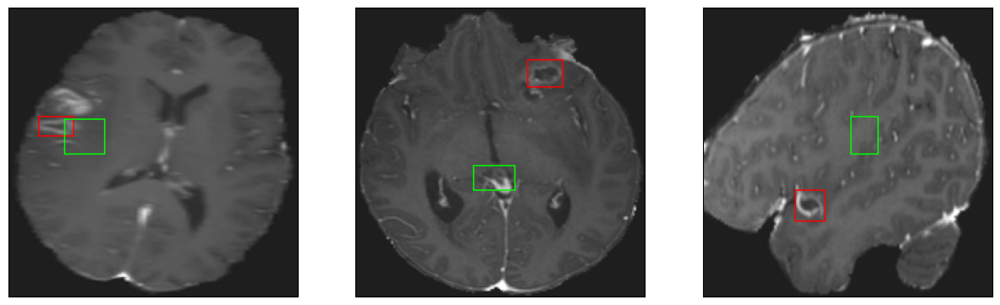

26/26 [==============================] - 3s 107ms/step - loss: 4.8337 - IoU: 0.6212 - val_loss: 8.9734 - val_IoU: 0.5141
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9315 - IoU: 0.6119
Epoch 80: val_IoU did not improve from 0.53643
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


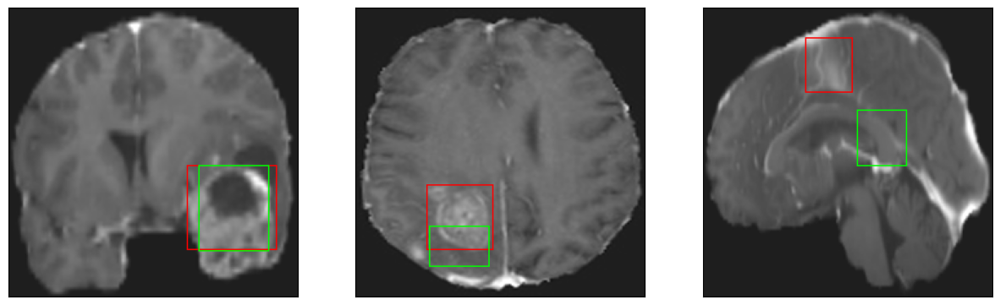

26/26 [==============================] - 3s 99ms/step - loss: 4.9257 - IoU: 0.6138 - val_loss: 9.6413 - val_IoU: 0.4836
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0982 - IoU: 0.6071
Epoch 81: val_IoU improved from 0.53643 to 0.53666, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


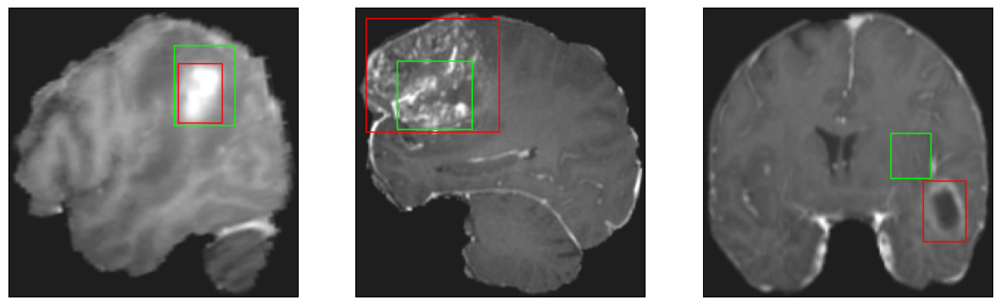

26/26 [==============================] - 4s 165ms/step - loss: 5.1405 - IoU: 0.6053 - val_loss: 8.8061 - val_IoU: 0.5367
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0565 - IoU: 0.6071
Epoch 82: val_IoU did not improve from 0.53666
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


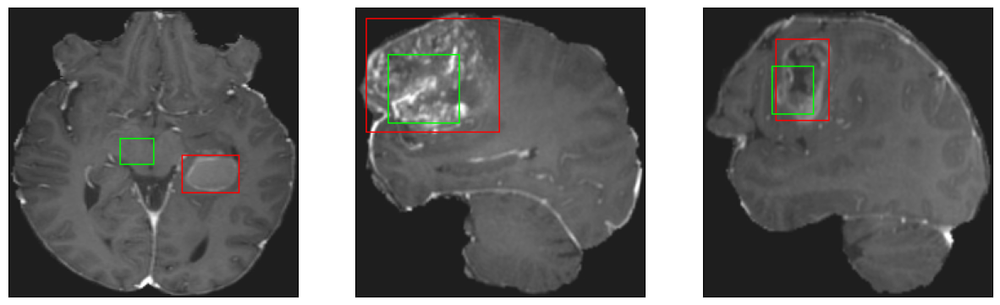

26/26 [==============================] - 3s 95ms/step - loss: 5.0948 - IoU: 0.6036 - val_loss: 12.0166 - val_IoU: 0.3855
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0069 - IoU: 0.6101
Epoch 83: val_IoU did not improve from 0.53666
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


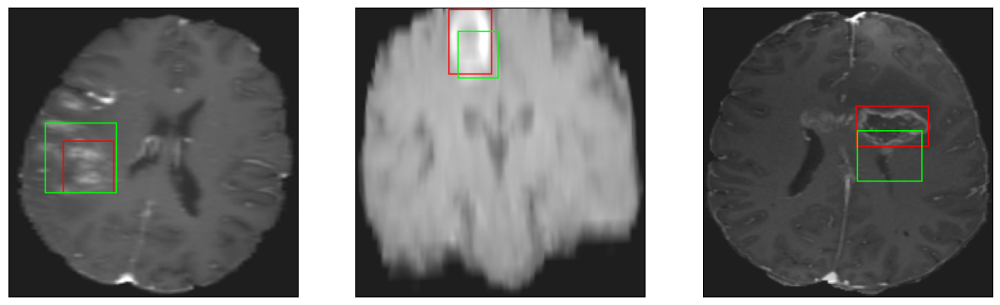

26/26 [==============================] - 2s 91ms/step - loss: 4.9815 - IoU: 0.6102 - val_loss: 9.9372 - val_IoU: 0.4547
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6115 - IoU: 0.6330
Epoch 84: val_IoU did not improve from 0.53666
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


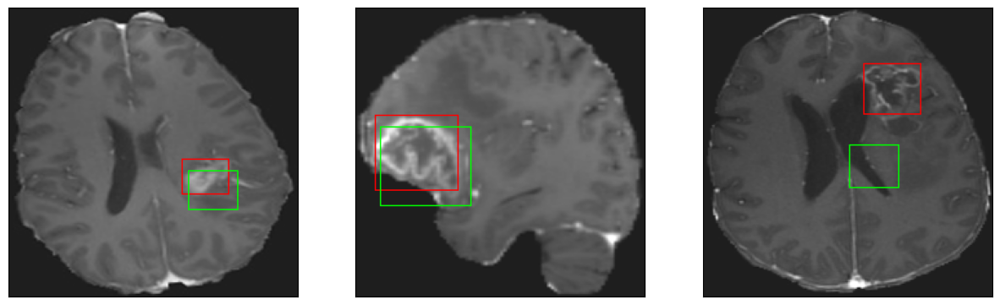

26/26 [==============================] - 3s 105ms/step - loss: 4.6770 - IoU: 0.6321 - val_loss: 11.3613 - val_IoU: 0.3987
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8526 - IoU: 0.6226
Epoch 85: val_IoU did not improve from 0.53666
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


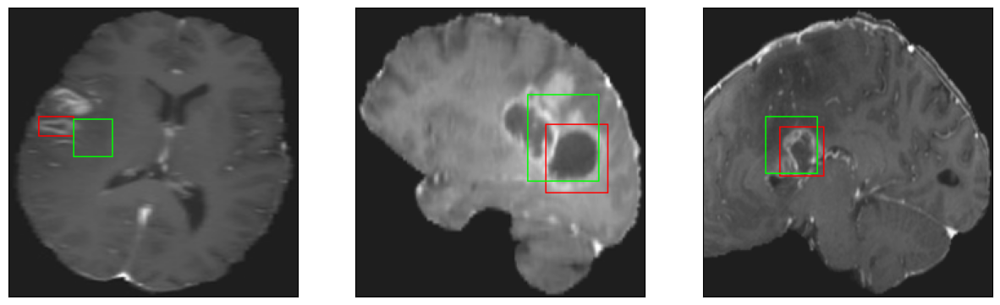

26/26 [==============================] - 3s 121ms/step - loss: 4.8246 - IoU: 0.6231 - val_loss: 9.3190 - val_IoU: 0.5150
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7753 - IoU: 0.6223
Epoch 86: val_IoU did not improve from 0.53666
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


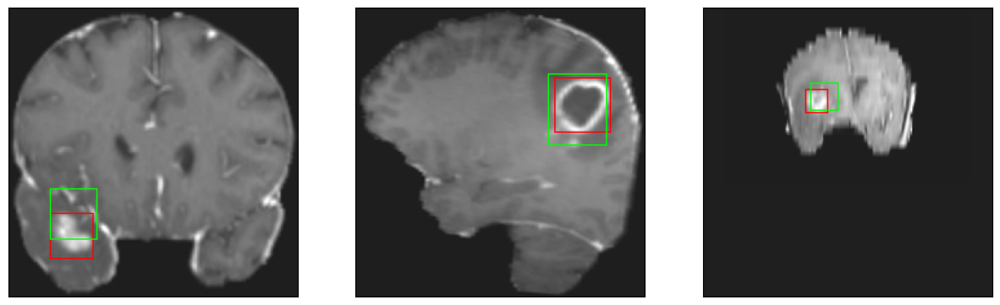

26/26 [==============================] - 3s 96ms/step - loss: 4.8178 - IoU: 0.6217 - val_loss: 8.9350 - val_IoU: 0.5279
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 4.7023 - IoU: 0.6288
Epoch 87: val_IoU did not improve from 0.53666
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


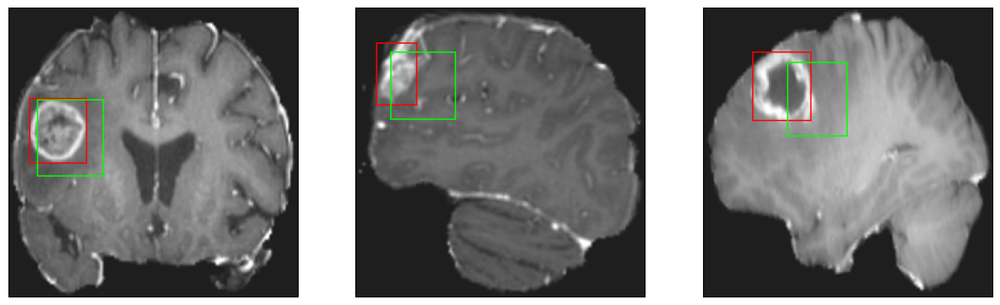

26/26 [==============================] - 3s 103ms/step - loss: 4.7023 - IoU: 0.6288 - val_loss: 10.4082 - val_IoU: 0.4773
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7562 - IoU: 0.6265
Epoch 88: val_IoU improved from 0.53666 to 0.55816, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


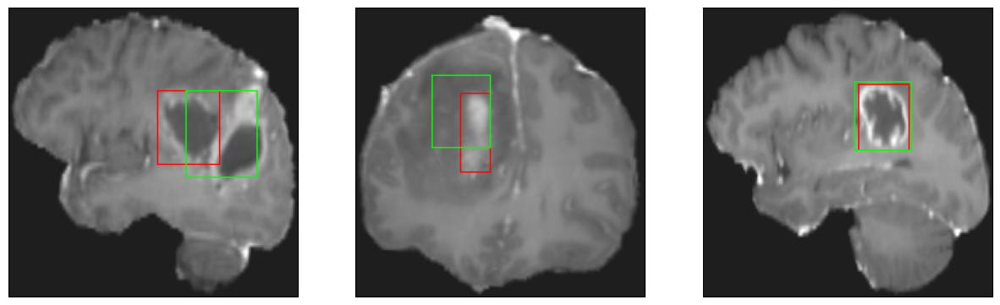

26/26 [==============================] - 4s 141ms/step - loss: 4.7565 - IoU: 0.6290 - val_loss: 8.4336 - val_IoU: 0.5582
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7143 - IoU: 0.6244
Epoch 89: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


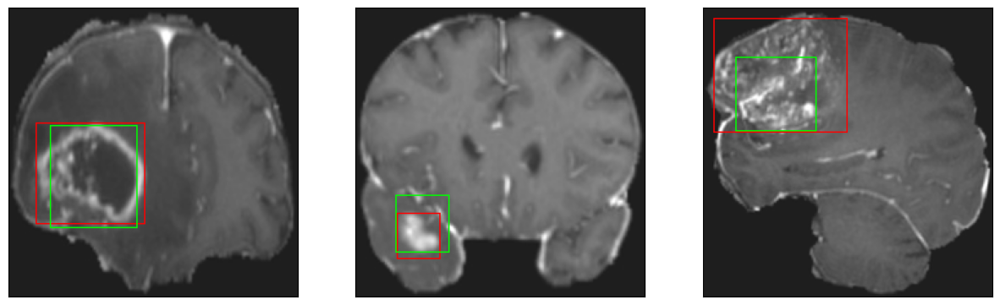

26/26 [==============================] - 3s 117ms/step - loss: 4.7080 - IoU: 0.6246 - val_loss: 9.0013 - val_IoU: 0.5299
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7934 - IoU: 0.6295
Epoch 90: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


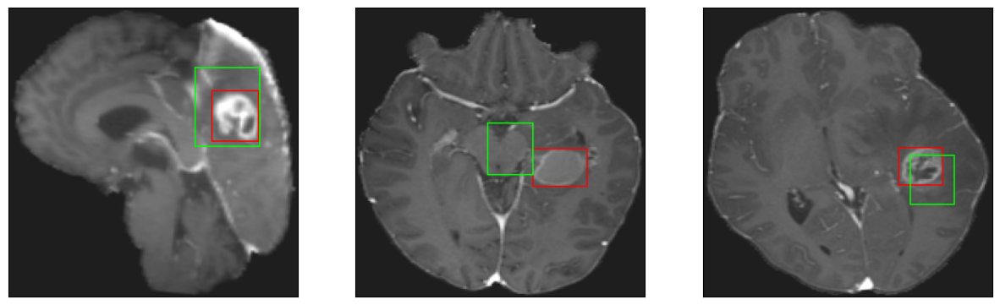

26/26 [==============================] - 3s 103ms/step - loss: 4.7849 - IoU: 0.6286 - val_loss: 9.0859 - val_IoU: 0.5288
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6912 - IoU: 0.6318
Epoch 91: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


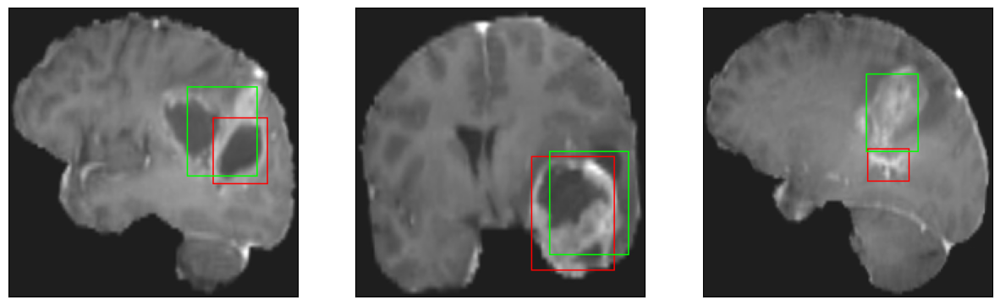

26/26 [==============================] - 3s 101ms/step - loss: 4.6770 - IoU: 0.6328 - val_loss: 8.7245 - val_IoU: 0.5498
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 4.7308 - IoU: 0.6286
Epoch 92: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


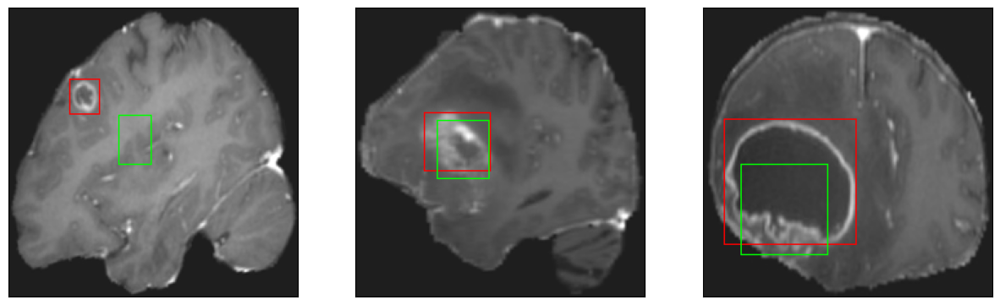

26/26 [==============================] - 3s 125ms/step - loss: 4.7308 - IoU: 0.6286 - val_loss: 12.7541 - val_IoU: 0.3322
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 4.5886 - IoU: 0.6290
Epoch 93: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


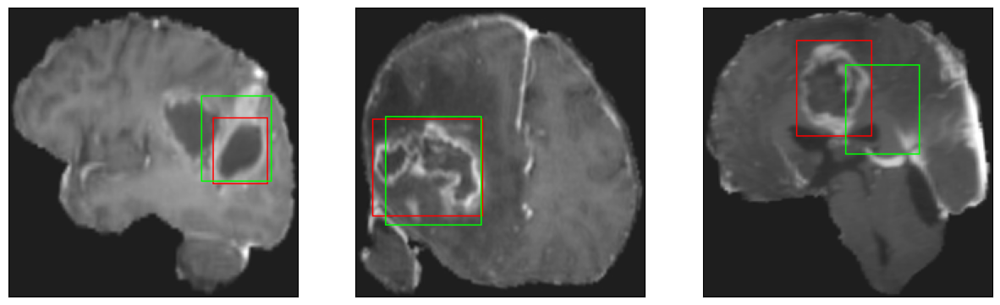

26/26 [==============================] - 3s 103ms/step - loss: 4.5886 - IoU: 0.6290 - val_loss: 9.7227 - val_IoU: 0.4877
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2620 - IoU: 0.6015
Epoch 94: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


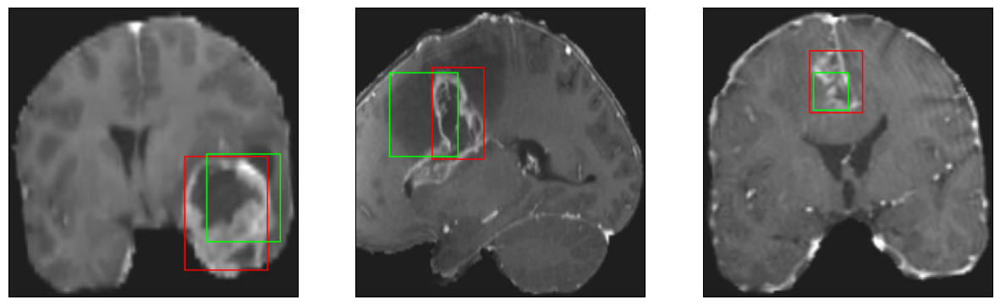

26/26 [==============================] - 3s 105ms/step - loss: 5.2397 - IoU: 0.6022 - val_loss: 9.8141 - val_IoU: 0.4710
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7618 - IoU: 0.6276
Epoch 95: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


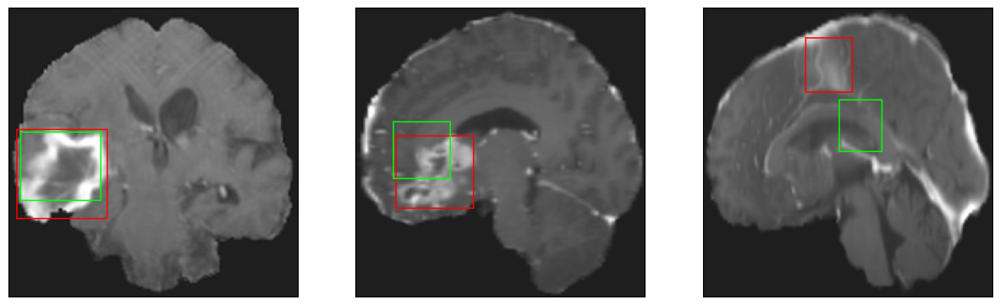

26/26 [==============================] - 3s 118ms/step - loss: 4.7415 - IoU: 0.6284 - val_loss: 13.0952 - val_IoU: 0.3060
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7632 - IoU: 0.6296
Epoch 96: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


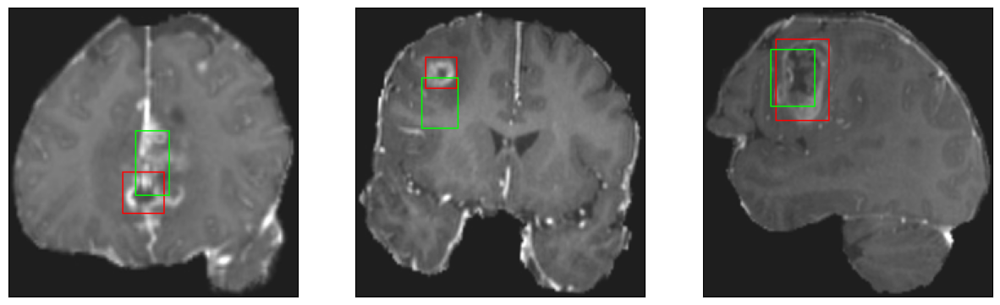

26/26 [==============================] - 3s 113ms/step - loss: 4.7726 - IoU: 0.6285 - val_loss: 9.1540 - val_IoU: 0.5111
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.9313 - IoU: 0.6135
Epoch 97: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


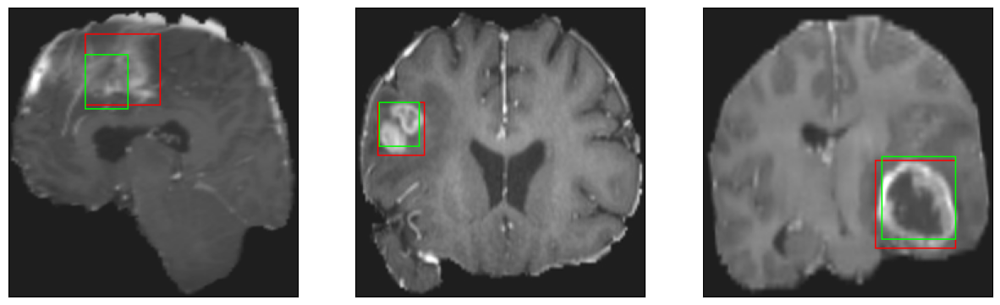

26/26 [==============================] - 3s 119ms/step - loss: 4.9313 - IoU: 0.6135 - val_loss: 10.1915 - val_IoU: 0.4678
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.6342 - IoU: 0.6339
Epoch 98: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


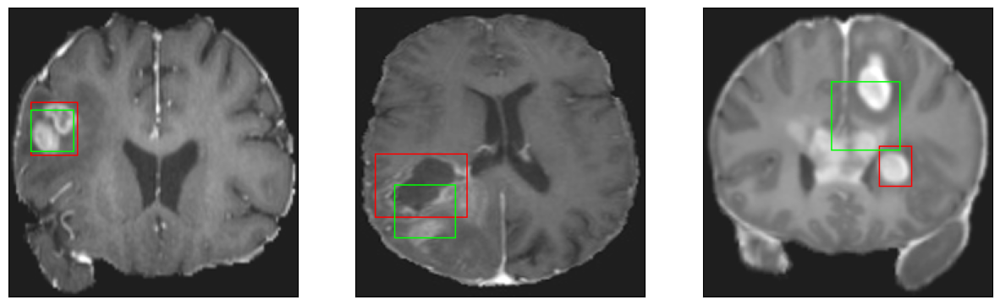

26/26 [==============================] - 3s 114ms/step - loss: 4.6342 - IoU: 0.6339 - val_loss: 9.3171 - val_IoU: 0.5110
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.7118 - IoU: 0.6331
Epoch 99: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


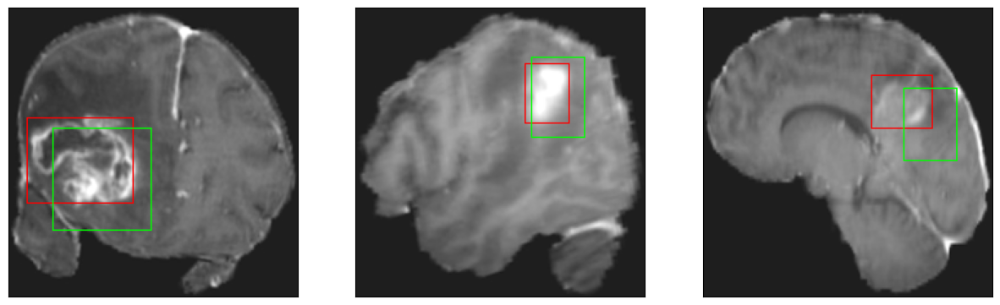

26/26 [==============================] - 3s 118ms/step - loss: 4.7118 - IoU: 0.6331 - val_loss: 12.6253 - val_IoU: 0.3247
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 4.6586 - IoU: 0.6285
Epoch 100: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


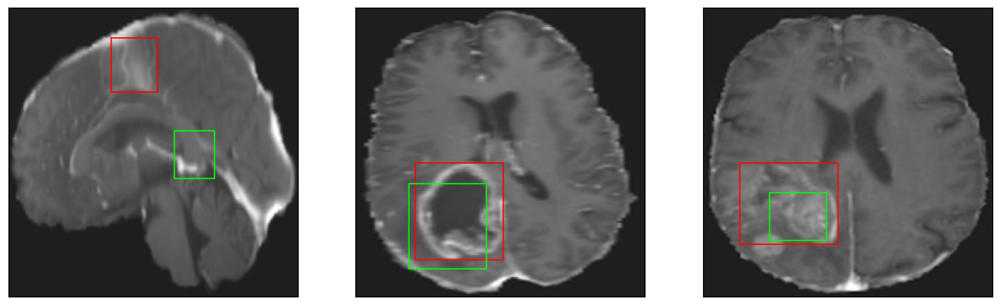

26/26 [==============================] - 3s 130ms/step - loss: 4.6586 - IoU: 0.6285 - val_loss: 9.1281 - val_IoU: 0.5088
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6706 - IoU: 0.6340
Epoch 101: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


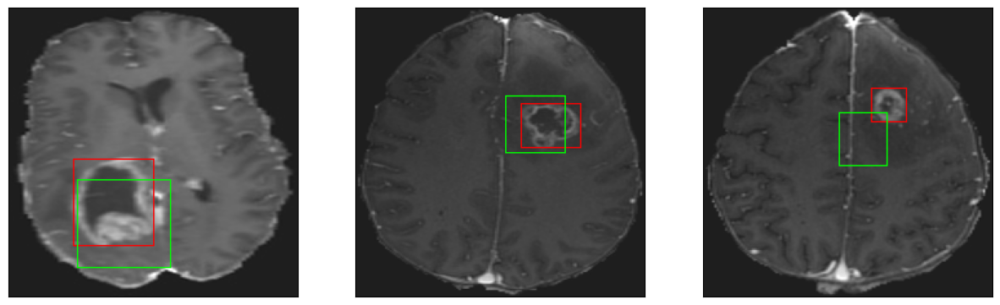

26/26 [==============================] - 3s 119ms/step - loss: 4.6612 - IoU: 0.6346 - val_loss: 9.0712 - val_IoU: 0.5122
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7347 - IoU: 0.6222
Epoch 102: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


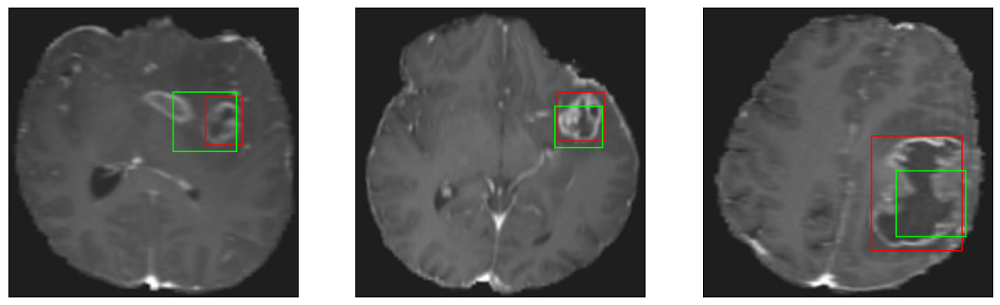

26/26 [==============================] - 3s 102ms/step - loss: 4.7240 - IoU: 0.6221 - val_loss: 9.7600 - val_IoU: 0.4714
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.8894 - IoU: 0.6176
Epoch 103: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


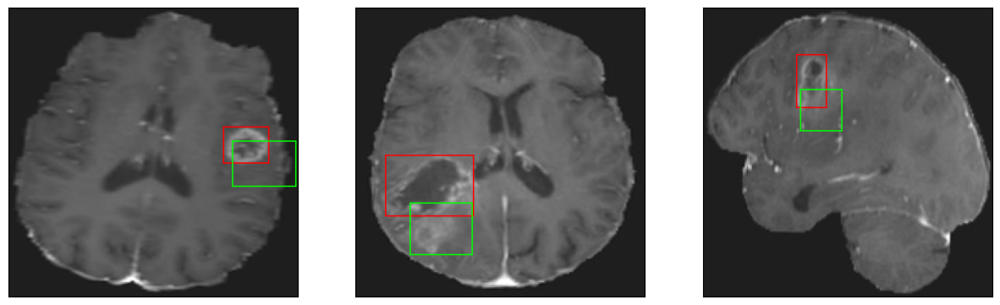

26/26 [==============================] - 3s 98ms/step - loss: 4.8894 - IoU: 0.6176 - val_loss: 10.4499 - val_IoU: 0.4377
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 4.7078 - IoU: 0.6253
Epoch 104: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


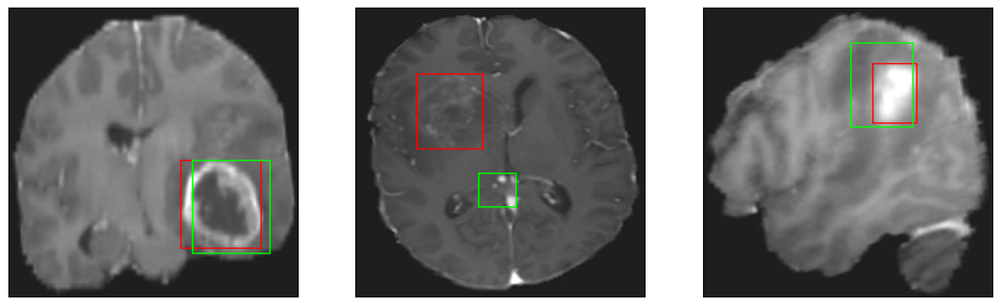

26/26 [==============================] - 3s 102ms/step - loss: 4.7078 - IoU: 0.6253 - val_loss: 9.3062 - val_IoU: 0.5128
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5715 - IoU: 0.6359
Epoch 105: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


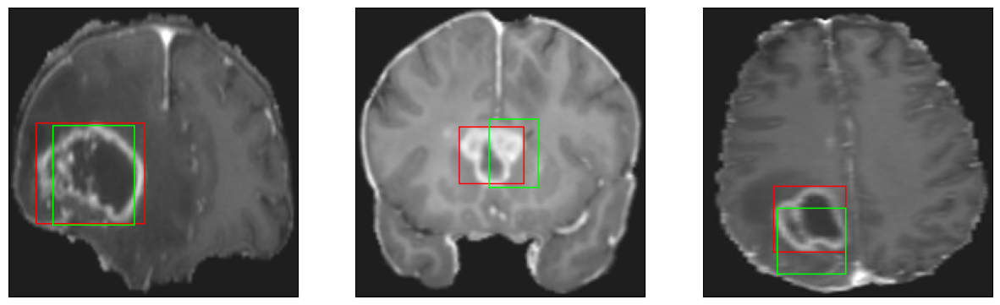

26/26 [==============================] - 3s 102ms/step - loss: 4.5555 - IoU: 0.6366 - val_loss: 8.6733 - val_IoU: 0.5506
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0592 - IoU: 0.6133
Epoch 106: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


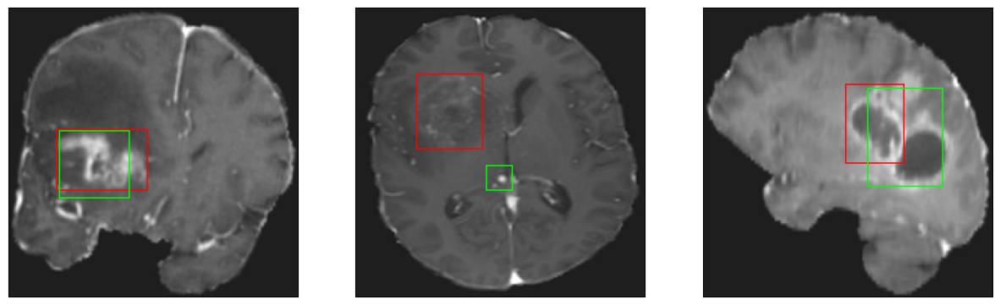

26/26 [==============================] - 3s 123ms/step - loss: 5.1172 - IoU: 0.6107 - val_loss: 9.0690 - val_IoU: 0.5331
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7001 - IoU: 0.6305
Epoch 107: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


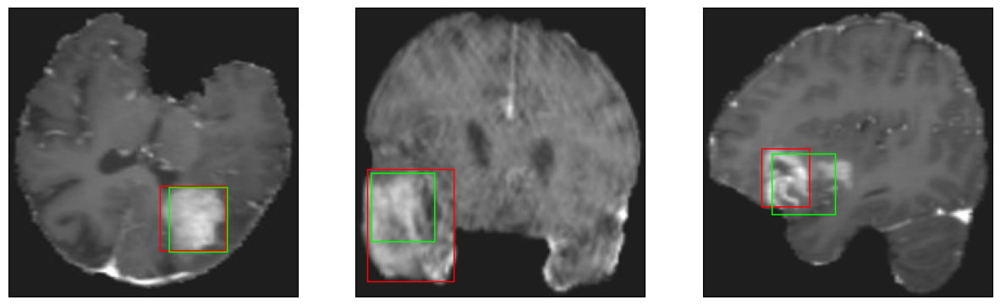

26/26 [==============================] - 3s 117ms/step - loss: 4.6781 - IoU: 0.6297 - val_loss: 9.3674 - val_IoU: 0.5009
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4542 - IoU: 0.6388
Epoch 108: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


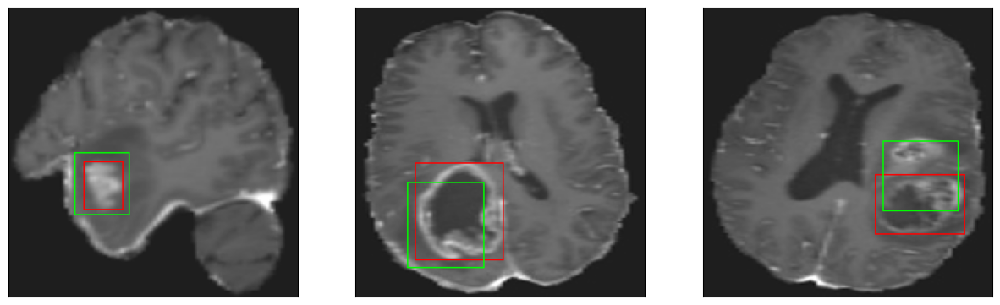

26/26 [==============================] - 3s 100ms/step - loss: 4.5020 - IoU: 0.6379 - val_loss: 8.8070 - val_IoU: 0.5362
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0169 - IoU: 0.6126
Epoch 109: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


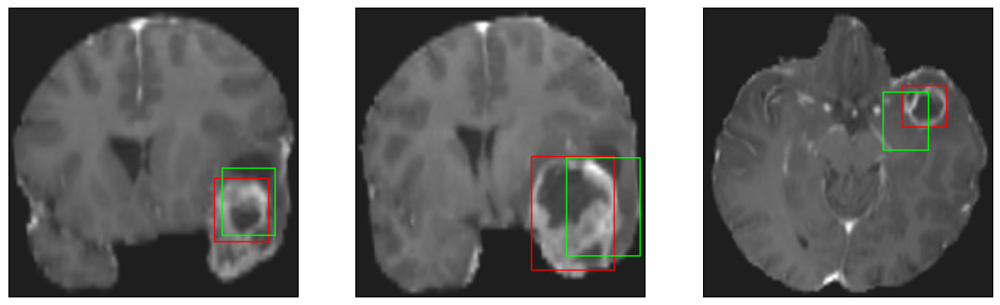

26/26 [==============================] - 3s 101ms/step - loss: 5.0024 - IoU: 0.6126 - val_loss: 9.0883 - val_IoU: 0.5032
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5985 - IoU: 0.6365
Epoch 110: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


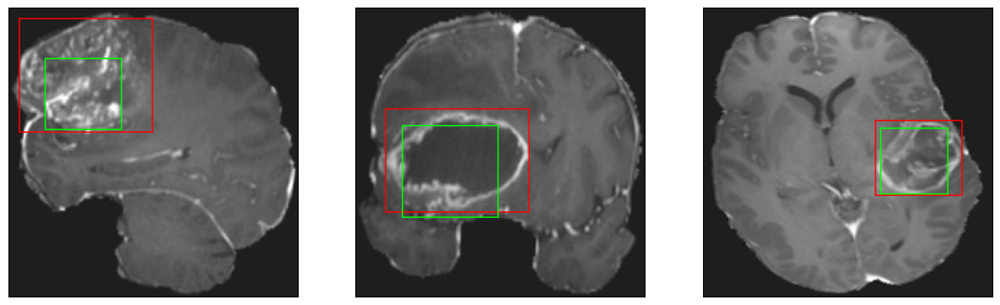

26/26 [==============================] - 3s 129ms/step - loss: 4.6054 - IoU: 0.6363 - val_loss: 8.5787 - val_IoU: 0.5433
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 4.4592 - IoU: 0.6443
Epoch 111: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


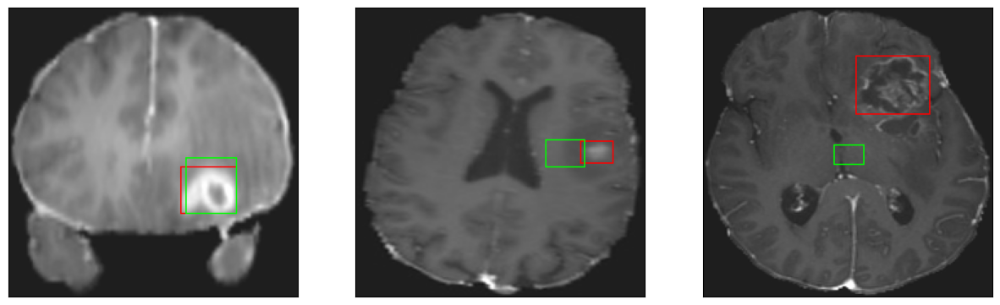

26/26 [==============================] - 3s 116ms/step - loss: 4.4592 - IoU: 0.6443 - val_loss: 10.2827 - val_IoU: 0.4816
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4858 - IoU: 0.6421
Epoch 112: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


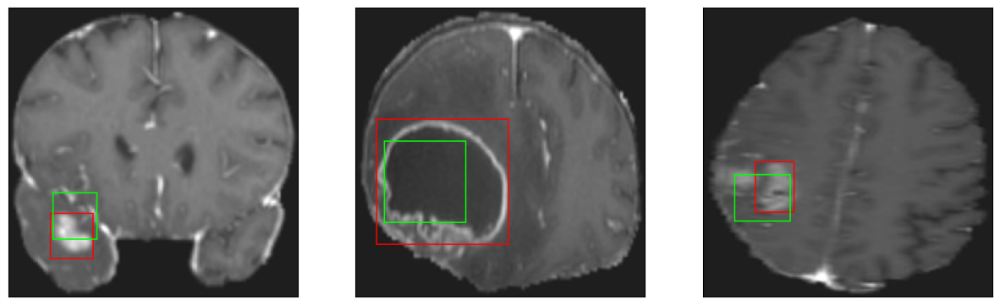

26/26 [==============================] - 2s 97ms/step - loss: 4.4684 - IoU: 0.6422 - val_loss: 9.0916 - val_IoU: 0.5144
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5672 - IoU: 0.6389
Epoch 113: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


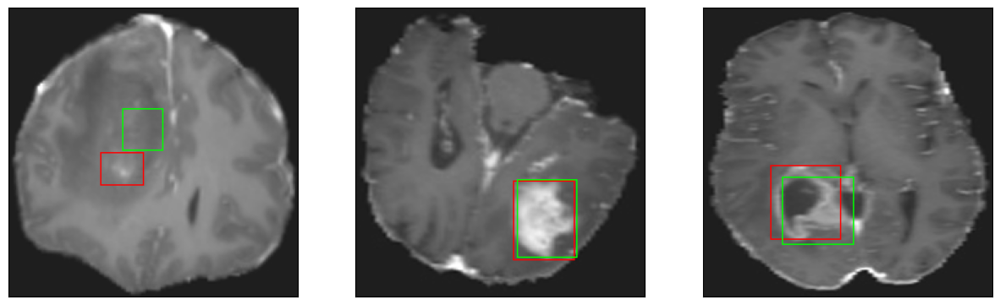

26/26 [==============================] - 3s 103ms/step - loss: 4.5886 - IoU: 0.6365 - val_loss: 9.2581 - val_IoU: 0.4971
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.5497 - IoU: 0.6353
Epoch 114: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4


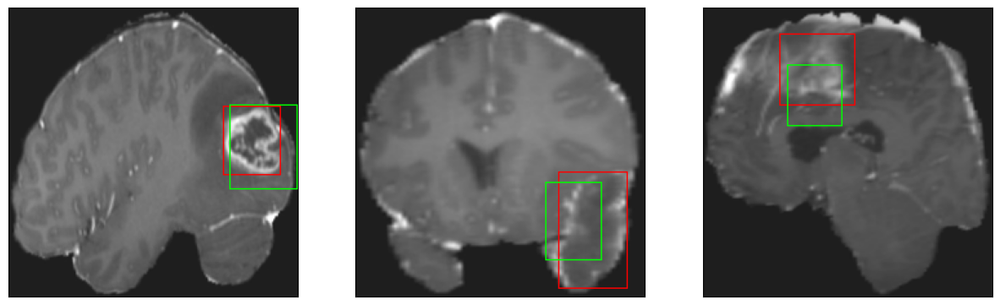

26/26 [==============================] - 3s 109ms/step - loss: 4.5497 - IoU: 0.6353 - val_loss: 11.6942 - val_IoU: 0.4016
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4180 - IoU: 0.6423
Epoch 115: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


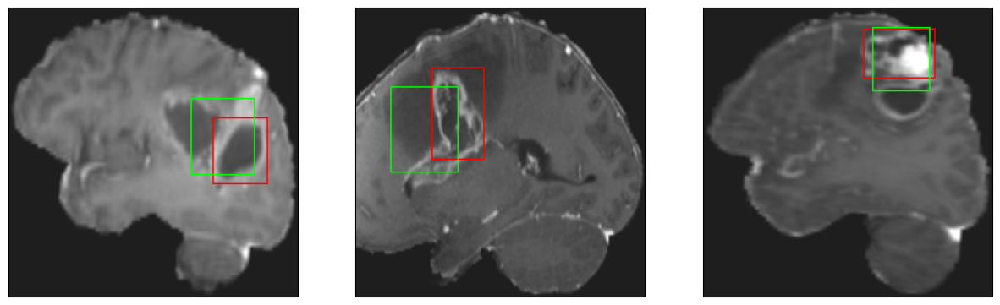

26/26 [==============================] - 3s 110ms/step - loss: 4.4546 - IoU: 0.6422 - val_loss: 8.8778 - val_IoU: 0.5255
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.6090 - IoU: 0.6361
Epoch 116: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


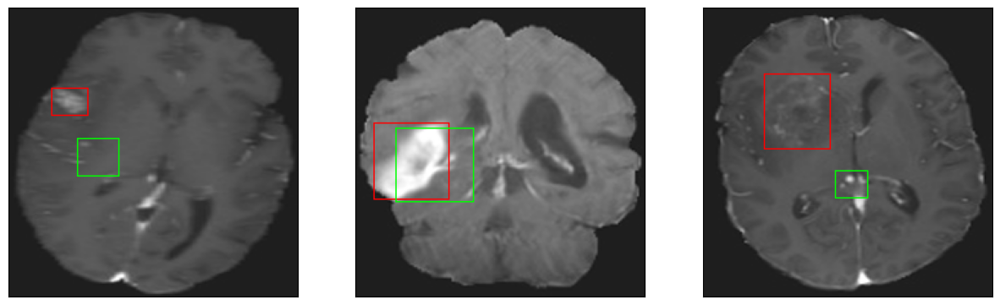

26/26 [==============================] - 3s 109ms/step - loss: 4.6090 - IoU: 0.6361 - val_loss: 9.2893 - val_IoU: 0.5002
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4312 - IoU: 0.6462
Epoch 117: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


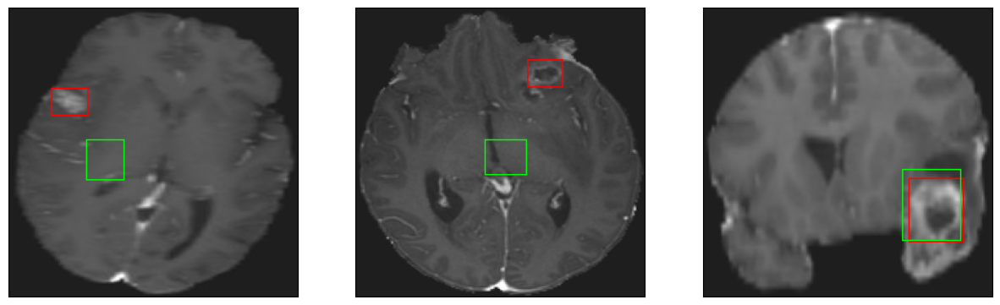

26/26 [==============================] - 3s 100ms/step - loss: 4.4696 - IoU: 0.6450 - val_loss: 8.6583 - val_IoU: 0.5515
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.4558 - IoU: 0.6393
Epoch 118: val_IoU did not improve from 0.55816
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


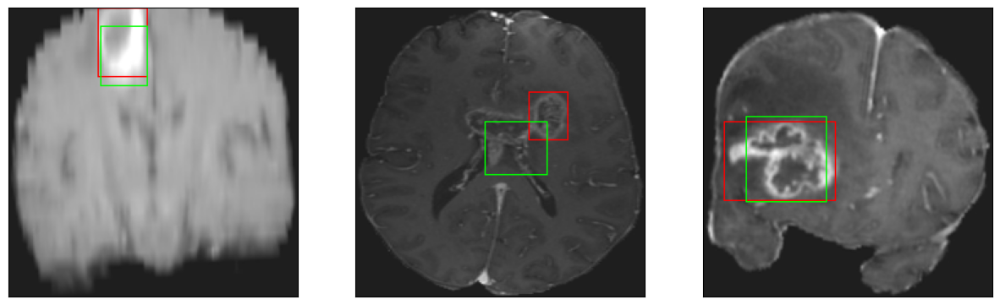

26/26 [==============================] - 3s 129ms/step - loss: 4.4558 - IoU: 0.6393 - val_loss: 8.5562 - val_IoU: 0.5537
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6568 - IoU: 0.6432
Epoch 119: val_IoU improved from 0.55816 to 0.56457, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


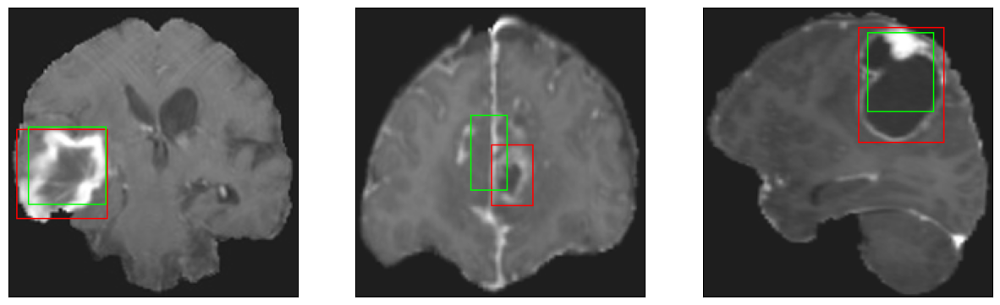

26/26 [==============================] - 3s 133ms/step - loss: 4.6152 - IoU: 0.6435 - val_loss: 8.4601 - val_IoU: 0.5646
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.7033 - IoU: 0.6346
Epoch 120: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


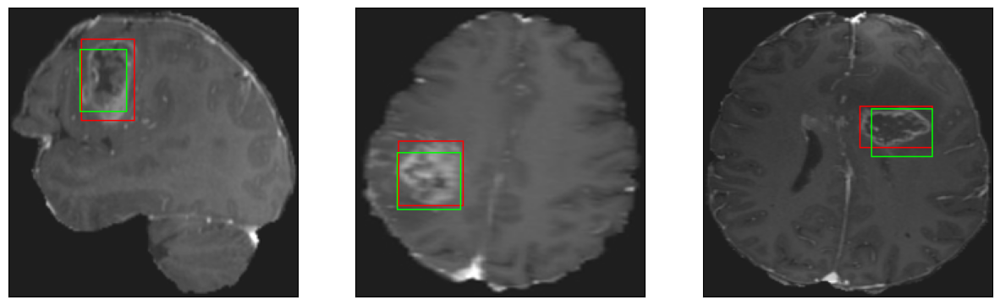

26/26 [==============================] - 2s 93ms/step - loss: 4.7033 - IoU: 0.6346 - val_loss: 8.4204 - val_IoU: 0.5627
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8023 - IoU: 0.6290
Epoch 121: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


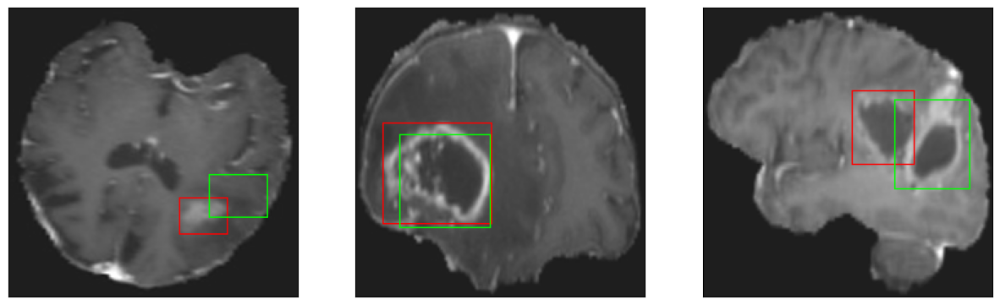

26/26 [==============================] - 3s 114ms/step - loss: 4.7732 - IoU: 0.6299 - val_loss: 9.5725 - val_IoU: 0.4832
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6236 - IoU: 0.6318
Epoch 122: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


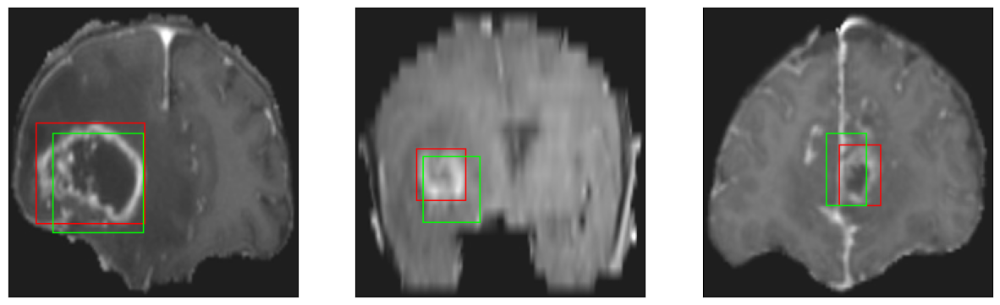

26/26 [==============================] - 3s 115ms/step - loss: 4.6413 - IoU: 0.6305 - val_loss: 9.7825 - val_IoU: 0.4556
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.6238 - IoU: 0.6311
Epoch 123: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


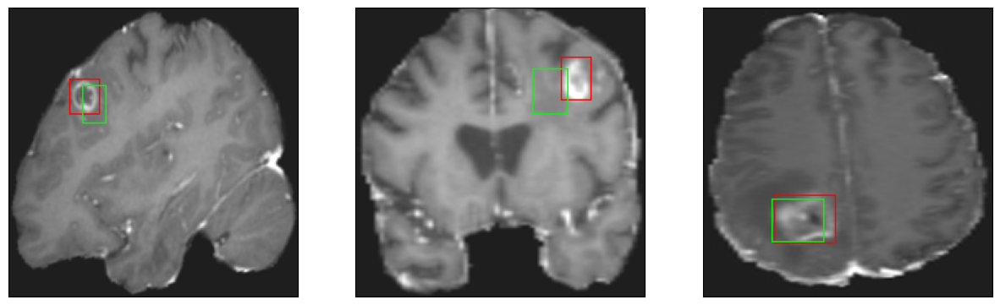

26/26 [==============================] - 3s 130ms/step - loss: 4.6238 - IoU: 0.6311 - val_loss: 10.2357 - val_IoU: 0.4770
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6577 - IoU: 0.6374
Epoch 124: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


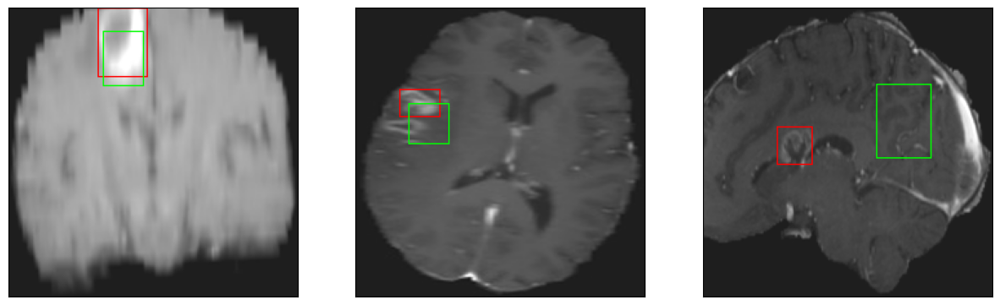

26/26 [==============================] - 3s 103ms/step - loss: 4.6613 - IoU: 0.6387 - val_loss: 9.2069 - val_IoU: 0.5109
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1996 - IoU: 0.6601
Epoch 125: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


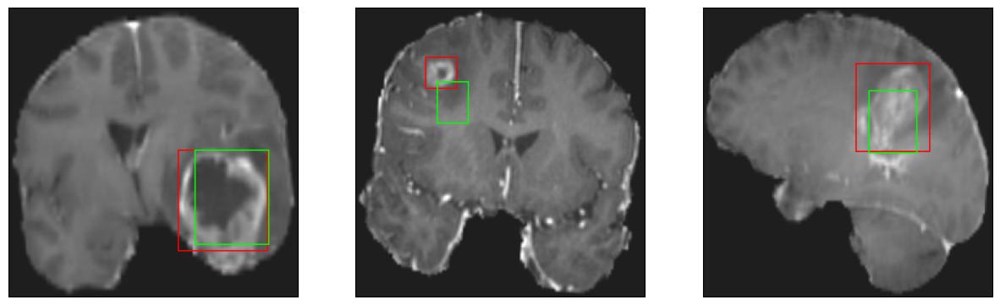

26/26 [==============================] - 3s 104ms/step - loss: 4.1642 - IoU: 0.6615 - val_loss: 8.9877 - val_IoU: 0.5312
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3849 - IoU: 0.6487
Epoch 126: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


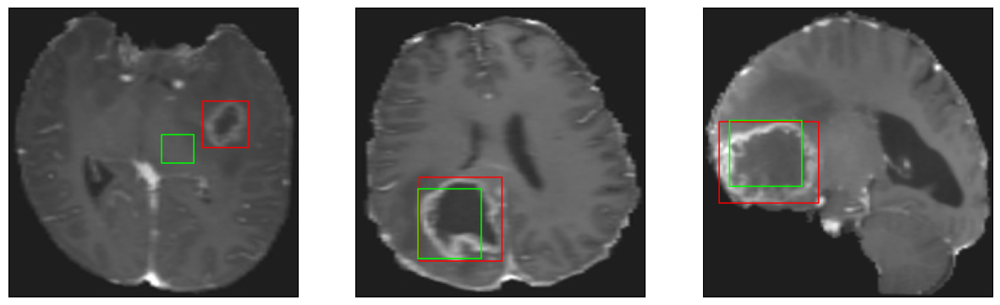

26/26 [==============================] - 3s 101ms/step - loss: 4.4304 - IoU: 0.6458 - val_loss: 10.5844 - val_IoU: 0.4702
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3485 - IoU: 0.6569
Epoch 127: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


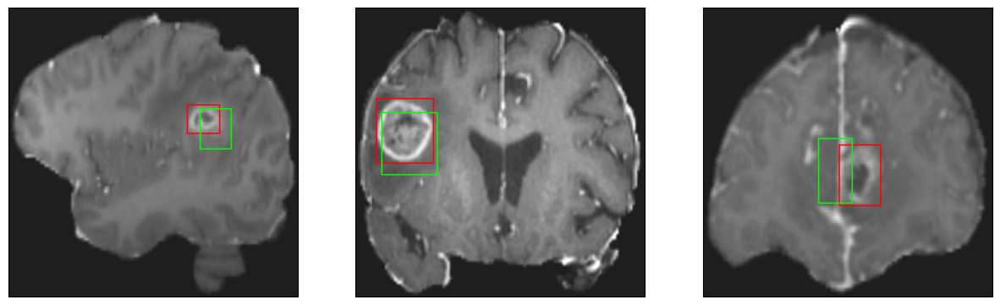

26/26 [==============================] - 3s 131ms/step - loss: 4.4004 - IoU: 0.6539 - val_loss: 10.1436 - val_IoU: 0.4480
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 4.4606 - IoU: 0.6436
Epoch 128: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


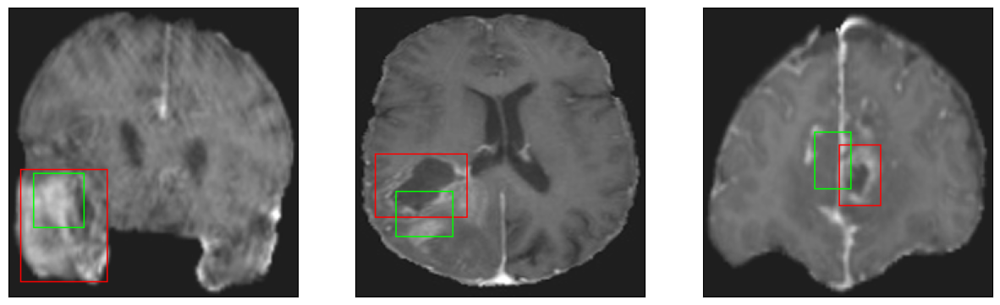

26/26 [==============================] - 3s 116ms/step - loss: 4.4606 - IoU: 0.6436 - val_loss: 9.6847 - val_IoU: 0.5062
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.5412 - IoU: 0.6337
Epoch 129: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


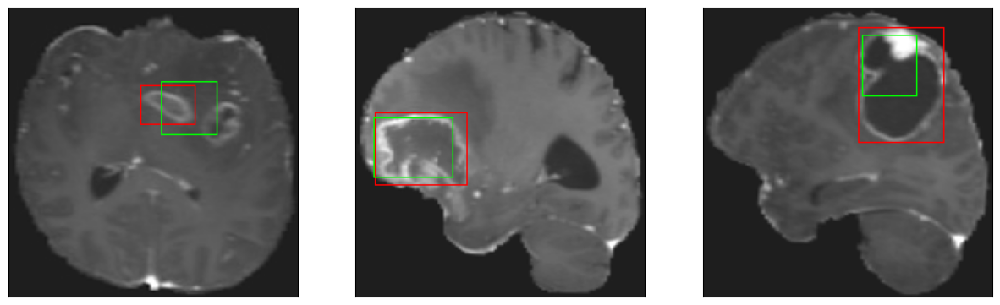

26/26 [==============================] - 3s 103ms/step - loss: 4.5412 - IoU: 0.6337 - val_loss: 10.6301 - val_IoU: 0.4736
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7314 - IoU: 0.6303
Epoch 130: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


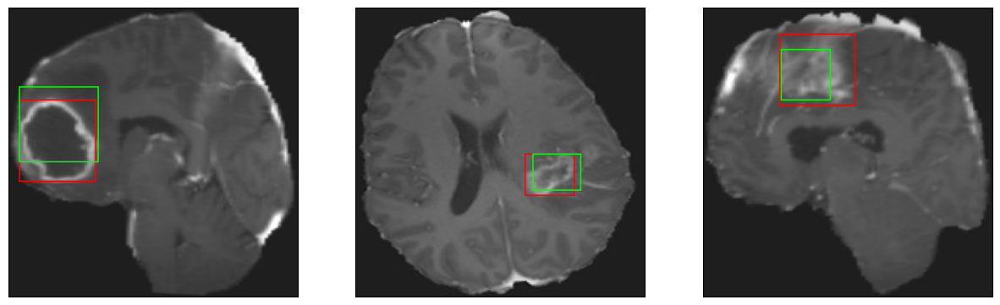

26/26 [==============================] - 3s 98ms/step - loss: 4.6684 - IoU: 0.6342 - val_loss: 9.5604 - val_IoU: 0.5116
Epoch 131/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5696 - IoU: 0.6356
Epoch 131: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


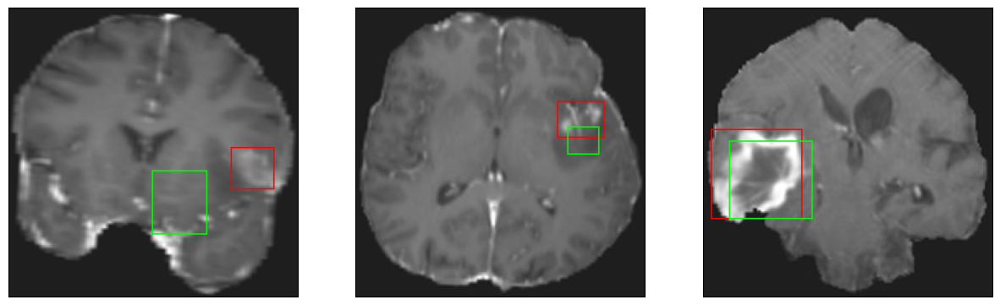

26/26 [==============================] - 3s 124ms/step - loss: 4.5899 - IoU: 0.6352 - val_loss: 9.8342 - val_IoU: 0.4718
Epoch 132/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3575 - IoU: 0.6483
Epoch 132: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


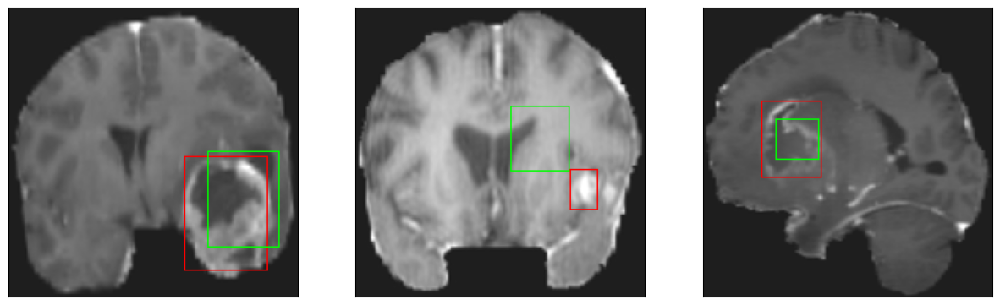

26/26 [==============================] - 3s 102ms/step - loss: 4.3330 - IoU: 0.6489 - val_loss: 8.9769 - val_IoU: 0.5359
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3301 - IoU: 0.6465
Epoch 133: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


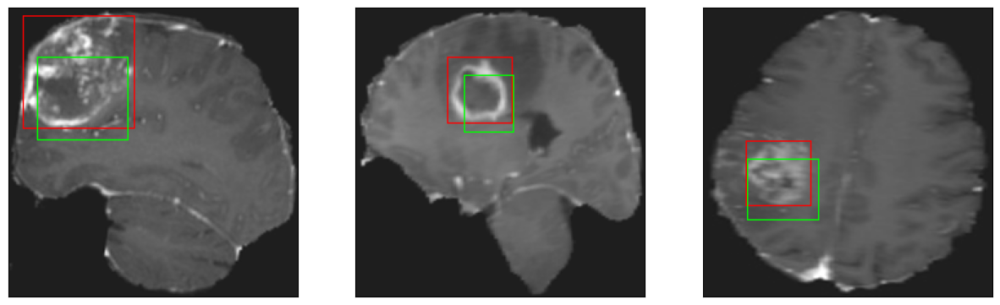

26/26 [==============================] - 3s 101ms/step - loss: 4.3821 - IoU: 0.6444 - val_loss: 10.0737 - val_IoU: 0.4615
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3386 - IoU: 0.6497
Epoch 134: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


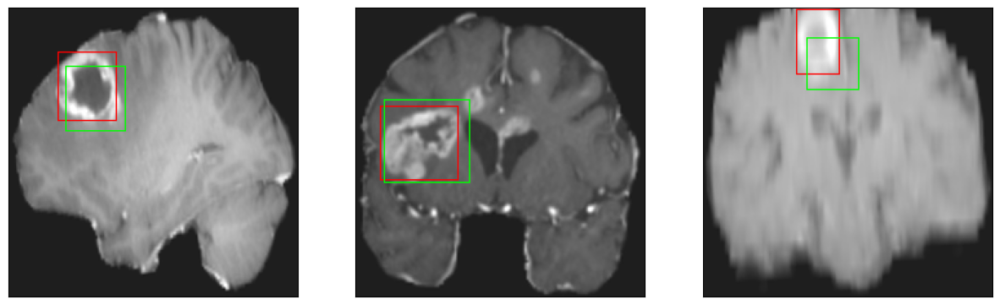

26/26 [==============================] - 3s 103ms/step - loss: 4.3023 - IoU: 0.6509 - val_loss: 9.9992 - val_IoU: 0.4637
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3999 - IoU: 0.6439
Epoch 135: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


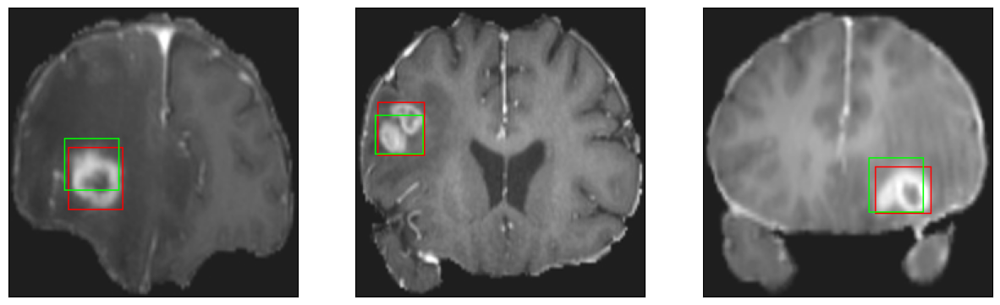

26/26 [==============================] - 3s 109ms/step - loss: 4.3857 - IoU: 0.6430 - val_loss: 9.4856 - val_IoU: 0.5040
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3389 - IoU: 0.6483
Epoch 136: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4


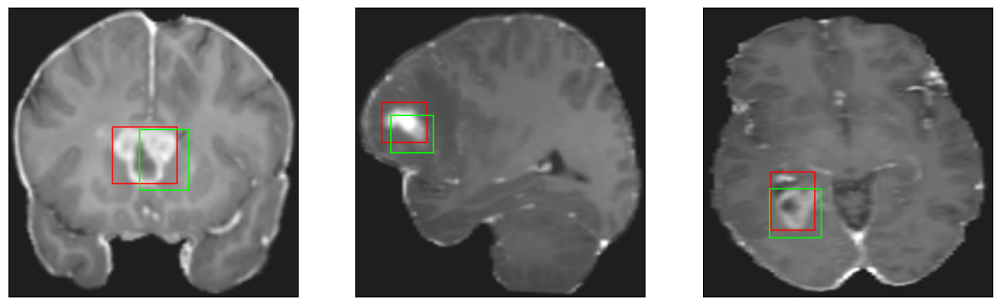

26/26 [==============================] - 3s 106ms/step - loss: 4.3728 - IoU: 0.6469 - val_loss: 9.6338 - val_IoU: 0.4958
Epoch 137/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4866 - IoU: 0.6428
Epoch 137: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


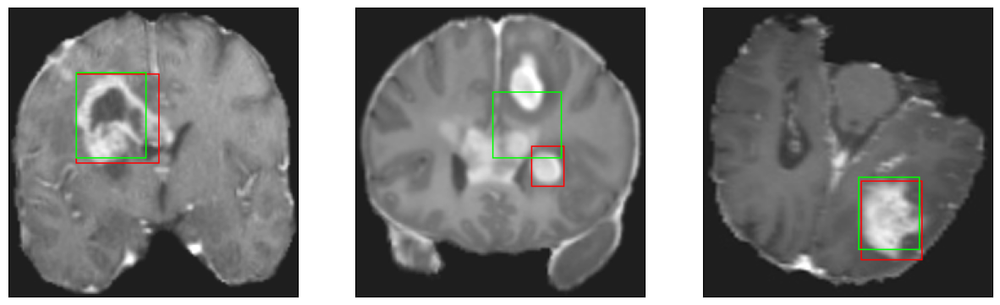

26/26 [==============================] - 3s 103ms/step - loss: 4.4990 - IoU: 0.6431 - val_loss: 8.7089 - val_IoU: 0.5425
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 4.4294 - IoU: 0.6431
Epoch 138: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


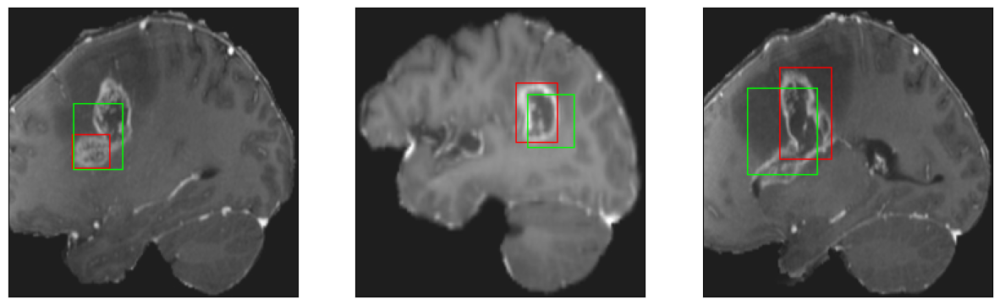

26/26 [==============================] - 3s 124ms/step - loss: 4.4294 - IoU: 0.6431 - val_loss: 10.0136 - val_IoU: 0.4538
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2512 - IoU: 0.6537
Epoch 139: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


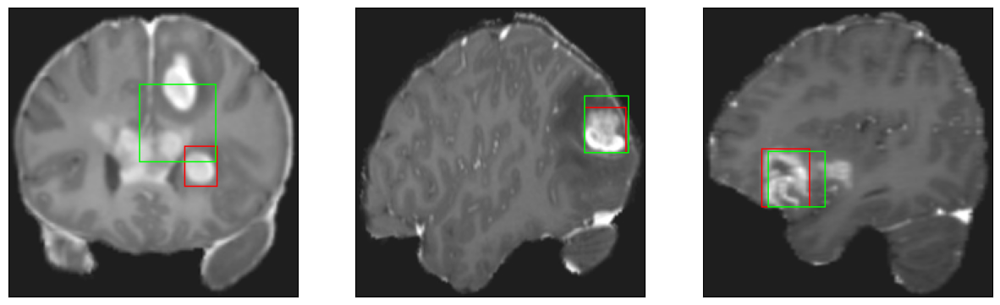

26/26 [==============================] - 3s 129ms/step - loss: 4.2548 - IoU: 0.6534 - val_loss: 8.6193 - val_IoU: 0.5458
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4681 - IoU: 0.6397
Epoch 140: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


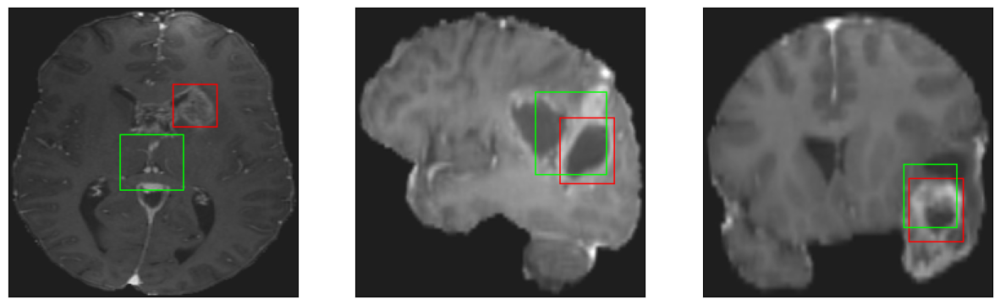

26/26 [==============================] - 3s 110ms/step - loss: 4.4639 - IoU: 0.6396 - val_loss: 8.5494 - val_IoU: 0.5492
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3515 - IoU: 0.6516
Epoch 141: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


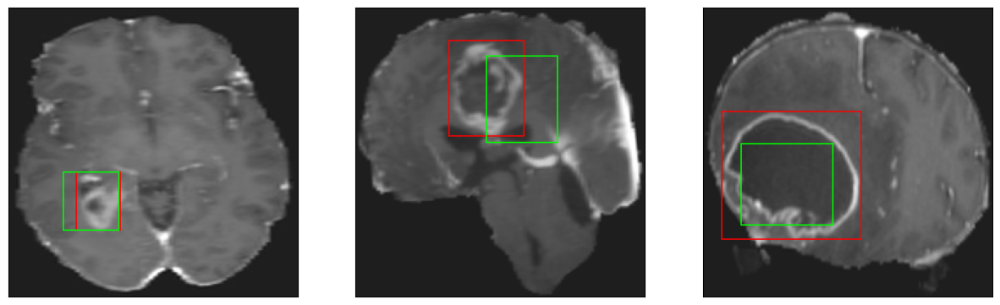

26/26 [==============================] - 3s 119ms/step - loss: 4.3595 - IoU: 0.6539 - val_loss: 8.7700 - val_IoU: 0.5311
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.4606 - IoU: 0.6484
Epoch 142: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


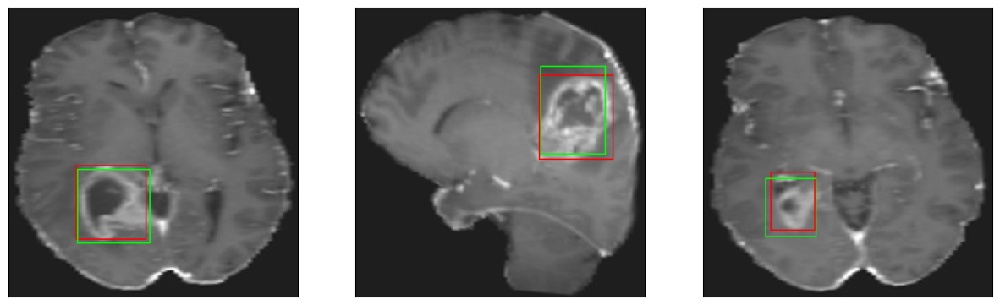

26/26 [==============================] - 3s 99ms/step - loss: 4.4606 - IoU: 0.6484 - val_loss: 8.4349 - val_IoU: 0.5542
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4025 - IoU: 0.6413
Epoch 143: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


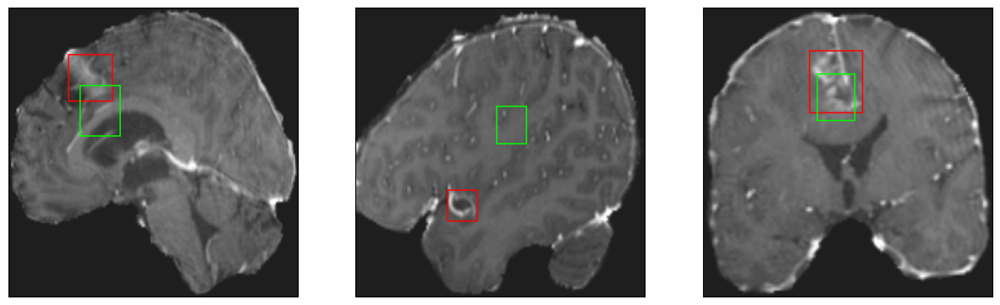

26/26 [==============================] - 3s 112ms/step - loss: 4.4067 - IoU: 0.6399 - val_loss: 9.6093 - val_IoU: 0.4818
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7987 - IoU: 0.6247
Epoch 144: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


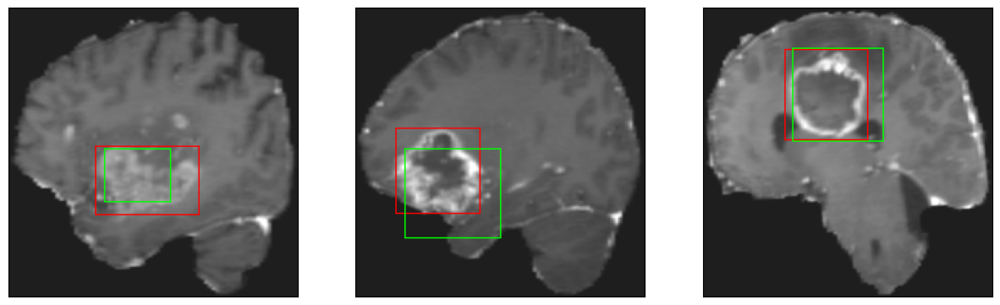

26/26 [==============================] - 3s 101ms/step - loss: 4.8169 - IoU: 0.6234 - val_loss: 9.5751 - val_IoU: 0.4798
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3765 - IoU: 0.6455
Epoch 145: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


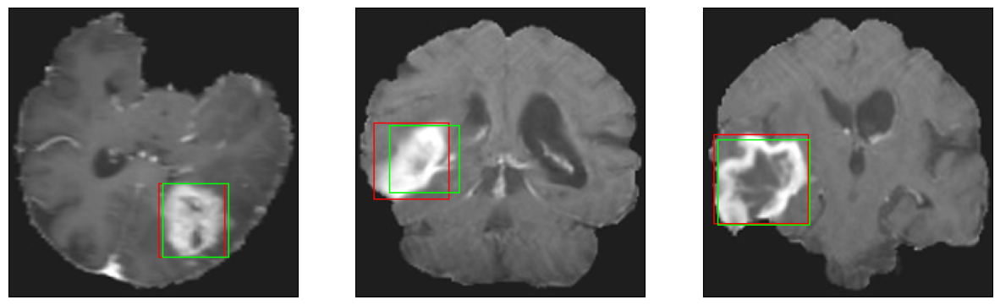

26/26 [==============================] - 3s 110ms/step - loss: 4.3591 - IoU: 0.6463 - val_loss: 8.6789 - val_IoU: 0.5508
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3691 - IoU: 0.6510
Epoch 146: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


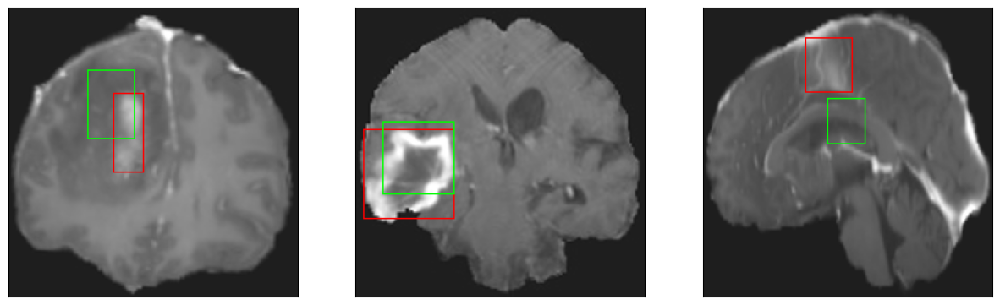

26/26 [==============================] - 3s 125ms/step - loss: 4.3673 - IoU: 0.6516 - val_loss: 10.3315 - val_IoU: 0.4574
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.3738 - IoU: 0.6527
Epoch 147: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


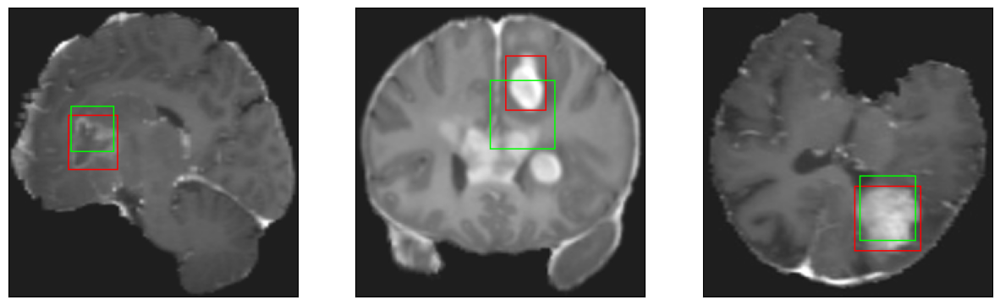

26/26 [==============================] - 3s 131ms/step - loss: 4.3738 - IoU: 0.6527 - val_loss: 8.7117 - val_IoU: 0.5499
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3675 - IoU: 0.6556
Epoch 148: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


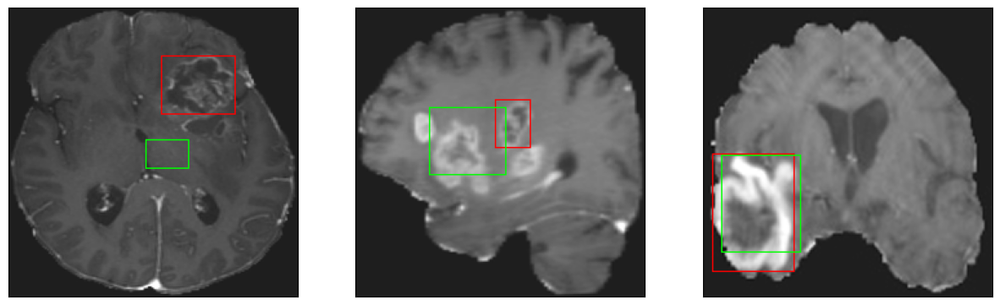

26/26 [==============================] - 3s 110ms/step - loss: 4.3600 - IoU: 0.6549 - val_loss: 8.8855 - val_IoU: 0.5332
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.5425 - IoU: 0.6359
Epoch 149: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


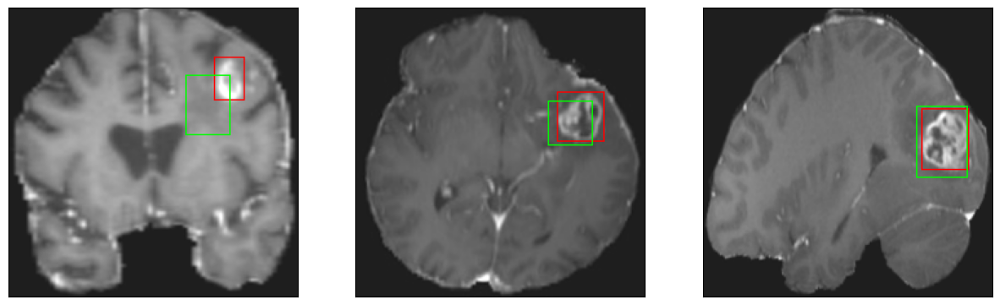

26/26 [==============================] - 3s 102ms/step - loss: 4.5425 - IoU: 0.6359 - val_loss: 8.9859 - val_IoU: 0.5178
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 4.4654 - IoU: 0.6356
Epoch 150: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


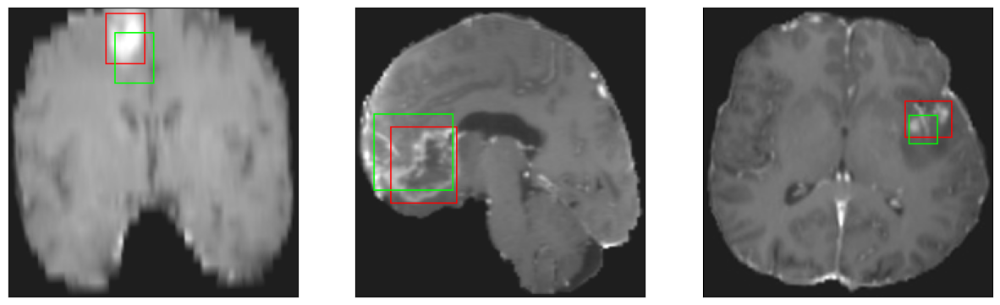

26/26 [==============================] - 3s 112ms/step - loss: 4.4654 - IoU: 0.6356 - val_loss: 8.6858 - val_IoU: 0.5499
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2868 - IoU: 0.6423
Epoch 151: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


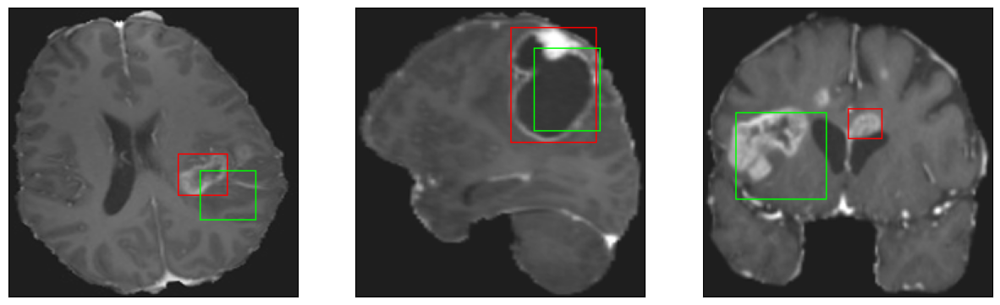

26/26 [==============================] - 3s 111ms/step - loss: 4.3259 - IoU: 0.6416 - val_loss: 12.5551 - val_IoU: 0.3539
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2406 - IoU: 0.6530
Epoch 152: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


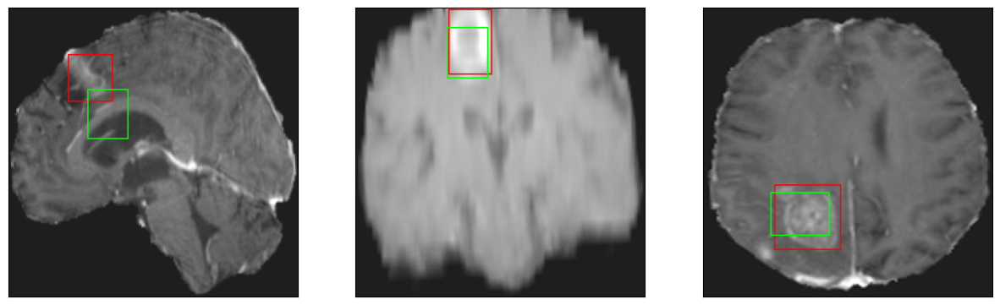

26/26 [==============================] - 3s 104ms/step - loss: 4.2152 - IoU: 0.6525 - val_loss: 9.3248 - val_IoU: 0.5012
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.2023 - IoU: 0.6608
Epoch 153: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


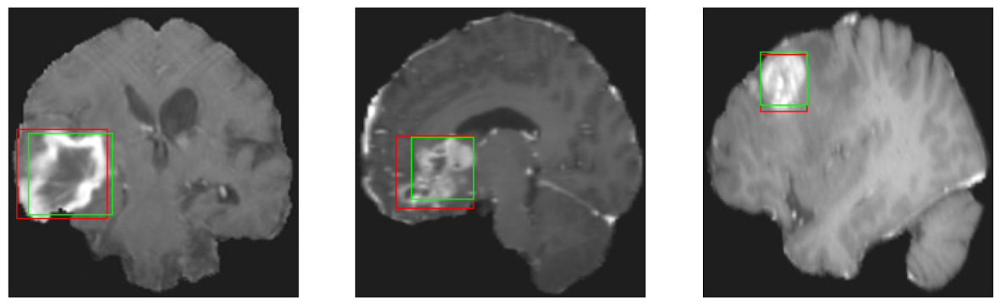

26/26 [==============================] - 3s 105ms/step - loss: 4.2023 - IoU: 0.6608 - val_loss: 8.4810 - val_IoU: 0.5641
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.3129 - IoU: 0.6464
Epoch 154: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4


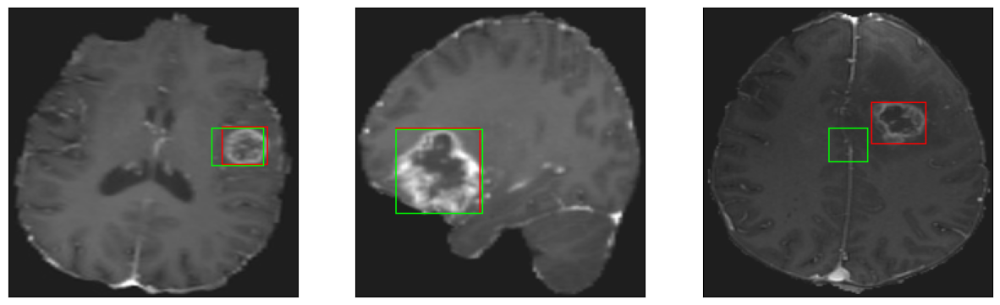

26/26 [==============================] - 3s 116ms/step - loss: 4.3129 - IoU: 0.6464 - val_loss: 9.2450 - val_IoU: 0.5215
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4625 - IoU: 0.6452
Epoch 155: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


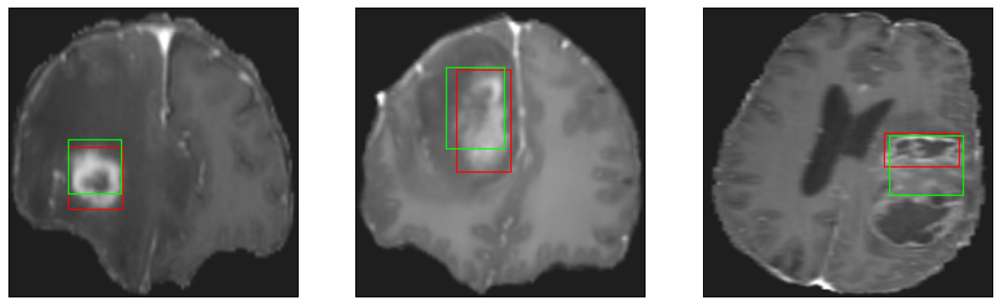

26/26 [==============================] - 3s 103ms/step - loss: 4.4497 - IoU: 0.6443 - val_loss: 8.8669 - val_IoU: 0.5337
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2440 - IoU: 0.6538
Epoch 156: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


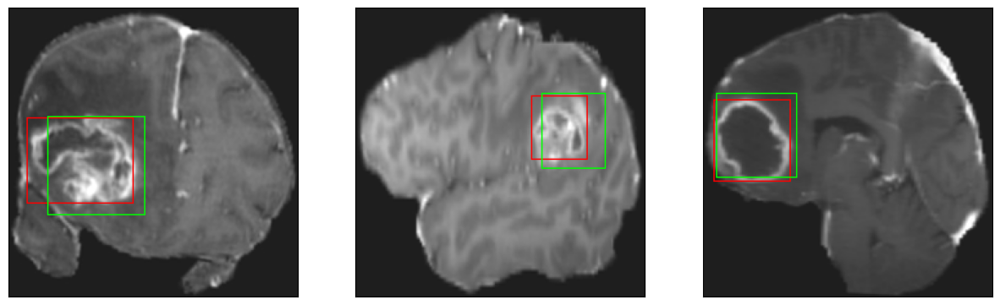

26/26 [==============================] - 3s 104ms/step - loss: 4.2523 - IoU: 0.6550 - val_loss: 9.1436 - val_IoU: 0.5042
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.3524 - IoU: 0.6541
Epoch 157: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


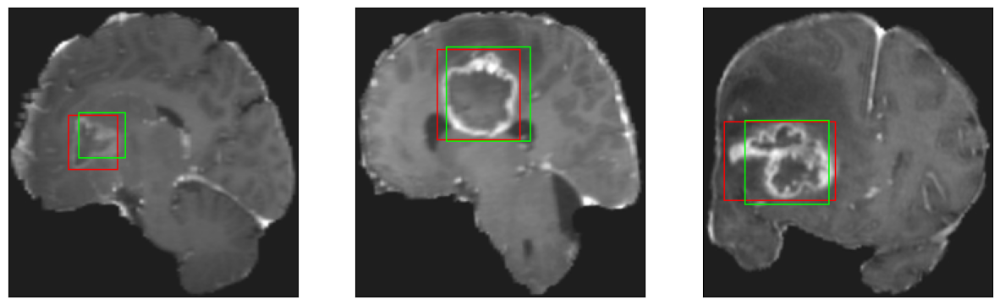

26/26 [==============================] - 3s 109ms/step - loss: 4.3524 - IoU: 0.6541 - val_loss: 8.7578 - val_IoU: 0.5322
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4615 - IoU: 0.6440
Epoch 158: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


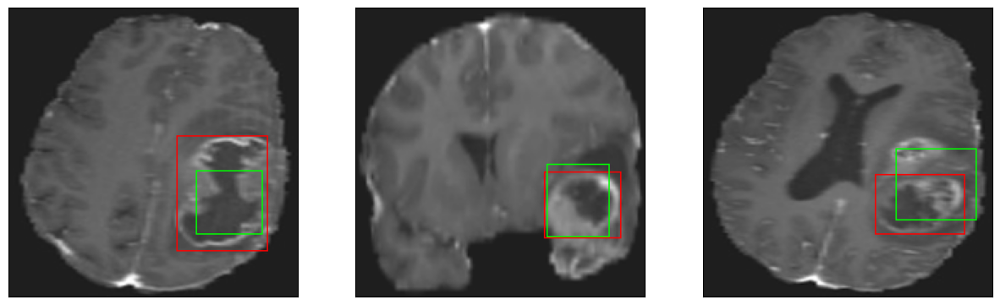

26/26 [==============================] - 3s 113ms/step - loss: 4.4541 - IoU: 0.6434 - val_loss: 8.5921 - val_IoU: 0.5482
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 4.3953 - IoU: 0.6414
Epoch 159: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


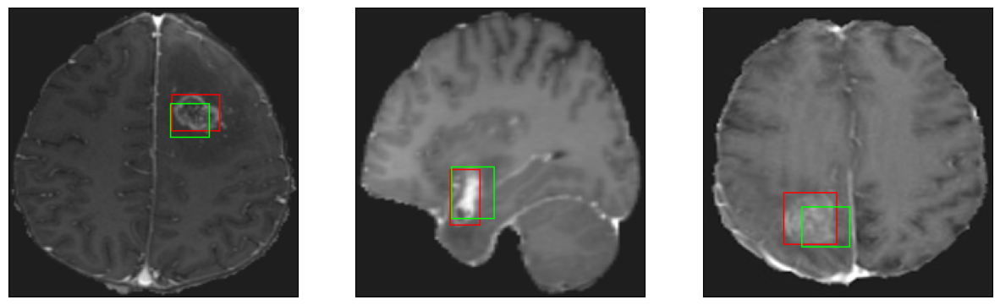

26/26 [==============================] - 3s 101ms/step - loss: 4.3953 - IoU: 0.6414 - val_loss: 8.6024 - val_IoU: 0.5554
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1920 - IoU: 0.6560
Epoch 160: val_IoU did not improve from 0.56457
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


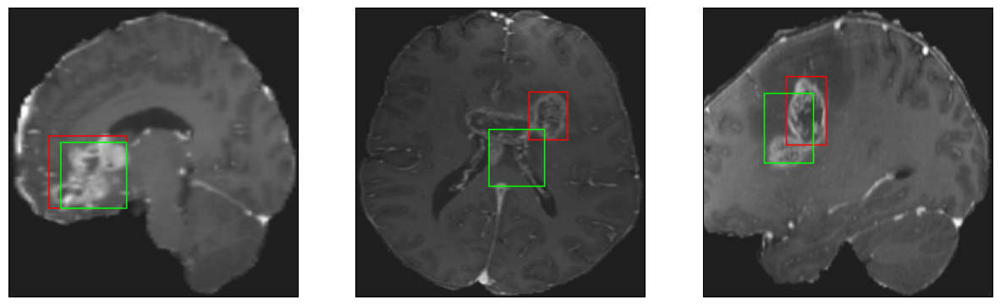

26/26 [==============================] - 3s 103ms/step - loss: 4.1935 - IoU: 0.6569 - val_loss: 9.4595 - val_IoU: 0.5084
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 4.3331 - IoU: 0.6473
Epoch 161: val_IoU improved from 0.56457 to 0.56889, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


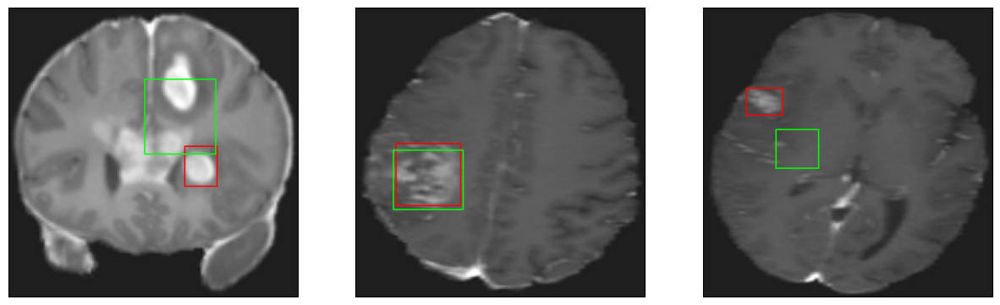

26/26 [==============================] - 4s 162ms/step - loss: 4.3331 - IoU: 0.6473 - val_loss: 8.3323 - val_IoU: 0.5689
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2832 - IoU: 0.6609
Epoch 162: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


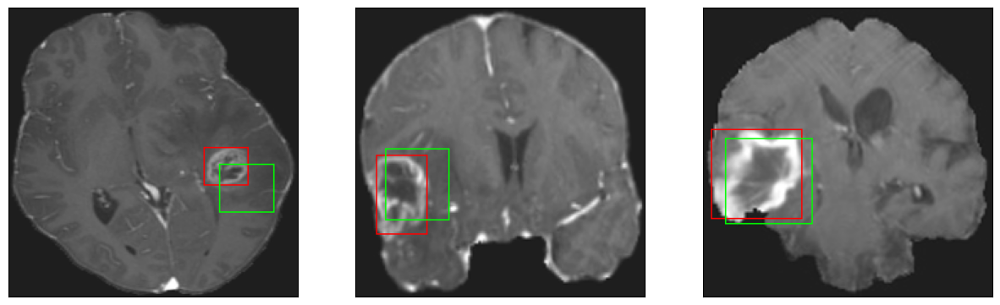

26/26 [==============================] - 3s 127ms/step - loss: 4.2897 - IoU: 0.6577 - val_loss: 9.6065 - val_IoU: 0.4975
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2705 - IoU: 0.6532
Epoch 163: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


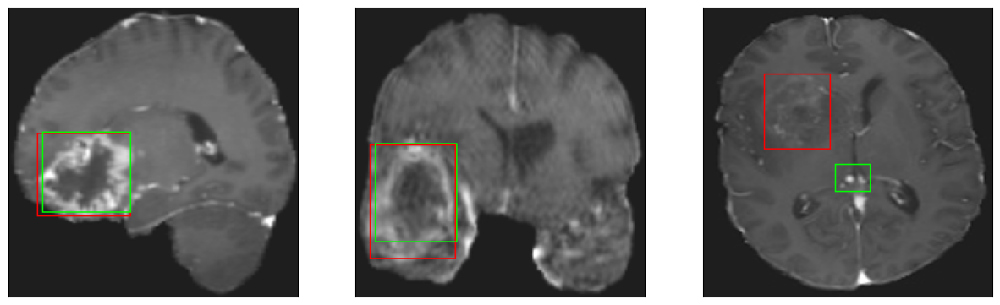

26/26 [==============================] - 3s 121ms/step - loss: 4.2471 - IoU: 0.6526 - val_loss: 8.3750 - val_IoU: 0.5642
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.2137 - IoU: 0.6610
Epoch 164: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


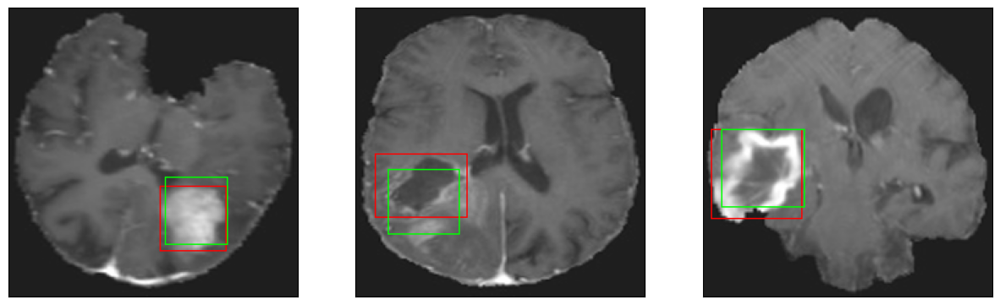

26/26 [==============================] - 3s 115ms/step - loss: 4.2137 - IoU: 0.6610 - val_loss: 8.4210 - val_IoU: 0.5565
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 4.2549 - IoU: 0.6625
Epoch 165: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


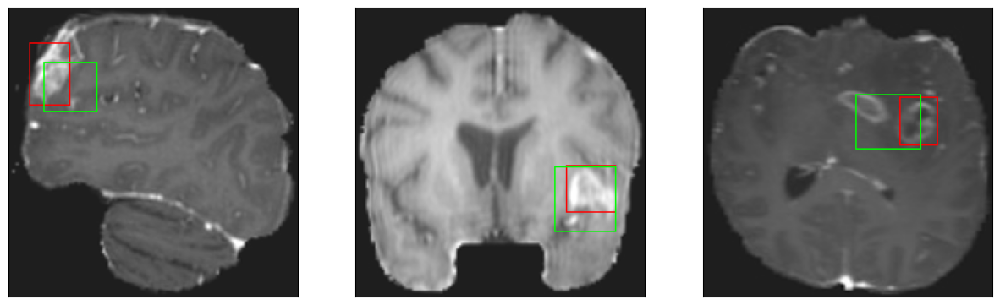

26/26 [==============================] - 3s 108ms/step - loss: 4.2549 - IoU: 0.6625 - val_loss: 8.7407 - val_IoU: 0.5386
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 4.2400 - IoU: 0.6527
Epoch 166: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


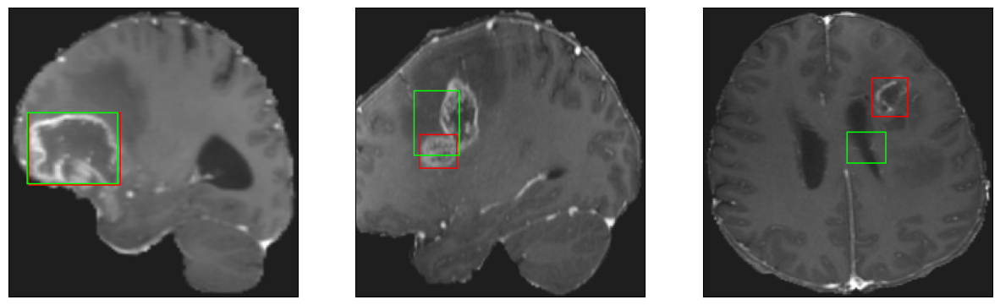

26/26 [==============================] - 3s 119ms/step - loss: 4.2400 - IoU: 0.6527 - val_loss: 8.5014 - val_IoU: 0.5493
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1725 - IoU: 0.6555
Epoch 167: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


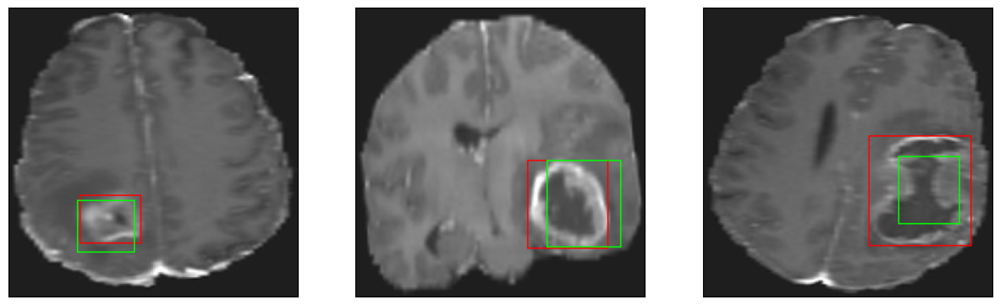

26/26 [==============================] - 3s 97ms/step - loss: 4.2052 - IoU: 0.6537 - val_loss: 8.4239 - val_IoU: 0.5653
Epoch 168/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4067 - IoU: 0.6539
Epoch 168: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


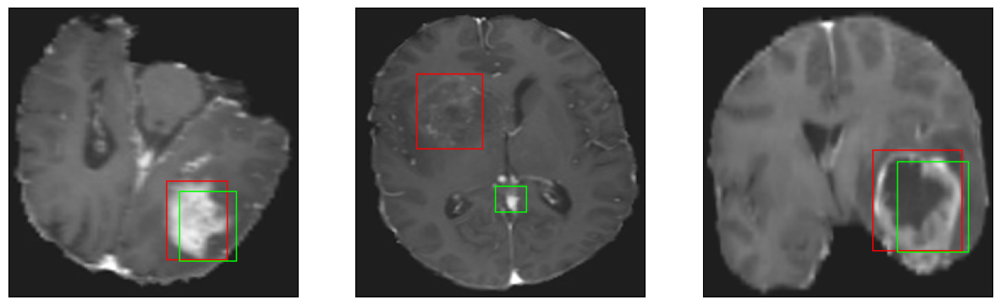

26/26 [==============================] - 2s 93ms/step - loss: 4.4150 - IoU: 0.6523 - val_loss: 10.1744 - val_IoU: 0.4480
Epoch 169/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2515 - IoU: 0.6630
Epoch 169: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


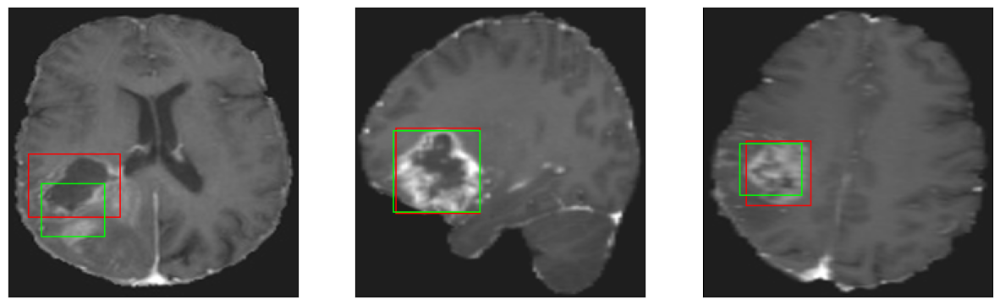

26/26 [==============================] - 3s 99ms/step - loss: 4.2215 - IoU: 0.6637 - val_loss: 9.3072 - val_IoU: 0.5041
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.2143 - IoU: 0.6533
Epoch 170: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


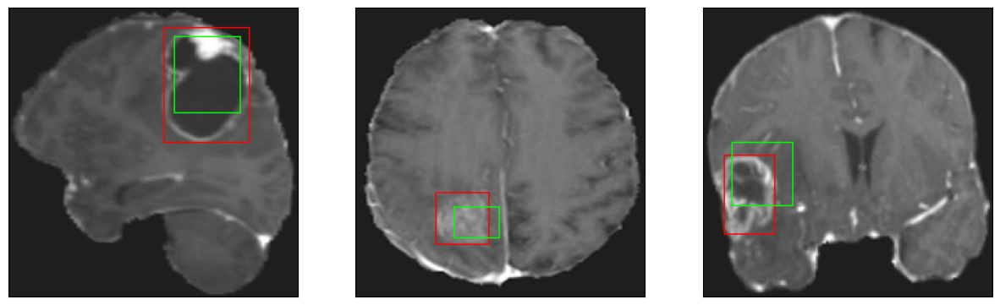

26/26 [==============================] - 3s 134ms/step - loss: 4.2143 - IoU: 0.6533 - val_loss: 8.4868 - val_IoU: 0.5563
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3403 - IoU: 0.6505
Epoch 171: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


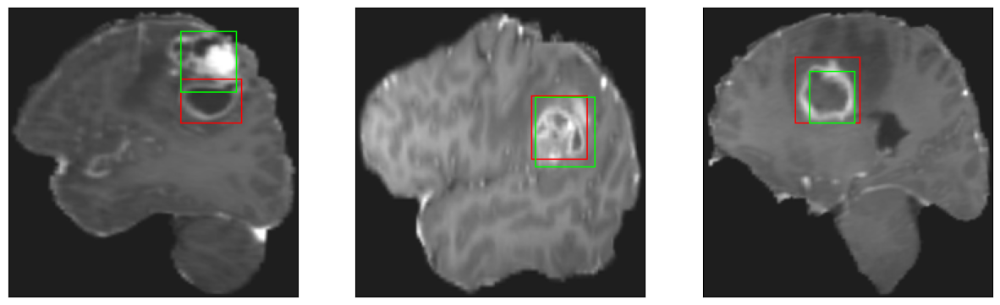

26/26 [==============================] - 3s 100ms/step - loss: 4.3830 - IoU: 0.6497 - val_loss: 9.0264 - val_IoU: 0.5169
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1291 - IoU: 0.6668
Epoch 172: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


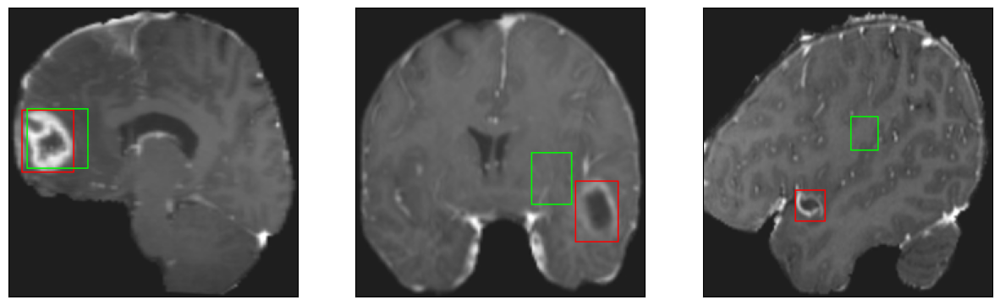

26/26 [==============================] - 3s 100ms/step - loss: 4.1162 - IoU: 0.6667 - val_loss: 8.4678 - val_IoU: 0.5527
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1273 - IoU: 0.6544
Epoch 173: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


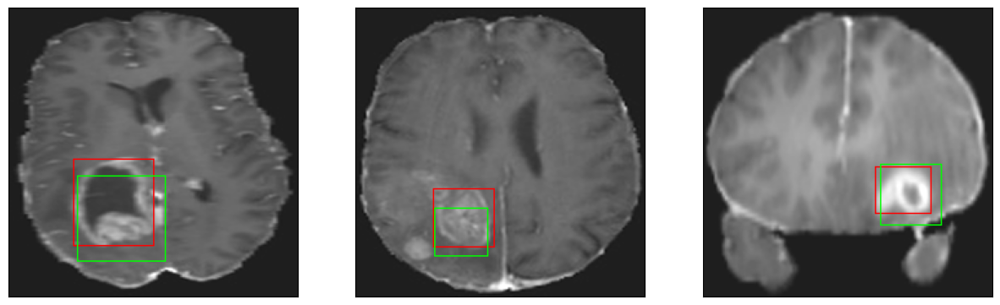

26/26 [==============================] - 3s 131ms/step - loss: 4.1257 - IoU: 0.6560 - val_loss: 8.6040 - val_IoU: 0.5375
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2104 - IoU: 0.6525
Epoch 174: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


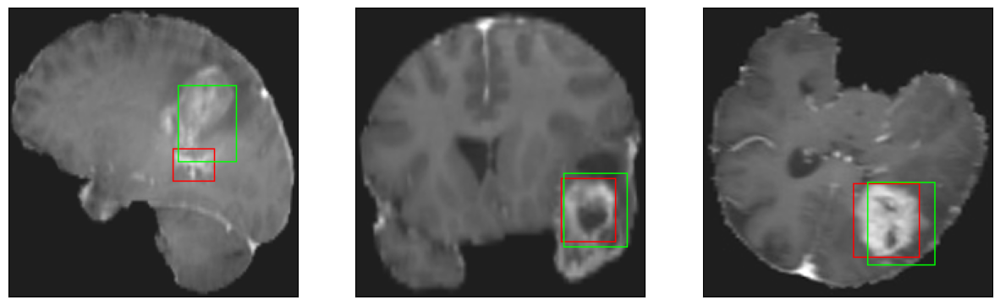

26/26 [==============================] - 3s 105ms/step - loss: 4.2511 - IoU: 0.6487 - val_loss: 9.4112 - val_IoU: 0.5072
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0831 - IoU: 0.6700
Epoch 175: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


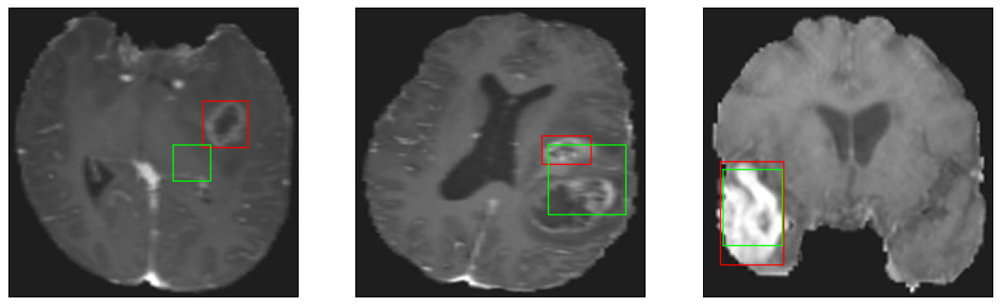

26/26 [==============================] - 3s 113ms/step - loss: 4.0933 - IoU: 0.6694 - val_loss: 8.7369 - val_IoU: 0.5422
Epoch 176/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2039 - IoU: 0.6541
Epoch 176: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


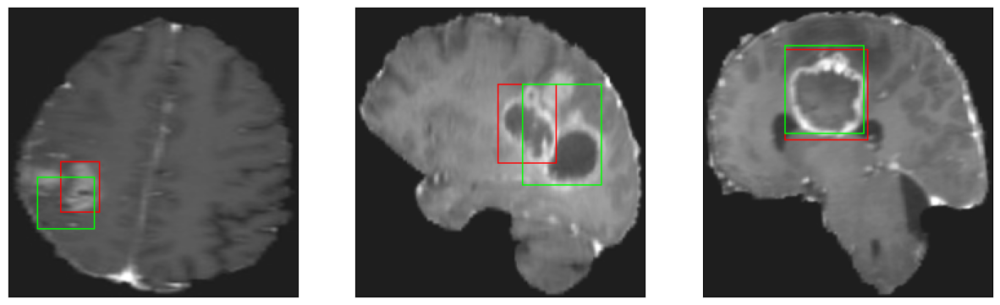

26/26 [==============================] - 3s 110ms/step - loss: 4.2157 - IoU: 0.6539 - val_loss: 8.6200 - val_IoU: 0.5492
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.0731 - IoU: 0.6620
Epoch 177: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


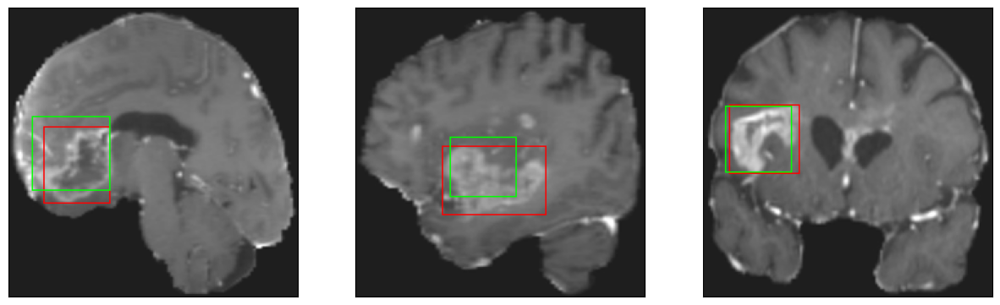

26/26 [==============================] - 3s 129ms/step - loss: 4.0731 - IoU: 0.6620 - val_loss: 8.4266 - val_IoU: 0.5511
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1469 - IoU: 0.6601
Epoch 178: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


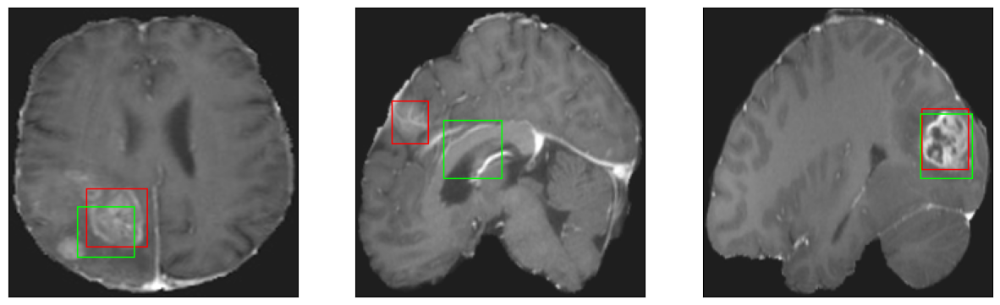

26/26 [==============================] - 3s 109ms/step - loss: 4.1671 - IoU: 0.6605 - val_loss: 8.6404 - val_IoU: 0.5432
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4110 - IoU: 0.6531
Epoch 179: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


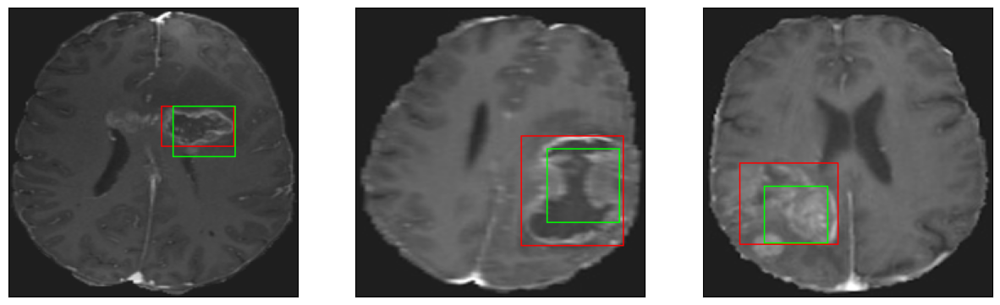

26/26 [==============================] - 3s 110ms/step - loss: 4.3695 - IoU: 0.6548 - val_loss: 8.4306 - val_IoU: 0.5549
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1370 - IoU: 0.6632
Epoch 180: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


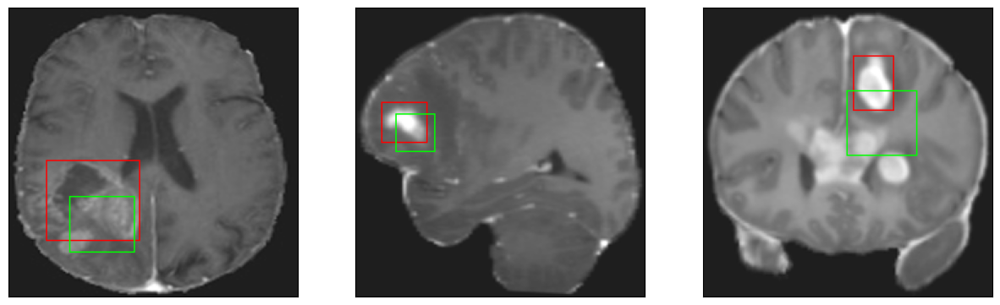

26/26 [==============================] - 3s 111ms/step - loss: 4.1027 - IoU: 0.6640 - val_loss: 9.2839 - val_IoU: 0.4939
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1116 - IoU: 0.6615
Epoch 181: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4


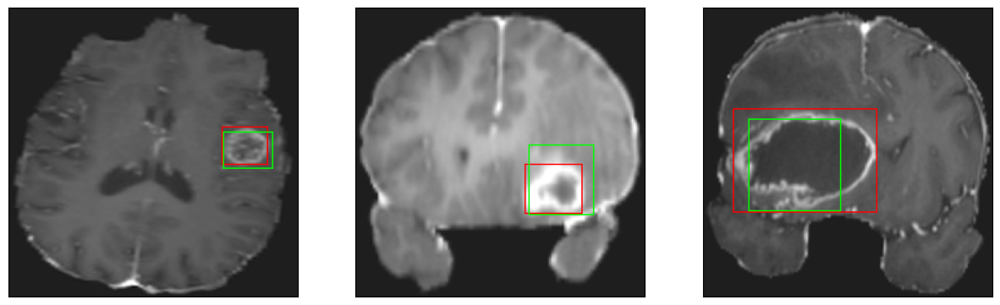

26/26 [==============================] - 4s 141ms/step - loss: 4.0963 - IoU: 0.6623 - val_loss: 8.6815 - val_IoU: 0.5519
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 3.9785 - IoU: 0.6675
Epoch 182: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


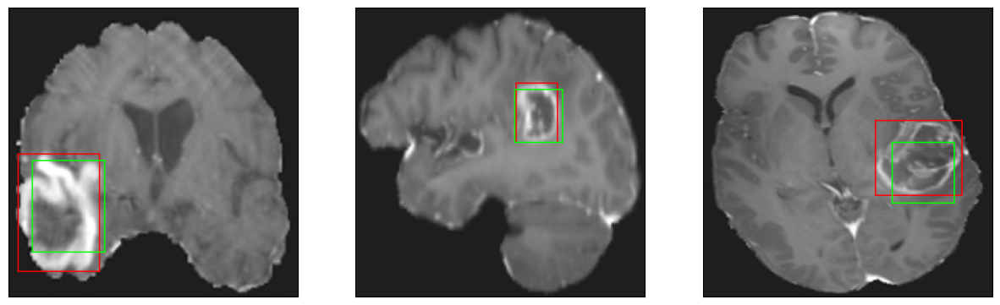

26/26 [==============================] - 3s 108ms/step - loss: 3.9785 - IoU: 0.6675 - val_loss: 8.6608 - val_IoU: 0.5378
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 4.0897 - IoU: 0.6629
Epoch 183: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


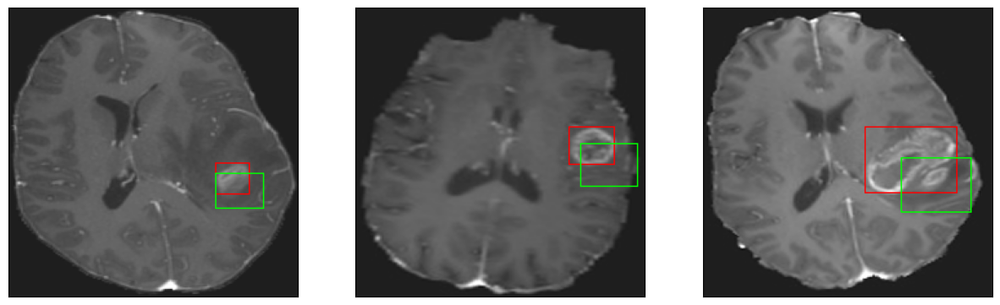

26/26 [==============================] - 3s 102ms/step - loss: 4.0897 - IoU: 0.6629 - val_loss: 10.3178 - val_IoU: 0.4342
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.1868 - IoU: 0.6584
Epoch 184: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


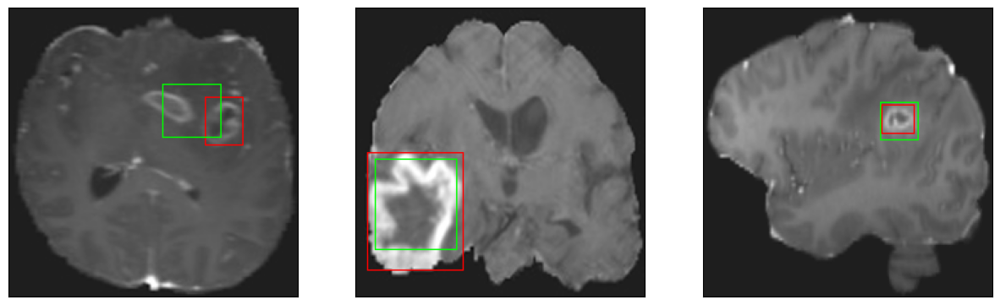

26/26 [==============================] - 3s 108ms/step - loss: 4.1868 - IoU: 0.6584 - val_loss: 8.9564 - val_IoU: 0.5407
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 4.1011 - IoU: 0.6649
Epoch 185: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


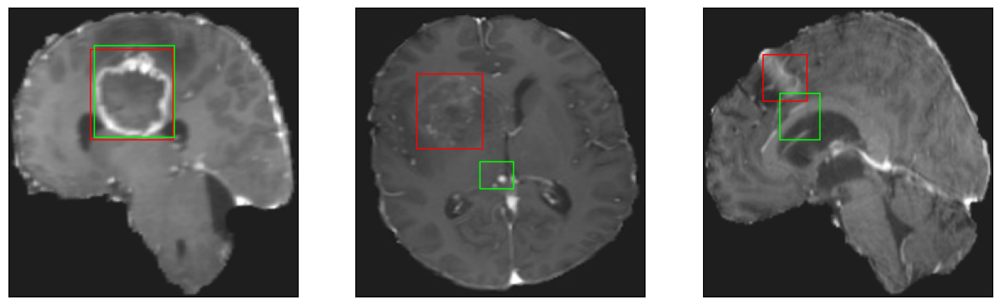

26/26 [==============================] - 3s 121ms/step - loss: 4.1011 - IoU: 0.6649 - val_loss: 8.4150 - val_IoU: 0.5647
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1949 - IoU: 0.6535
Epoch 186: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


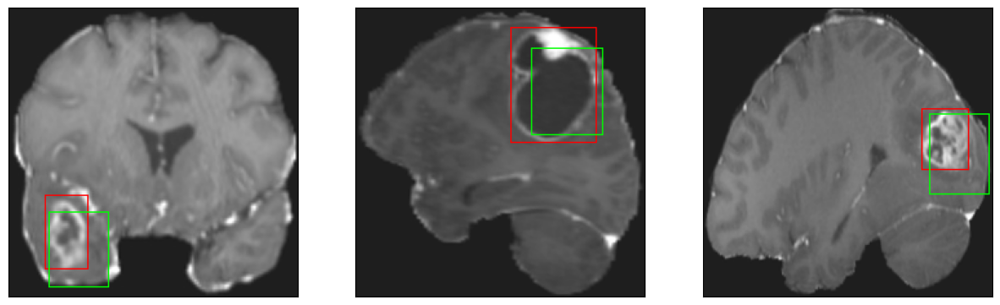

26/26 [==============================] - 2s 95ms/step - loss: 4.2355 - IoU: 0.6518 - val_loss: 11.3393 - val_IoU: 0.4012
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5935 - IoU: 0.6266
Epoch 187: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


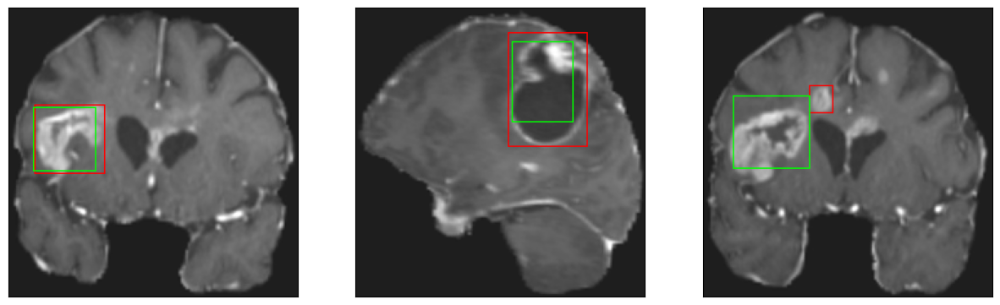

26/26 [==============================] - 3s 103ms/step - loss: 4.5963 - IoU: 0.6257 - val_loss: 8.3950 - val_IoU: 0.5651
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5052 - IoU: 0.6422
Epoch 188: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


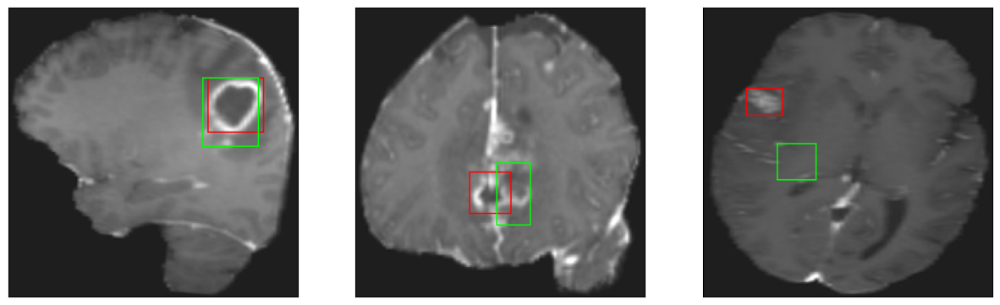

26/26 [==============================] - 3s 109ms/step - loss: 4.4888 - IoU: 0.6443 - val_loss: 9.5448 - val_IoU: 0.4801
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8026 - IoU: 0.6214
Epoch 189: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


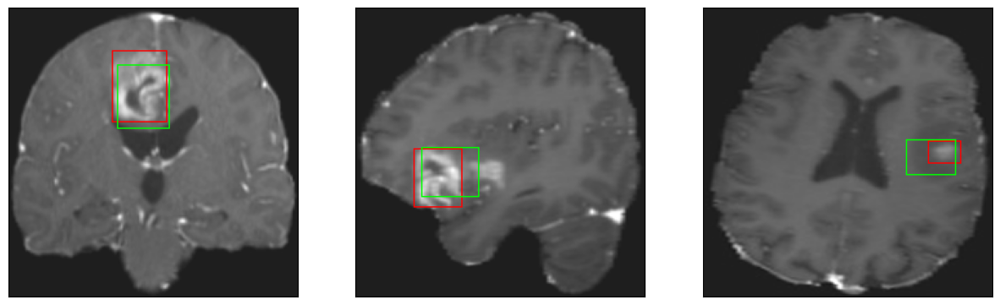

26/26 [==============================] - 3s 133ms/step - loss: 4.8003 - IoU: 0.6224 - val_loss: 8.5798 - val_IoU: 0.5497
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 4.1390 - IoU: 0.6599
Epoch 190: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


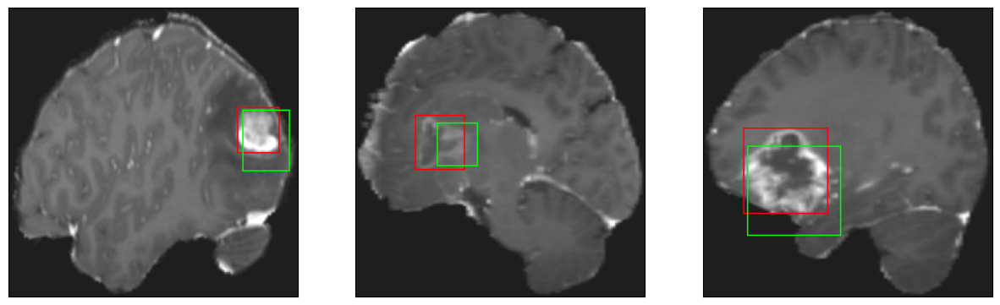

26/26 [==============================] - 3s 109ms/step - loss: 4.1390 - IoU: 0.6599 - val_loss: 10.3213 - val_IoU: 0.4349
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1608 - IoU: 0.6680
Epoch 191: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


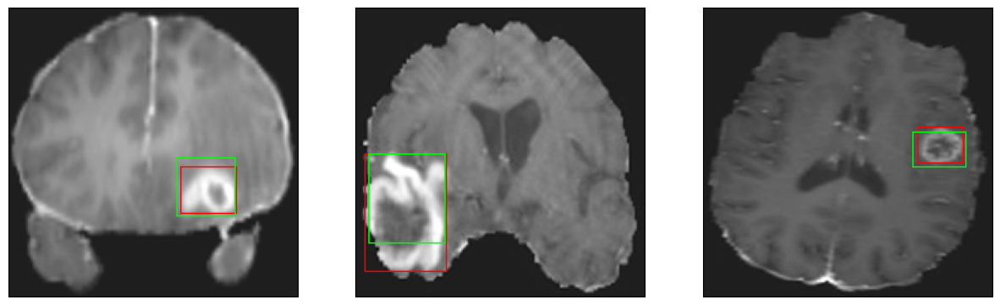

26/26 [==============================] - 3s 102ms/step - loss: 4.1175 - IoU: 0.6693 - val_loss: 9.1259 - val_IoU: 0.5225
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1730 - IoU: 0.6572
Epoch 192: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


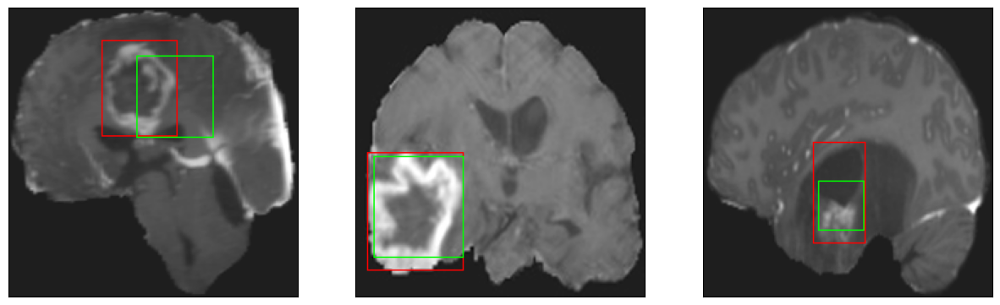

26/26 [==============================] - 3s 102ms/step - loss: 4.1831 - IoU: 0.6561 - val_loss: 8.2381 - val_IoU: 0.5670
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 4.0541 - IoU: 0.6603
Epoch 193: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


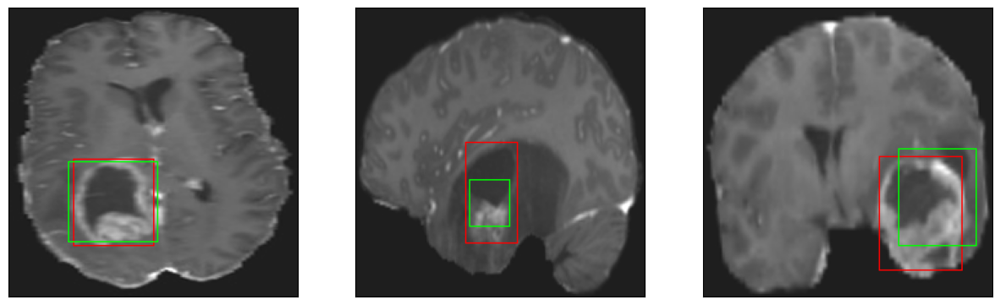

26/26 [==============================] - 3s 104ms/step - loss: 4.0541 - IoU: 0.6603 - val_loss: 8.5203 - val_IoU: 0.5455
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2564 - IoU: 0.6524
Epoch 194: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


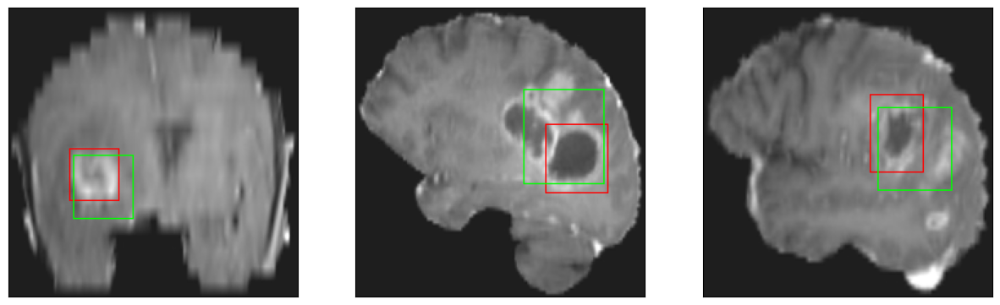

26/26 [==============================] - 3s 131ms/step - loss: 4.2298 - IoU: 0.6531 - val_loss: 8.2785 - val_IoU: 0.5659
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1654 - IoU: 0.6647
Epoch 195: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


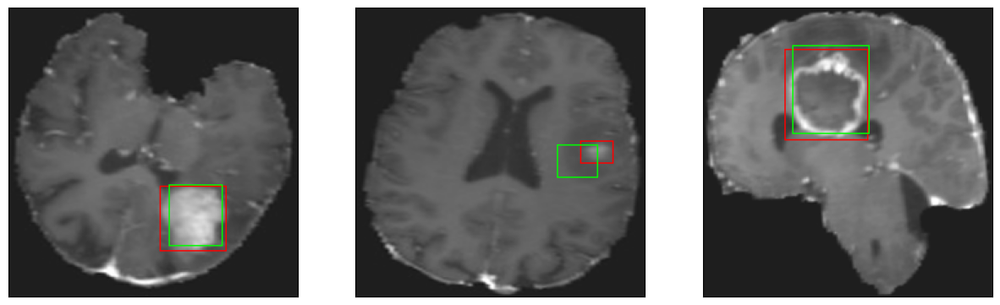

26/26 [==============================] - 3s 123ms/step - loss: 4.1422 - IoU: 0.6644 - val_loss: 8.4934 - val_IoU: 0.5431
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2154 - IoU: 0.6485
Epoch 196: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


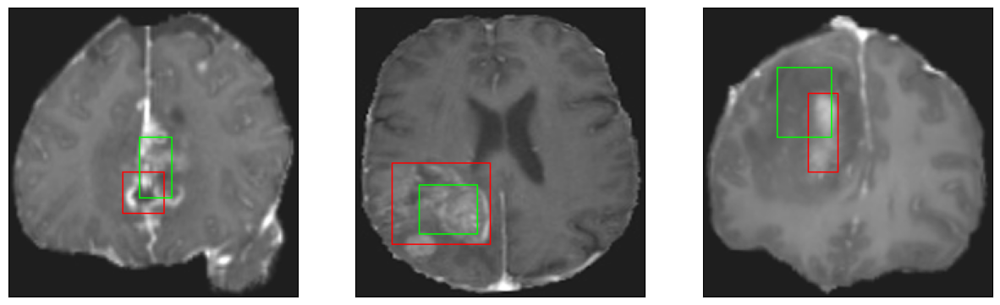

26/26 [==============================] - 3s 111ms/step - loss: 4.2427 - IoU: 0.6479 - val_loss: 9.6858 - val_IoU: 0.4927
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1696 - IoU: 0.6581
Epoch 197: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


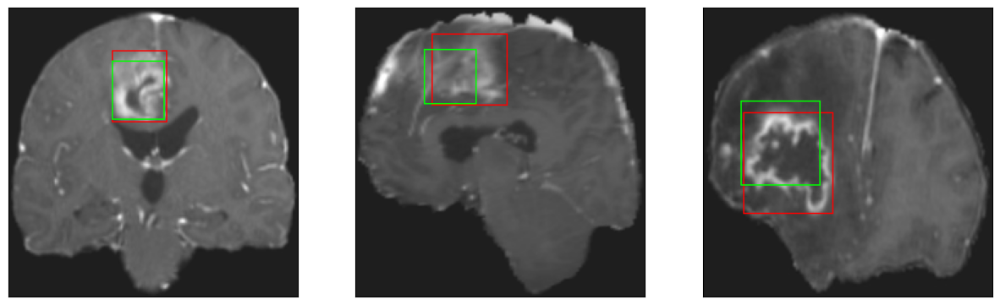

26/26 [==============================] - 3s 108ms/step - loss: 4.1790 - IoU: 0.6570 - val_loss: 9.1950 - val_IoU: 0.5132
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0427 - IoU: 0.6646
Epoch 198: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


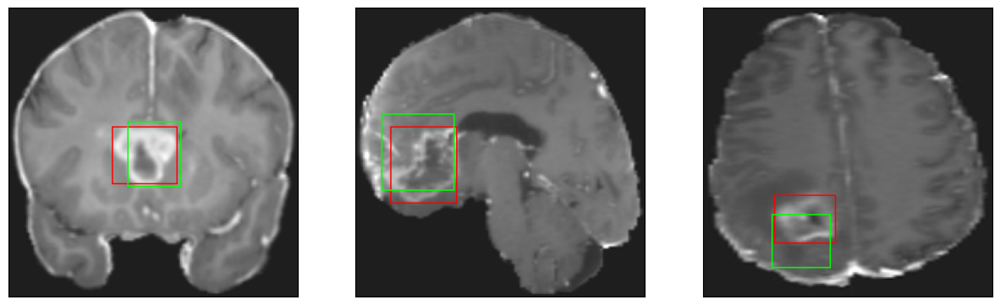

26/26 [==============================] - 3s 121ms/step - loss: 4.0585 - IoU: 0.6633 - val_loss: 8.3024 - val_IoU: 0.5683
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1124 - IoU: 0.6576
Epoch 199: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


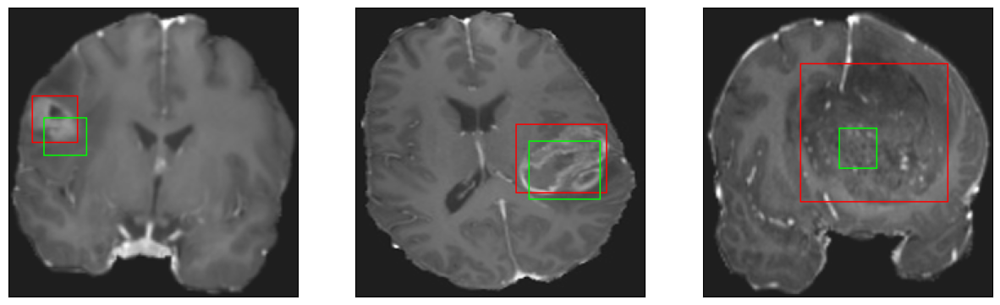

26/26 [==============================] - 3s 106ms/step - loss: 4.1447 - IoU: 0.6568 - val_loss: 8.4229 - val_IoU: 0.5538
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1771 - IoU: 0.6640
Epoch 200: val_IoU did not improve from 0.56889
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


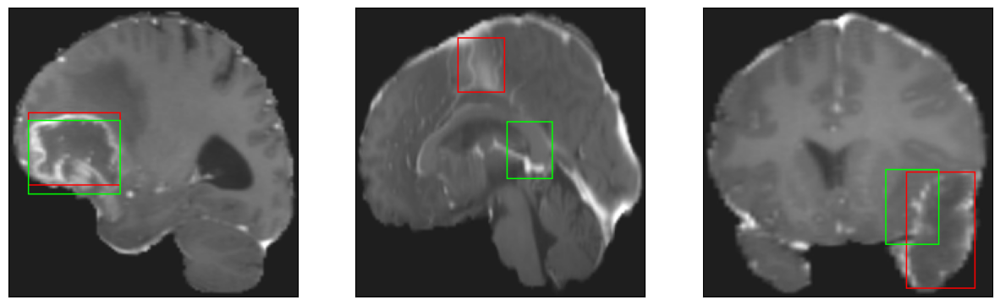

26/26 [==============================] - 3s 106ms/step - loss: 4.1604 - IoU: 0.6651 - val_loss: 9.7278 - val_IoU: 0.4834


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

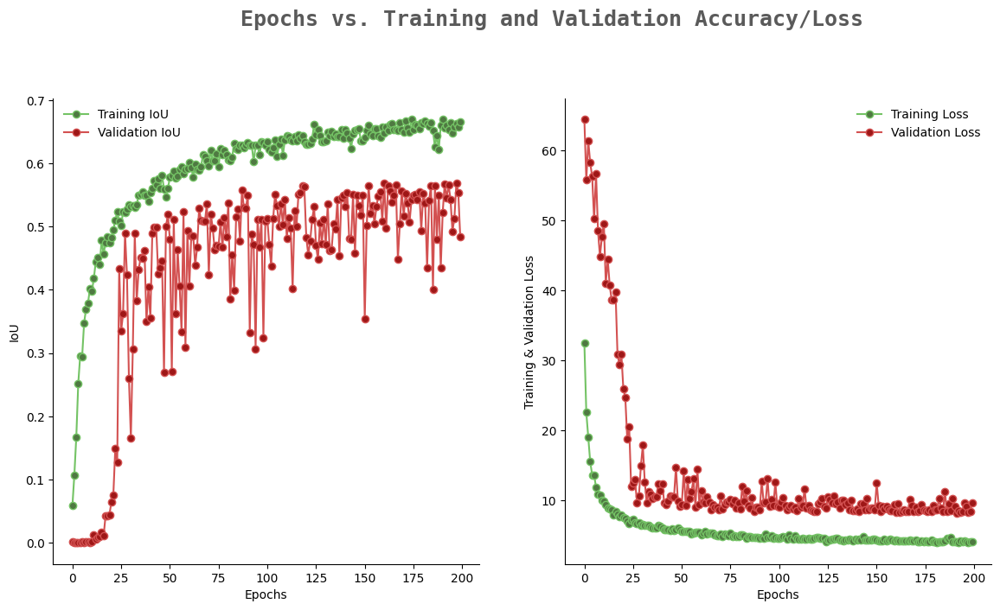

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 32ms/step - loss: 10.2985 - IoU: 0.4565


[10.298516273498535, 0.45645010471343994]